In [1]:
import Pkg
Pkg.activate(@__DIR__)
Pkg.instantiate()

  Activating project at `~/Desktop/git_projects/Causal sets/CausalSetZoology/analysis`


In [37]:
using JLD2
using CairoMakie
using LaTeXStrings
using Colors
using Printf
using Statistics
using Observables
using ColorSchemes
using Optim
using Random
using SpecialFunctions
using HypergeometricFunctions
using Polylogarithms
using ADTypes
import ForwardDiff
import QuantumGrav as QG
import CausalSets as CS
using FFTW
using Revise
using AlgebraOfGraphics
using DataFrames
using StatsBase
import CategoricalArrays
includet("./utils.jl")

[ Info: Precompiling CategoricalArrays [324d7699-5711-5eae-9e2f-1d82baa6b597] (cache misses: wrong dep version loaded (2))

SYSTEM: caught exception of type :MethodError while trying to print a failed Task notice; giving up
[ Info: Precompiling CategoricalArraysStatsBaseExt [6ea6418d-17b6-552e-babd-e36c59c6f5a6] (cache misses: wrong dep version loaded (2))

SYSTEM: caught exception of type :MethodError while trying to print a failed Task notice; giving up
[ Info: Precompiling CategoricalArraysSentinelArraysExt [25d60f2f-6134-5c9e-b13a-96ac465bddcb] (cache misses: wrong dep version loaded (2))

SYSTEM: caught exception of type :MethodError while trying to print a failed Task notice; giving up
[ Info: Precompiling CategoricalArraysJSONExt [3659b7b4-73bc-5a91-ba4f-cc4948098fdb] (cache misses: wrong dep version loaded (2))

SYSTEM: caught exception of type :MethodError while trying to print a failed Task notice; giving up


In [3]:
function fig_path(fig_name::String)
        path = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ?
        "/Users/fabianwagner/Dropbox/Fabian/Research/Papers and reports/CausalSetZoology/figs/" : 
        "/Users/fabian/Dropbox/Fabian/Research/Papers and reports/CausalSetZoology/plots/"
        return "$(path)$(fig_name)"
end

fig_path (generic function with 1 method)

# Functions work check

In [72]:
data_paths = gethostname() == "MacBook-Air-4.local" ? ["/Users/fabianwagner/Desktop/Local Calculations/git_projects/QuantumGrav-usage/data/manifoldlike_simply_connected_256_10000/statistics.jld2"] : ["/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2"]

2-element Vector{String}:
 "/Volumes/Causal Set Silo/causal" ⋯ 40 bytes ⋯ "cted_256_10000/statistics.jld2"
 "/Volumes/Causal Set Silo/causal" ⋯ 40 bytes ⋯ "cted_256_10000/statistics.jld2"

In [ ]:
hists=load_histograms_from_paths(data_paths, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2


2-element Vector{Vector{Dict}}:
 [Dict(5 => 617, 56 => 81, 35 => 156, 55 => 76, 110 => 6, 114 => 6, 123 => 1, 60 => 77, 30 => 170, 32 => 170…), Dict(5 => 595, 56 => 66, 35 => 144, 55 => 64, 110 => 1, 114 => 3, 60 => 58, 30 => 180, 32 => 181, 6 => 535…), Dict(5 => 585, 56 => 93, 35 => 171, 55 => 123, 110 => 13, 114 => 5, 123 => 2, 60 => 97, 30 => 201, 32 => 203…), Dict(5 => 571, 56 => 100, 35 => 167, 55 => 112, 110 => 12, 114 => 6, 123 => 2, 60 => 85, 30 => 208, 32 => 190…), Dict(5 => 531, 56 => 36, 35 => 85, 55 => 35, 79 => 2, 16 => 235, 20 => 174, 60 => 21, 81 => 1, 30 => 123…), Dict(5 => 617, 56 => 106, 35 => 163, 55 => 97, 110 => 5, 114 => 10, 123 => 4, 60 => 85, 30 => 214, 32 => 199…), Dict(5 => 657, 56 => 68, 35 => 126, 55 => 79, 110 => 6, 114 => 7, 123 => 3, 60 => 59, 30 => 174, 32 => 183…), Dict(5 => 554, 56 => 48, 35 => 85, 55 => 43, 110 => 2, 60 => 30, 30 => 153, 32 => 106, 6 => 517, 67 => 37…), Dict(5 => 584, 56 => 88, 35 => 141, 55 => 82, 110 => 20, 114 => 15, 123 => 7, 60 =

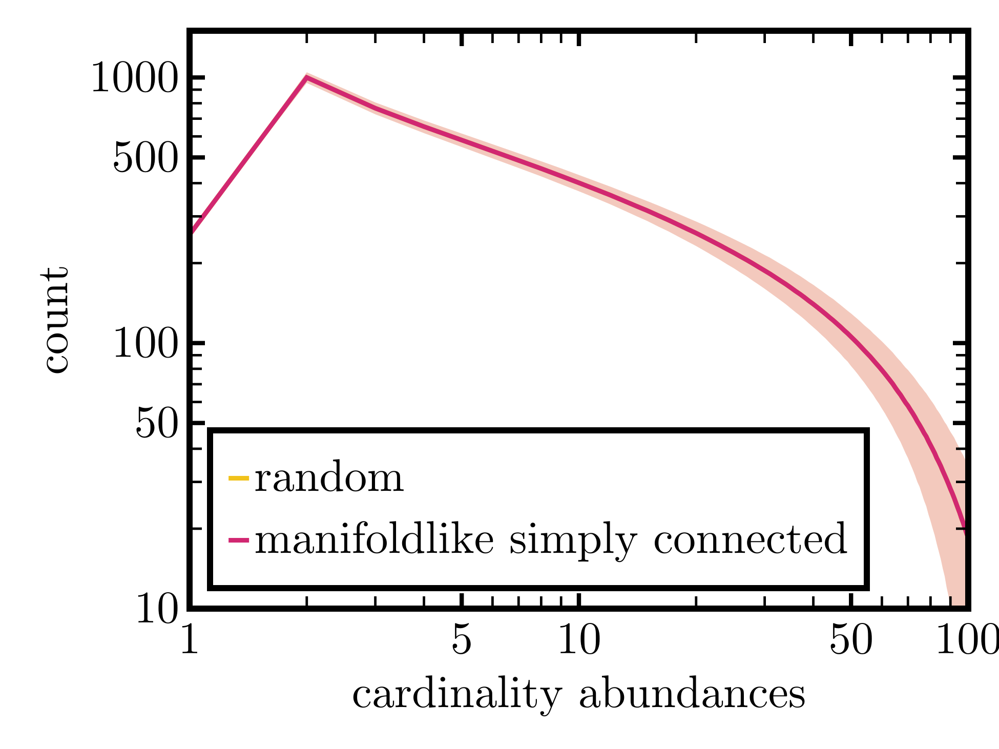

In [ ]:


average_std_plot_data = [average_histogram_with_std(hists[i]) for i in 1:length(hists)]
plot_mean_histograms_with_std(
    average_std_plot_data; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 100.), 
    ylim = (1.e1, 1500.), 
    xlabel = "cardinality abundances", 
    hist_labels = gethostname() == "MacBook-Air-4.local" ? ["random"] : ["random", "manifoldlike simply connected"], 
    magnification = 3,
    legendpos = :lb,
    legendmargin = (20,20,20,20)
    )

starting cumsums
first done
ending cumsums


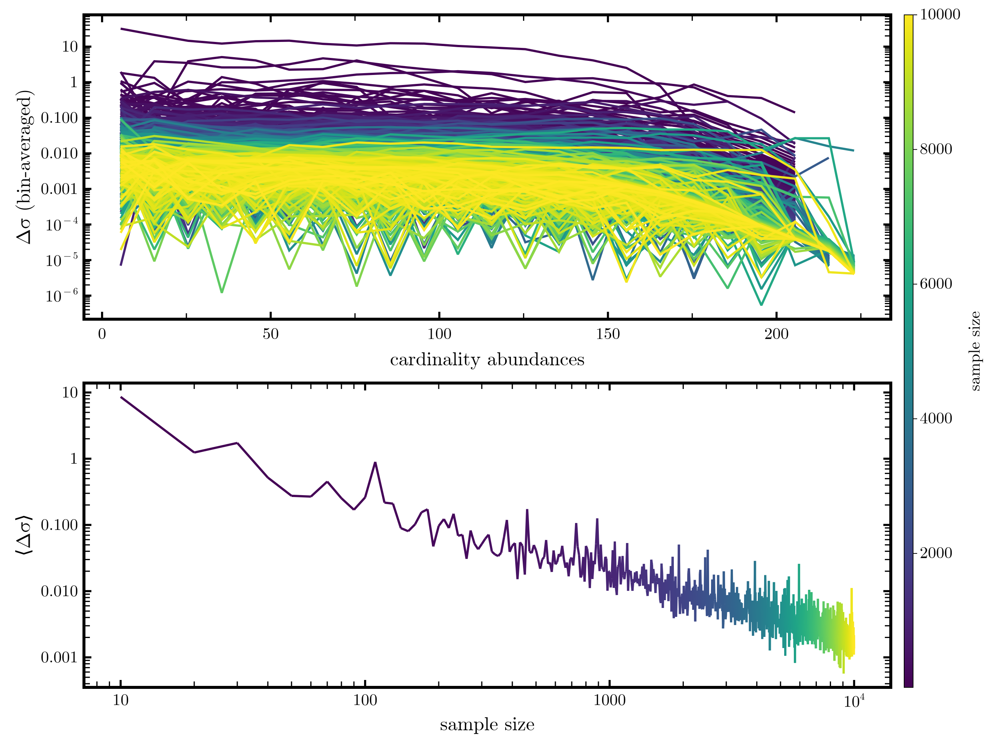

CairoMakie.Screen{IMAGE}


In [ ]:



display(convergence_plots_std_change(
    hists[1];
    double_column = true,
    bin_average = 10,
    batchsize = 10,
    magnification = 2,
    xlabel = "cardinality abundances"))

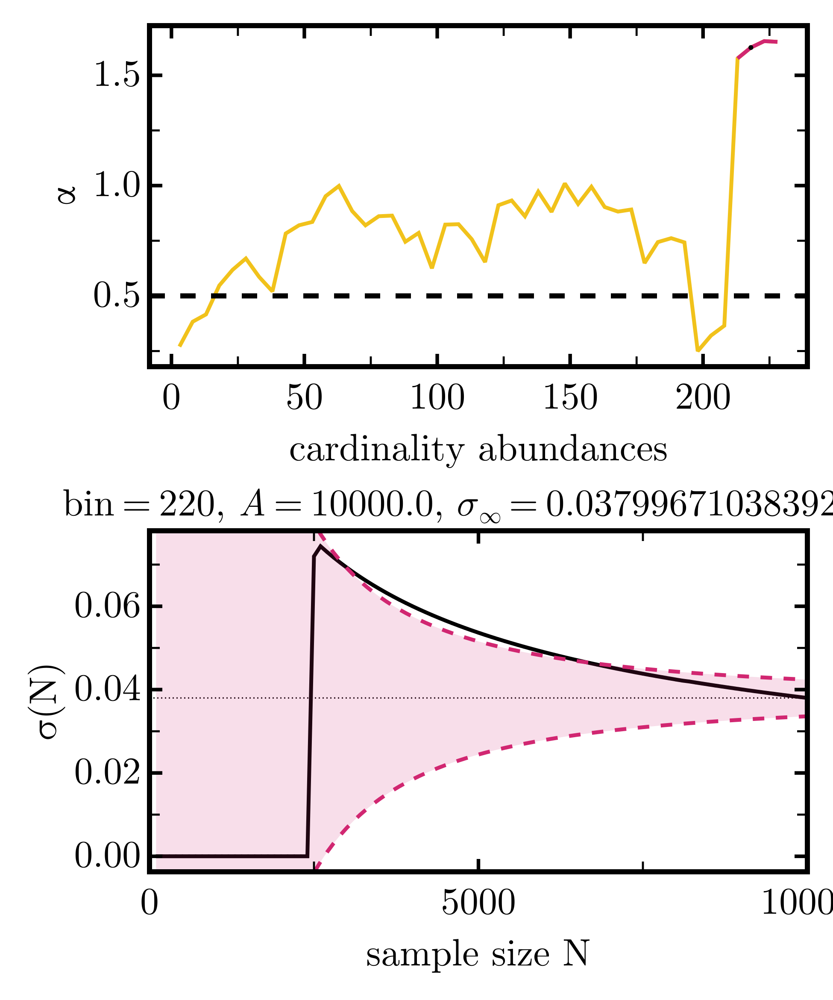

In [ ]:


dense_hists = densify_hists(hists[1])

plot_alpha_bins(dense_hists; 
batchsize = 100,
bin_average = 5,
xlabel = "cardinality abundances",
bin_plot = 220,
N0 = 1,
magnification = 3,
flag_zero_frac = .05)


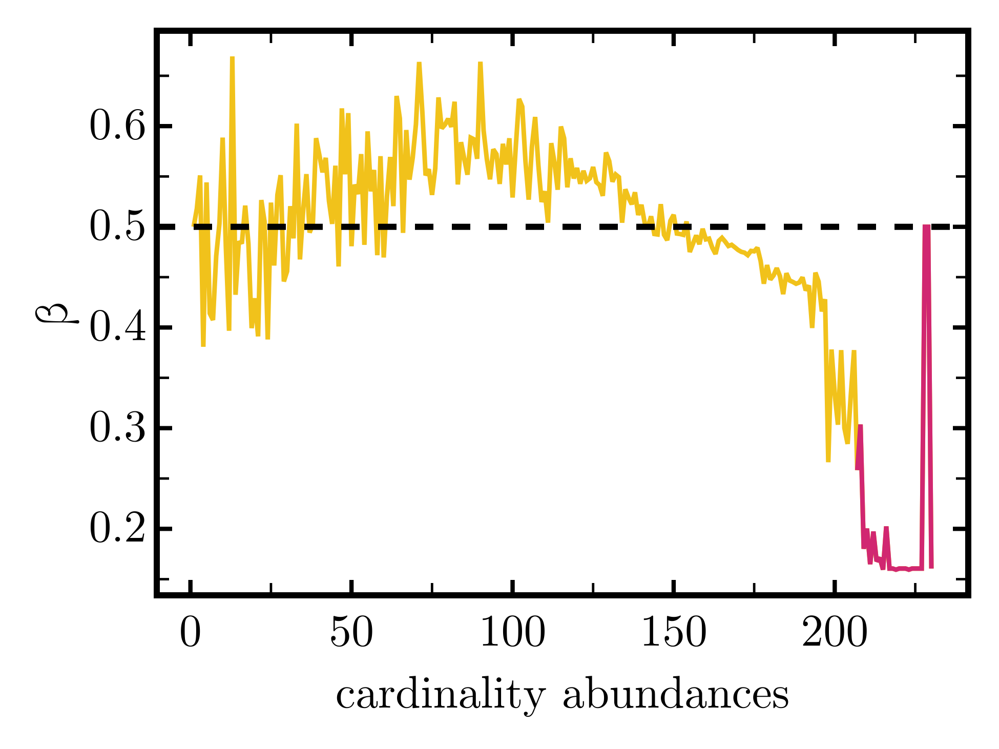

In [ ]:


plot_beta_bins(dense_hists; 
batchsize = 1,
bin_average = 1,
xlabel = "cardinality abundances",
#bin_plot = 190,
N0 = 1,
magnification = 3,
flag_zero_frac = .05)

# Random

## Sizes

In [ ]:
data_paths_random = ["/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/random_512_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/random_1024_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/random_2048_10000/statistics.jld2"]
abundance_hists_random=load_histograms_from_paths(data_paths_random, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/random_512_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_1024_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/random_2048_10000/statistics.jld2


4-element Vector{Vector{Dict}}:
 [Dict(5 => 617, 56 => 81, 35 => 156, 55 => 76, 110 => 6, 114 => 6, 123 => 1, 60 => 77, 30 => 170, 32 => 170…), Dict(5 => 595, 56 => 66, 35 => 144, 55 => 64, 110 => 1, 114 => 3, 60 => 58, 30 => 180, 32 => 181, 6 => 535…), Dict(5 => 585, 56 => 93, 35 => 171, 55 => 123, 110 => 13, 114 => 5, 123 => 2, 60 => 97, 30 => 201, 32 => 203…), Dict(5 => 571, 56 => 100, 35 => 167, 55 => 112, 110 => 12, 114 => 6, 123 => 2, 60 => 85, 30 => 208, 32 => 190…), Dict(5 => 531, 56 => 36, 35 => 85, 55 => 35, 79 => 2, 16 => 235, 20 => 174, 60 => 21, 81 => 1, 30 => 123…), Dict(5 => 617, 56 => 106, 35 => 163, 55 => 97, 110 => 5, 114 => 10, 123 => 4, 60 => 85, 30 => 214, 32 => 199…), Dict(5 => 657, 56 => 68, 35 => 126, 55 => 79, 110 => 6, 114 => 7, 123 => 3, 60 => 59, 30 => 174, 32 => 183…), Dict(5 => 554, 56 => 48, 35 => 85, 55 => 43, 110 => 2, 60 => 30, 30 => 153, 32 => 106, 6 => 517, 67 => 37…), Dict(5 => 584, 56 => 88, 35 => 141, 55 => 82, 110 => 20, 114 => 15, 123 => 7, 60 =

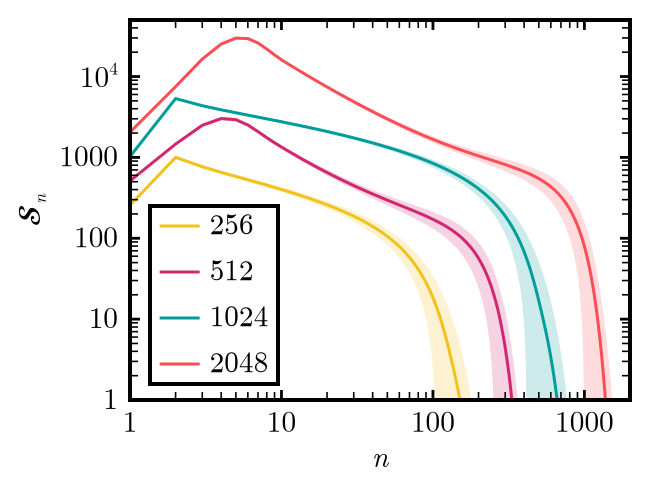

CairoMakie.Screen{IMAGE}


In [ ]:


average_std_plot_data_random = [average_histogram_with_std(abundance_hists_random[i]) for i in 1:length(abundance_hists_random)]
abundances_random_size_comp_plot = plot_mean_histograms_with_std(
    average_std_plot_data_random; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 2000.), 
    ylim = (1.e0, 50000.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = ["256", "512", "1024", "2048"], 
    magnification = 1,
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0)
    )

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_random_size_comp_plot.pdf", 
    abundances_random_size_comp_plot)

display(abundances_random_size_comp_plot)

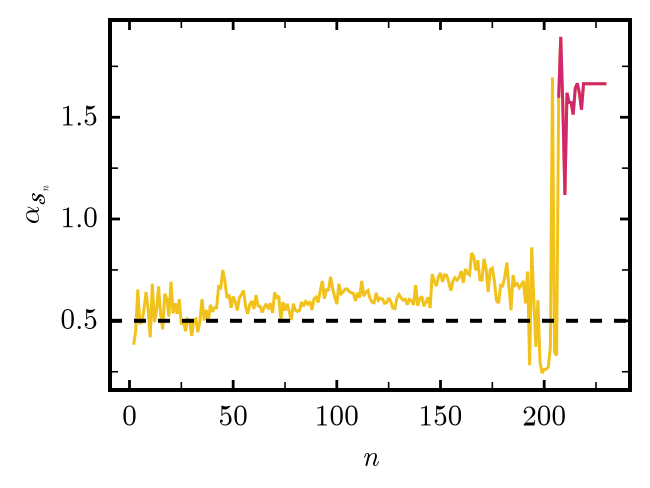

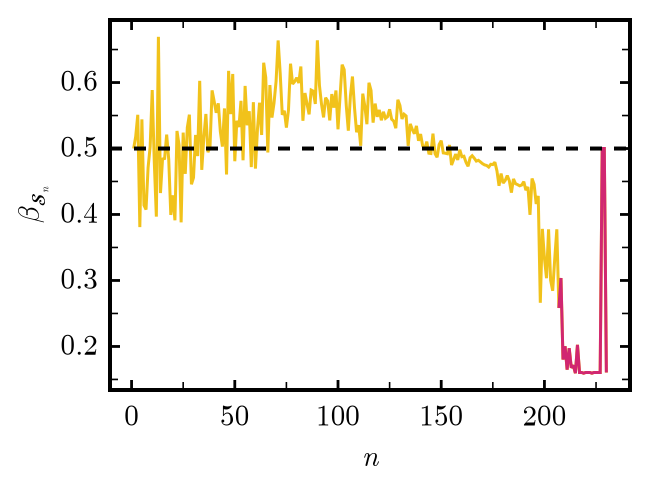

In [ ]:


dense_hists = densify_hists(abundance_hists_random[1])

abundances_random_std_exp = plot_alpha_bins(dense_hists; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
#bin_plot = 150,
N0 = 1,
magnification = 1)

abundances_random_mean_exp = plot_beta_bins(dense_hists; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
#bin_plot = 190,
N0 = 1,
magnification = 1)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_random_mean_exp.pdf", 
    abundances_random_mean_exp)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_random_std_exp.pdf", 
    abundances_random_std_exp)

foreach(display, 
    [abundances_random_std_exp, 
    abundances_random_mean_exp])

## Graph observables

In [13]:
data_paths_random = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ? 
["/Users/fabianwagner/Desktop/git_projects/Causal sets/data/random_256_10000/statistics.jld2", 
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2"] :
["/Volumes/Causal Set Silo/causal_sets/analysis/random_256_10000/statistics.jl",
"/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2"]
in_degree_hists_random         = load_histograms_from_paths(data_paths_random, :in_degree_hist)
out_degree_hists_random        = load_histograms_from_paths(data_paths_random, :out_degree_hist)
ev_in_hists_random             = load_histograms_from_paths(data_paths_random, :ev_in_hist)
ev_out_hists_random            = load_histograms_from_paths(data_paths_random, :ev_out_hist)
connectivity_hists_random      = join_histograms([in_degree_hists_random,out_degree_hists_random])
in_degree_link_hists_random    = load_histograms_from_paths(data_paths_random, :in_degree_hist_link)
out_degree_link_hists_random   = load_histograms_from_paths(data_paths_random, :out_degree_hist_link)
ev_in_link_hists_random        = load_histograms_from_paths(data_paths_random, :ev_in_hist_link)
ev_out_link_hists_random       = load_histograms_from_paths(data_paths_random, :ev_out_hist_link)
connectivity_link_hists_random = join_histograms([in_degree_link_hists_random,out_degree_link_hists_random])
max_pathlen_hists_random      = load_histograms_from_paths(data_paths_random, :max_pathlen_hist)

  Julia 1.12 has introduced more strict world age semantics for global bindings.
  !!! This code may malfunction under Revise.
  !!! This code will error in future versions of Julia.
Hint: Add an appropriate `invokelatest` around the access to this binding.
To make this warning an error, and hence obtain a stack trace, use `julia --depwarn=error`.


  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/random_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/random_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/random_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/random_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causa

2-element Vector{Vector{Dict}}:
 [Dict(32.0 => 4, 29.0 => 1, 21.0 => 2, 25.0 => 1, 33.0 => 8, 26.0 => 1, 31.0 => 5, 24.0 => 1, 30.0 => 3), Dict(16.0 => 1, 29.0 => 6, 24.0 => 2, 28.0 => 4, 30.0 => 7, 17.0 => 1, 23.0 => 5, 0.0 => 1, 22.0 => 3, 4.0 => 1…), Dict(29.0 => 1, 20.0 => 1, 24.0 => 2, 28.0 => 3, 30.0 => 2, 23.0 => 2, 19.0 => 1, 0.0 => 1, 22.0 => 1, 32.0 => 1…), Dict(16.0 => 1, 20.0 => 1, 29.0 => 1, 25.0 => 6, 24.0 => 5, 28.0 => 2, 30.0 => 1, 17.0 => 2, 23.0 => 2, 19.0 => 1…), Dict(29.0 => 8, 20.0 => 1, 24.0 => 2, 28.0 => 7, 30.0 => 7, 23.0 => 1, 22.0 => 2, 21.0 => 1, 27.0 => 4, 31.0 => 2…), Dict(29.0 => 3, 20.0 => 1, 33.0 => 2, 25.0 => 1, 30.0 => 6, 28.0 => 5, 23.0 => 1, 32.0 => 2, 10.0 => 1, 27.0 => 7…), Dict(20.0 => 2, 25.0 => 13, 24.0 => 6, 28.0 => 1, 17.0 => 1, 23.0 => 7, 19.0 => 3, 22.0 => 5, 10.0 => 1, 27.0 => 1…), Dict(16.0 => 2, 20.0 => 2, 25.0 => 4, 12.0 => 1, 24.0 => 7, 17.0 => 1, 23.0 => 7, 19.0 => 1, 22.0 => 13, 15.0 => 1…), Dict(29.0 => 3, 20.0 => 1, 33.0 => 1, 12.0 

In [14]:
cset_size_random = 256
normalized_in_degree_hists_random         = normalize_hists(in_degree_hists_random)
normalized_out_degree_hists_random        = normalize_hists(out_degree_hists_random)
normalized_ev_in_hists_random             = normalize_hists(ev_in_hists_random; normalization = cset_size_random)
normalized_ev_out_hists_random            = normalize_hists(ev_out_hists_random; normalization = cset_size_random)
normalized_connectivity_hists_random      = normalize_hists(connectivity_hists_random)
normalized_in_degree_link_hists_random    = normalize_hists(in_degree_link_hists_random)
normalized_out_degree_link_hists_random   = normalize_hists(out_degree_link_hists_random)
normalized_ev_in_link_hists_random        = normalize_hists(ev_in_link_hists_random; normalization = cset_size_random)
normalized_ev_out_link_hists_random       = normalize_hists(ev_out_link_hists_random; normalization = cset_size_random)
normalized_connectivity_link_hists_random = normalize_hists(connectivity_link_hists_random)
normalized_max_pathlen_hists_random       = normalize_hists(max_pathlen_hists_random; normalization = 1)

2-element Vector{Vector{Dict{Int64, Float64}}}:
 [Dict(32 => 4.0, 29 => 1.0, 21 => 2.0, 25 => 1.0, 33 => 8.0, 26 => 1.0, 31 => 5.0, 24 => 1.0, 30 => 3.0), Dict(16 => 1.0, 24 => 2.0, 28 => 4.0, 30 => 7.0, 17 => 1.0, 23 => 5.0, 0 => 1.0, 22 => 3.0, 11 => 1.0, 31 => 5.0…), Dict(20 => 1.0, 24 => 2.0, 28 => 3.0, 30 => 2.0, 23 => 2.0, 19 => 1.0, 0 => 1.0, 22 => 1.0, 32 => 1.0, 31 => 6.0…), Dict(16 => 1.0, 20 => 1.0, 24 => 5.0, 28 => 2.0, 30 => 1.0, 17 => 2.0, 23 => 2.0, 19 => 1.0, 22 => 1.0, 9 => 1.0…), Dict(20 => 1.0, 24 => 2.0, 28 => 7.0, 30 => 7.0, 23 => 1.0, 22 => 2.0, 31 => 2.0, 29 => 8.0, 21 => 1.0, 27 => 4.0…), Dict(20 => 1.0, 30 => 6.0, 28 => 5.0, 23 => 1.0, 32 => 2.0, 31 => 4.0, 29 => 3.0, 33 => 2.0, 25 => 1.0, 10 => 1.0…), Dict(20 => 2.0, 24 => 6.0, 28 => 1.0, 17 => 1.0, 23 => 7.0, 19 => 3.0, 22 => 5.0, 25 => 13.0, 10 => 1.0, 27 => 1.0…), Dict(16 => 2.0, 20 => 2.0, 12 => 1.0, 24 => 7.0, 17 => 1.0, 23 => 7.0, 19 => 1.0, 22 => 13.0, 25 => 4.0, 15 => 1.0…), Dict(20 => 1.0, 12 => 1.0, 

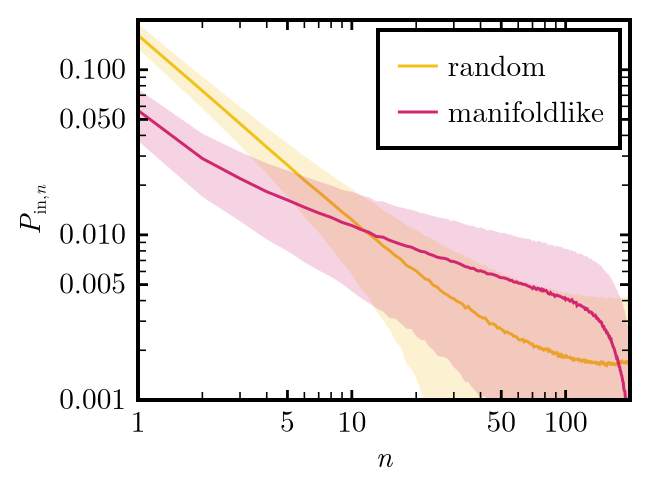

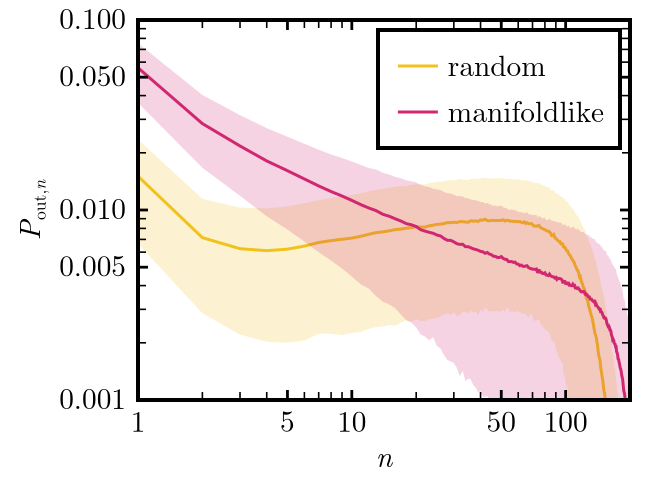

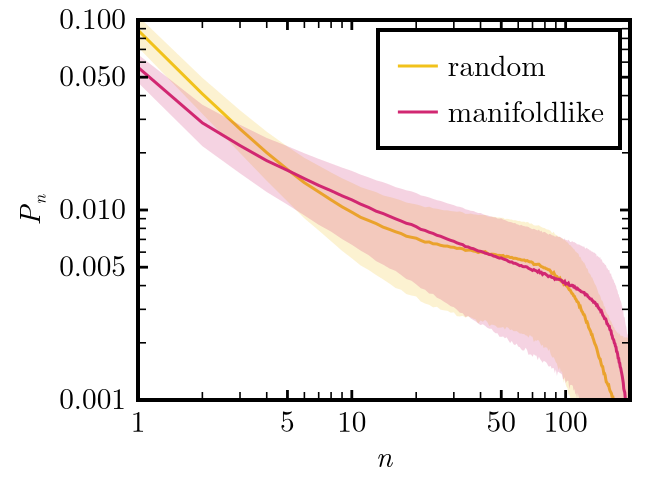

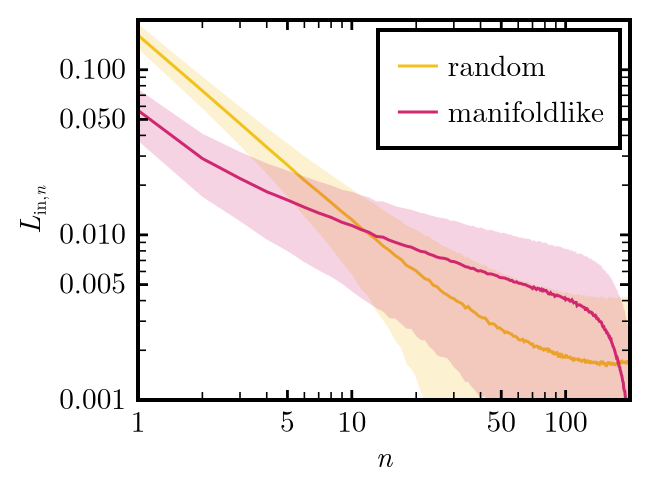

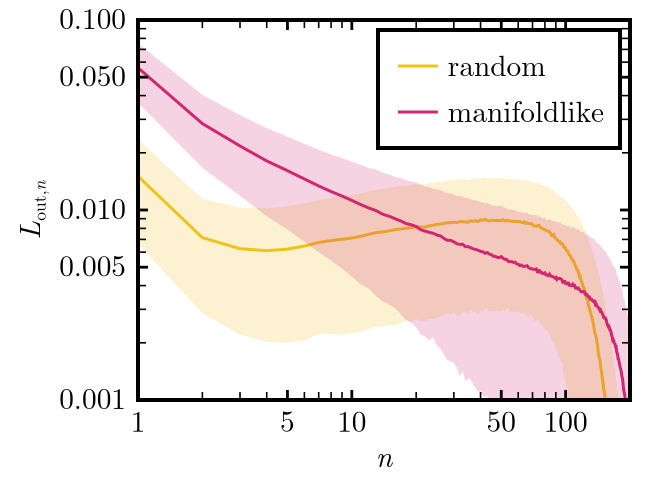

...

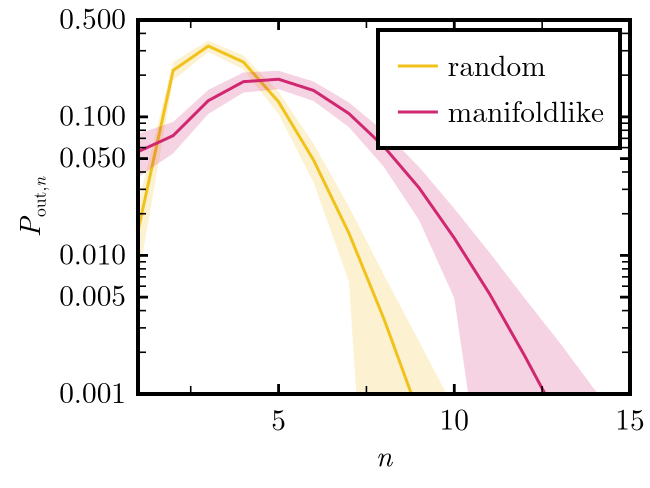

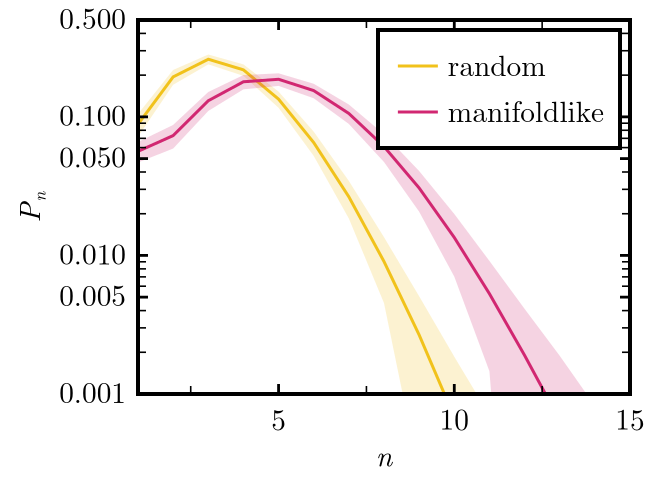

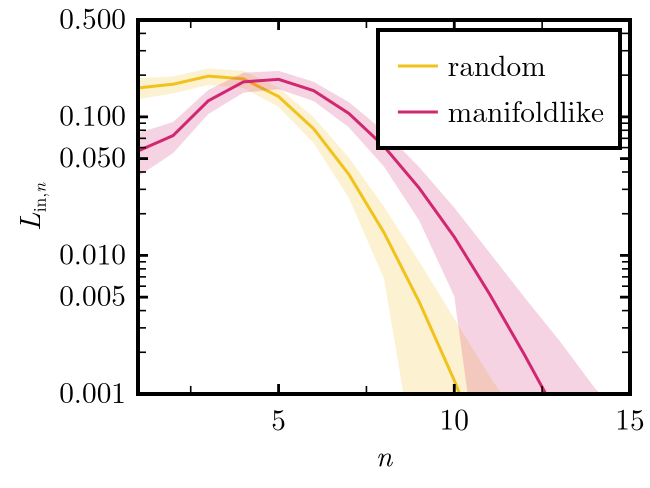

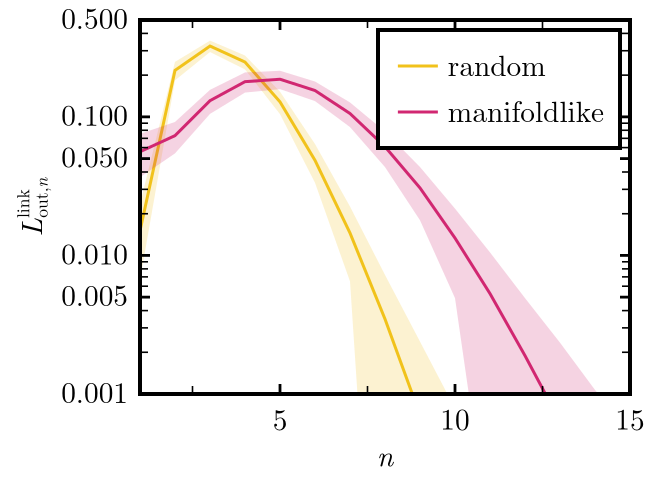

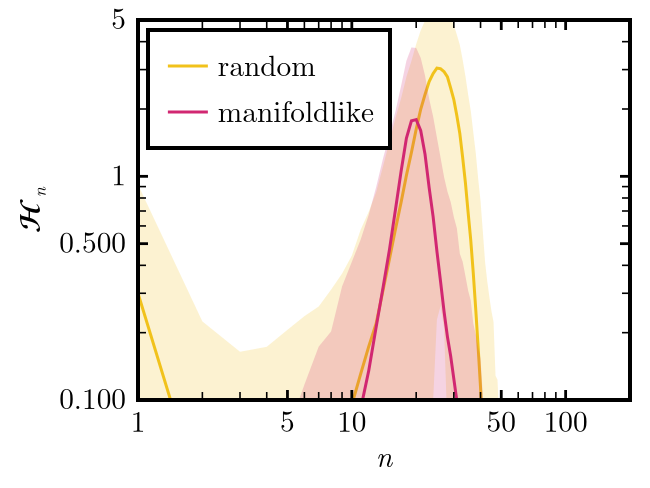

In [15]:
foreach(
    display,
    [
    plot_and_save_hists(
        normalized_in_degree_hists_random,
        "random_man/in_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["random", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_out_degree_hists_random,
        "random_man/out_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["random", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_connectivity_hists_random,
        "random_man/connectivity.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["random", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_ev_in_hists_random,
        "random_man/ev_in.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["random", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_ev_out_hists_random,
        "random_man/ev_out.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{out}, n}",
        hist_labels = ["random", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_in_degree_link_hists_random,
        "random_man/in_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["random", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_out_degree_link_hists_random,
        "random_man/out_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["random", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_connectivity_link_hists_random,
        "random_man/connectivity_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["random", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_in_link_hists_random,
        "random_man/ev_in_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["random", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_out_link_hists_random,
        "random_man/ev_out_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L^{\mathrm{link}}_{\mathrm{out},n}",
        hist_labels = ["random", "manifoldlike"], 
        logscale_x = false,
    ),


    plot_and_save_hists(
        normalized_max_pathlen_hists_random,
        "random_man/max_pathlen.pdf";
        xlim = (1., 200.), 
        ylim = (.1, 5.), 
        xlabel = L"n", 
        ylabel = L"\mathcal{H}_{n}",
        hist_labels = ["random", "manifoldlike"], 
        legendpos = :lt
    ),

    ]
)

# Manifoldlike simply connected

## Sizes

In [ ]:
data_paths_manifoldlike_simply_connected = ["/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_512_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_1024_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_2048_10000/statistics.jld2"]
abundance_hists_manifoldlike_simply_connected=load_histograms_from_paths(data_paths_manifoldlike_simply_connected, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_512_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_1024_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_2048_10000/statistics.jld2


4-element Vector{Vector{Dict}}:
 [Dict(5 => 617, 56 => 81, 35 => 156, 55 => 76, 110 => 6, 114 => 6, 123 => 1, 60 => 77, 30 => 170, 32 => 170…), Dict(5 => 595, 56 => 66, 35 => 144, 55 => 64, 110 => 1, 114 => 3, 60 => 58, 30 => 180, 32 => 181, 6 => 535…), Dict(5 => 585, 56 => 93, 35 => 171, 55 => 123, 110 => 13, 114 => 5, 123 => 2, 60 => 97, 30 => 201, 32 => 203…), Dict(5 => 571, 56 => 100, 35 => 167, 55 => 112, 110 => 12, 114 => 6, 123 => 2, 60 => 85, 30 => 208, 32 => 190…), Dict(5 => 531, 56 => 36, 35 => 85, 55 => 35, 79 => 2, 16 => 235, 20 => 174, 60 => 21, 81 => 1, 30 => 123…), Dict(5 => 617, 56 => 106, 35 => 163, 55 => 97, 110 => 5, 114 => 10, 123 => 4, 60 => 85, 30 => 214, 32 => 199…), Dict(5 => 657, 56 => 68, 35 => 126, 55 => 79, 110 => 6, 114 => 7, 123 => 3, 60 => 59, 30 => 174, 32 => 183…), Dict(5 => 554, 56 => 48, 35 => 85, 55 => 43, 110 => 2, 60 => 30, 30 => 153, 32 => 106, 6 => 517, 67 => 37…), Dict(5 => 584, 56 => 88, 35 => 141, 55 => 82, 110 => 20, 114 => 15, 123 => 7, 60 =

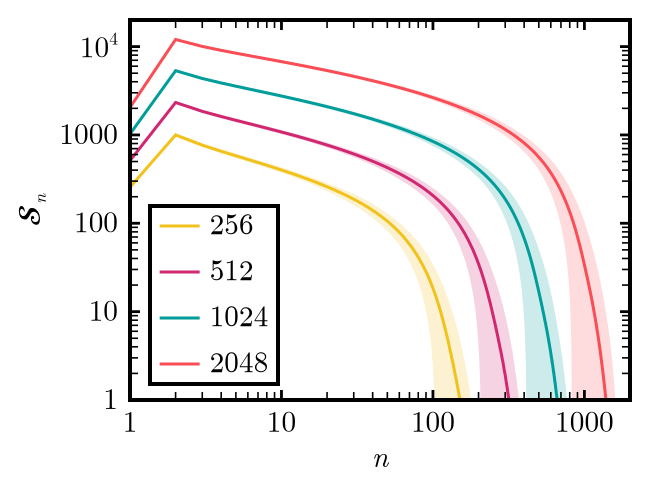

CairoMakie.Screen{IMAGE}


In [ ]:


average_std_plot_data_manifoldlike_simply_connected = [average_histogram_with_std(abundance_hists_manifoldlike_simply_connected[i]) for i in 1:length(abundance_hists_manifoldlike_simply_connected)]
abundances_manifoldlike_simply_connected_size_comp_plot = plot_mean_histograms_with_std(
    average_std_plot_data_manifoldlike_simply_connected; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 2000.), 
    ylim = (1.e0, 20000.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = ["256", "512", "1024", "2048"], 
    magnification = 1,
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0)
    )

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_simply_connected_size_comp_plot.pdf", 
    abundances_manifoldlike_simply_connected_size_comp_plot)

display(abundances_manifoldlike_simply_connected_size_comp_plot)

### Convergence plots

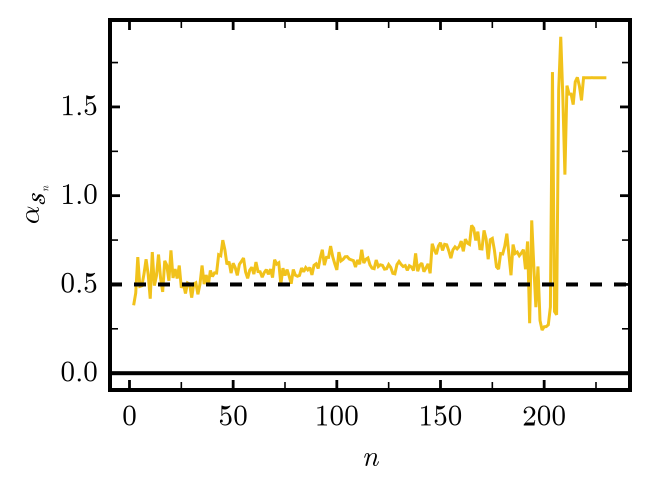

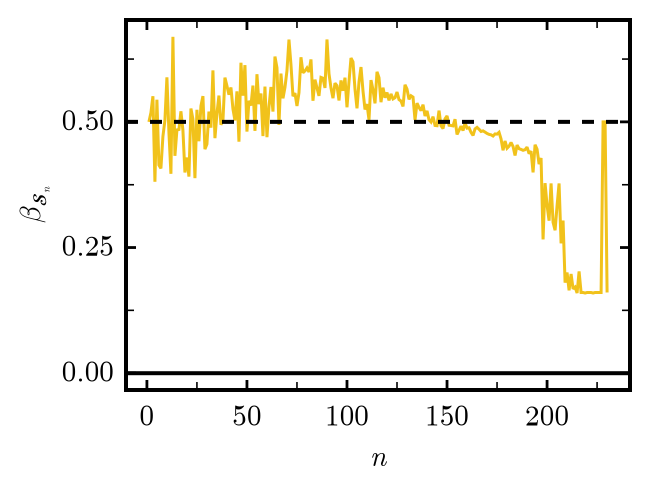

In [ ]:


dense_hists_manifoldlike_simply_connected = densify_hists(abundance_hists_manifoldlike_simply_connected[1])

abundances_manifoldlike_simply_connected_std_exp = plot_alpha_bins(dense_hists_manifoldlike_simply_connected; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
#bin_plot = 150,
N0 = 1,
magnification = 1)

abundances_manifoldlike_simply_connected_mean_exp = plot_beta_bins(dense_hists_manifoldlike_simply_connected; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
#bin_plot = 190,
N0 = 1,
magnification = 1)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_simply_connected_mean_exp.pdf", 
    abundances_manifoldlike_simply_connected_mean_exp)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_simply_connected_std_exp.pdf", 
    abundances_manifoldlike_simply_connected_std_exp)

foreach(display, 
    [abundances_manifoldlike_simply_connected_std_exp, 
    abundances_manifoldlike_simply_connected_mean_exp])

## Dimension check

In [ ]:

data_paths_manifoldlike_simply_connected_dim = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ?
    ["/Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_2048_10000/statistics.jld2", 
    "/Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_3D_2048_500/statistics.jld2"] :
    ["/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_2048_10000/statistics.jld2", 
    "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_3D_2048_500/statistics.jld2"] 
abundance_hists_manifoldlike_simply_connected_dim=load_histograms_from_paths(data_paths_manifoldlike_simply_connected_dim, :cardinalities_hist)

  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_2048_10000/statistics.jld2
  Loaded 500 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_3D_2048_500/statistics.jld2


2-element Vector{Vector{Dict}}:
 [Dict(719 => 144, 858 => 15, 699 => 155, 831 => 26, 673 => 178, 319 => 1073, 73 => 3246, 251 => 1446, 687 => 181, 115 => 2469…), Dict(719 => 177, 858 => 72, 1010 => 2, 1028 => 4, 699 => 179, 831 => 77, 983 => 21, 673 => 246, 319 => 1097, 73 => 3211…), Dict(719 => 205, 858 => 91, 1010 => 12, 1028 => 7, 699 => 254, 831 => 99, 983 => 17, 673 => 247, 319 => 1200, 73 => 3252…), Dict(719 => 172, 858 => 29, 1010 => 1, 699 => 205, 831 => 58, 983 => 3, 673 => 218, 319 => 1175, 73 => 3275, 251 => 1431…), Dict(719 => 117, 858 => 32, 1010 => 3, 699 => 133, 831 => 48, 983 => 3, 673 => 149, 319 => 769, 73 => 2857, 251 => 964…), Dict(719 => 131, 858 => 27, 699 => 148, 831 => 31, 673 => 195, 319 => 999, 73 => 3123, 251 => 1329, 687 => 155, 115 => 2566…), Dict(699 => 3, 673 => 5, 319 => 420, 73 => 2375, 251 => 623, 687 => 3, 115 => 1642, 112 => 1749, 185 => 1012, 420 => 258…), Dict(719 => 198, 858 => 44, 1010 => 6, 1028 => 1, 699 => 209, 831 => 79, 983 => 11, 673 => 236

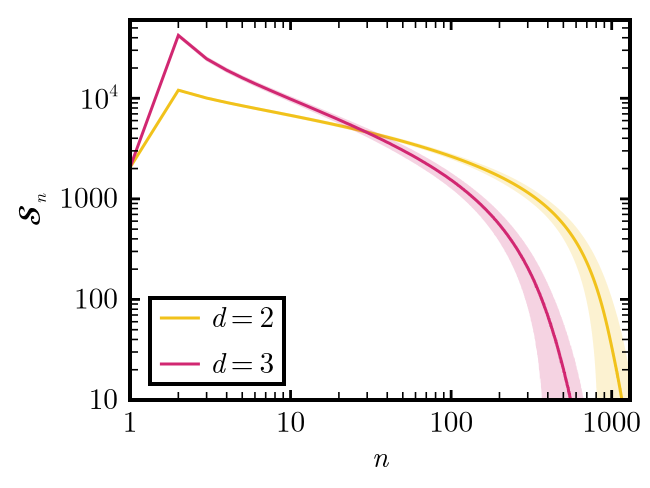

CairoMakie.Screen{IMAGE}


In [17]:


average_std_plot_data_manifoldlike_simply_connected_dim = [average_histogram_with_std(abundance_hists_manifoldlike_simply_connected_dim[i]) for i in 1:length(abundance_hists_manifoldlike_simply_connected_dim)]
abundances_manifoldlike_simply_connected_dim = plot_mean_histograms_with_std(
    average_std_plot_data_manifoldlike_simply_connected_dim; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 1300.), 
    ylim = (1.e1, 60000.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = [L"d=2", L"d=3"], 
    magnification = 1,
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0)
    )

save(fig_path("abundances_manifoldlike_simply_connected_dim_plot.pdf"), 
    abundances_manifoldlike_simply_connected_dim)

display(abundances_manifoldlike_simply_connected_dim)

### Add random

In [ ]:
data_paths_comp_random_man_add = ["/Volumes/Causal Set Silo/causal_sets/analysis/random_2048_10000/statistics.jld2"]
abundance_hists_comp_random_mink=load_histograms_from_paths(data_paths_comp_random_mink, :cardinalities_hist)

In [ ]:
average_std_plot_data_comp_random_mink = [average_histogram_with_std(abundance_hists_comp_random_mink[i]) for i in 1:length(abundance_hists_comp_random_mink)]
abundances_comp_random_mink = plot_mean_histograms_with_std(
    average_std_plot_data_comp_random_mink; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 140.), 
    ylim = (1.e1, 2500.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = [L"d=2", L"d=3", "random"], 
    magnification = 1,
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0)
    )

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_comp_random_mink.pdf", 
    abundances_comp_random_mink)

display(abundances_comp_random_mink)

### Convergence plots

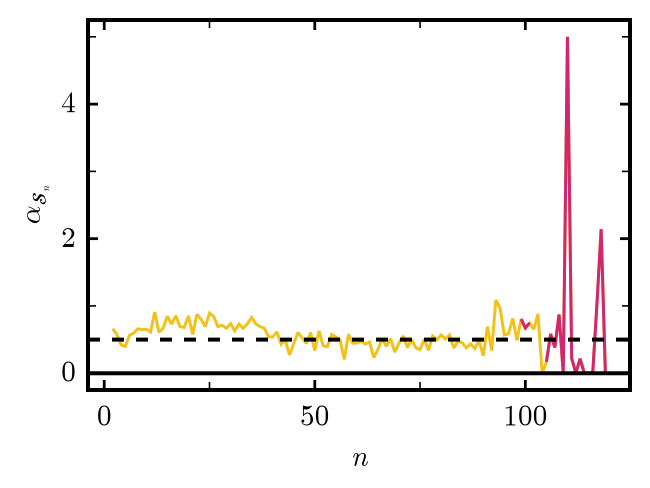

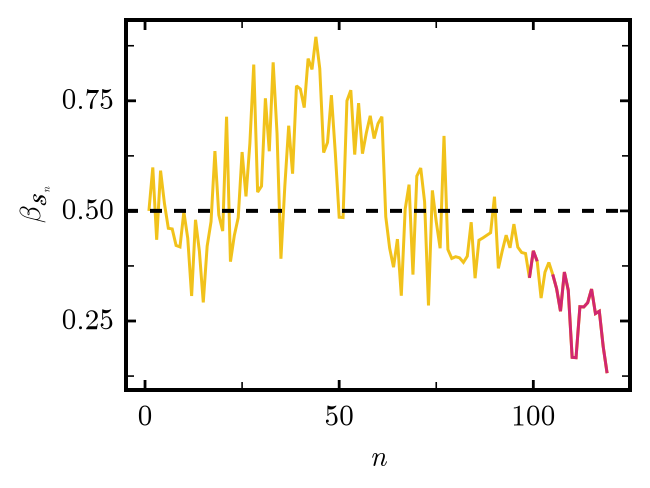

In [ ]:


dense_hists_manifoldlike_simply_connected_dim = densify_hists(abundance_hists_manifoldlike_simply_connected_dim[2])

abundances_manifoldlike_simply_connected_std_exp_dim = plot_alpha_bins(dense_hists_manifoldlike_simply_connected_dim; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
#bin_plot = 150,
N0 = 1,
magnification = 1)

abundances_manifoldlike_simply_connected_mean_exp_dim = plot_beta_bins(dense_hists_manifoldlike_simply_connected_dim; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
#bin_plot = 190,
N0 = 1,
magnification = 1)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_simply_connected_mean_exp.pdf", 
    abundances_manifoldlike_simply_connected_mean_exp_dim)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_simply_connected_std_exp.pdf", 
    abundances_manifoldlike_simply_connected_std_exp_dim)

foreach(display, 
    [abundances_manifoldlike_simply_connected_std_exp_dim, 
    abundances_manifoldlike_simply_connected_mean_exp_dim])

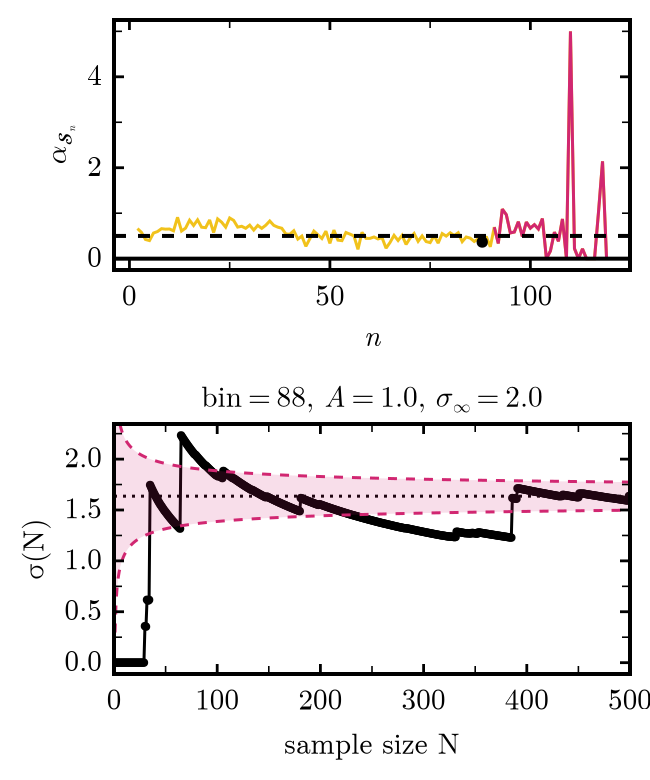

In [ ]:

abundances_manifoldlike_simply_connected_std_exp_dim_5 = plot_alpha_bins(dense_hists_manifoldlike_simply_connected_dim; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
bin_plot = 88,
N0 = 1,
magnification = 1,
flag_zero_frac = 0.03)

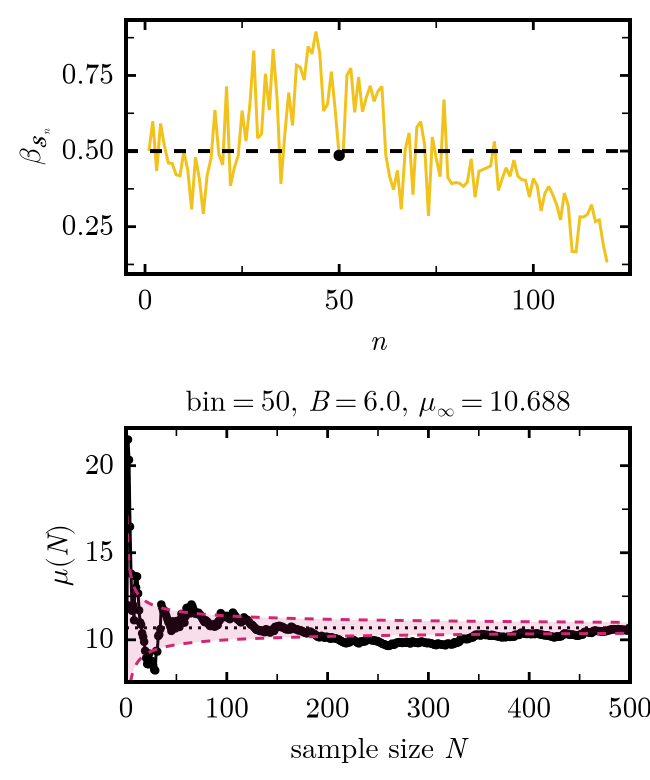

In [ ]:

abundances_manifoldlike_simply_connected_mean_exp_dim_5 = plot_beta_bins(dense_hists_manifoldlike_simply_connected_dim; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
bin_plot = 50,
N0 = 1,
magnification = 1,
β_init = .5,
flag_zero_frac = .8)

# Manifoldlike non-simply connected

In [ ]:
data_paths_manifoldlike_non_simply_connected = ["/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_512_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_1024_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_2048_10000/statistics.jld2"]
abundance_hists_manifoldlike_non_simply_connected=load_histograms_from_paths(data_paths_manifoldlike_non_simply_connected, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_256_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_512_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_1024_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_non_simply_connected_2048_10000/statistics.jld2


4-element Vector{Vector{Dict}}:
 [Dict(5 => 364, 56 => 6, 35 => 73, 55 => 4, 16 => 189, 20 => 150, 30 => 88, 19 => 160, 32 => 86, 49 => 4…), Dict(5 => 351, 56 => 7, 35 => 41, 55 => 7, 16 => 168, 20 => 128, 60 => 5, 30 => 50, 19 => 134, 32 => 49…), Dict(5 => 273, 35 => 26, 16 => 135, 20 => 102, 30 => 49, 19 => 121, 32 => 31, 6 => 254, 45 => 3, 44 => 2…), Dict(5 => 282, 56 => 8, 35 => 23, 55 => 11, 16 => 88, 20 => 73, 60 => 4, 30 => 31, 19 => 83, 32 => 23…), Dict(5 => 389, 56 => 12, 35 => 62, 55 => 16, 60 => 12, 30 => 67, 32 => 65, 6 => 346, 67 => 13, 45 => 31…), Dict(5 => 309, 56 => 11, 35 => 41, 55 => 13, 16 => 130, 20 => 99, 60 => 8, 30 => 54, 19 => 84, 32 => 65…), Dict(5 => 332, 56 => 14, 35 => 18, 55 => 16, 16 => 143, 20 => 151, 60 => 12, 30 => 52, 19 => 148, 32 => 39…), Dict(5 => 414, 56 => 33, 35 => 64, 55 => 27, 60 => 27, 30 => 105, 32 => 95, 6 => 351, 67 => 24, 45 => 41…), Dict(5 => 263, 56 => 2, 35 => 32, 55 => 10, 16 => 131, 20 => 86, 60 => 5, 30 => 54, 19 => 90, 32 => 34…), D

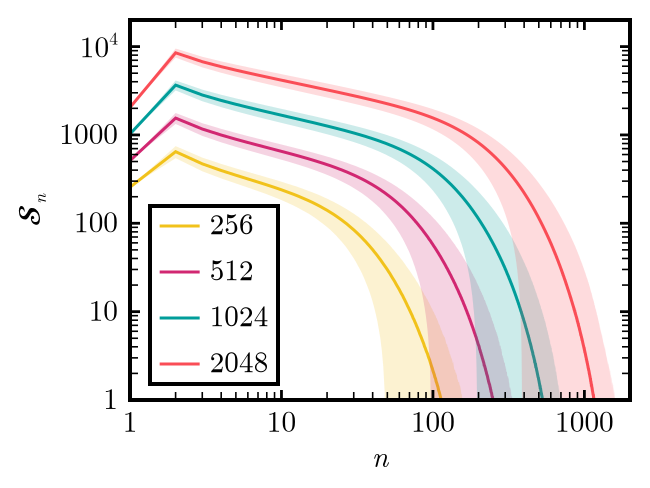

CairoMakie.Screen{IMAGE}


In [ ]:


average_std_plot_data_manifoldlike_non_simply_connected = [average_histogram_with_std(abundance_hists_manifoldlike_non_simply_connected[i]) for i in 1:length(abundance_hists_manifoldlike_non_simply_connected)]
abundances_manifoldlike_non_simply_connected_size_comp_plot = plot_mean_histograms_with_std(
    average_std_plot_data_manifoldlike_non_simply_connected; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 2000.), 
    ylim = (1.e0, 20000.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = ["256", "512", "1024", "2048"], 
    magnification = 1,
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0)
    )

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_non_simply_connected_size_comp_plot.pdf", 
    abundances_manifoldlike_non_simply_connected_size_comp_plot)

display(abundances_manifoldlike_non_simply_connected_size_comp_plot)

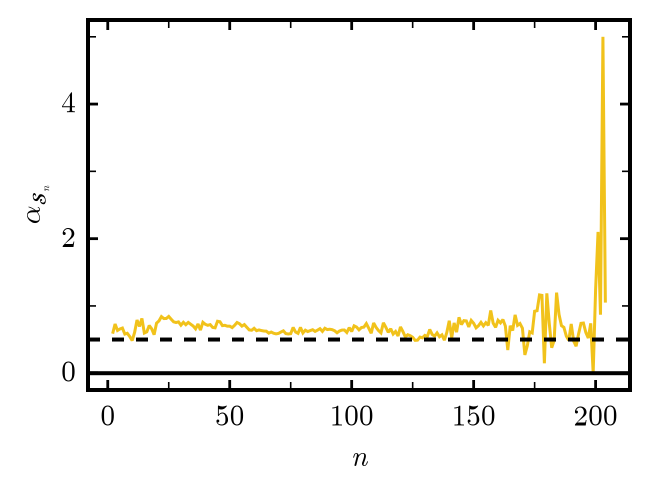

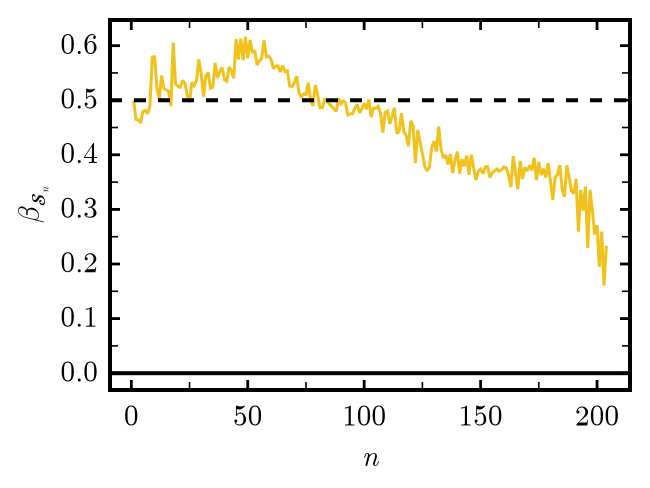

In [ ]:


dense_hists_manifoldlike_non_simply_connected = densify_hists(abundance_hists_manifoldlike_non_simply_connected[1])

abundances_manifoldlike_non_simply_connected_std_exp = plot_alpha_bins(dense_hists_manifoldlike_non_simply_connected; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
#bin_plot = 150,
N0 = 1,
magnification = 1)

abundances_manifoldlike_non_simply_connected_mean_exp = plot_beta_bins(dense_hists_manifoldlike_non_simply_connected; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
#bin_plot = 190,
N0 = 1,
magnification = 1)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_non_simply_connected_mean_exp.pdf", 
    abundances_manifoldlike_non_simply_connected_mean_exp)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_manifoldlike_non_simply_connected_std_exp.pdf", 
    abundances_manifoldlike_non_simply_connected_std_exp)

foreach(display, 
    [abundances_manifoldlike_non_simply_connected_std_exp, 
    abundances_manifoldlike_non_simply_connected_mean_exp])

# Minkowski Quasicrystal

## Sizes

In [ ]:
data_paths_minkowski_quasicrystal = ["/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_512_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_1024_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_2048_10000/statistics.jld2"]
abundance_hists_minkowski_quasicrystal=load_histograms_from_paths(data_paths_minkowski_quasicrystal, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_512_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_1024_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_2048_10000/statistics.jld2


4-element Vector{Vector{Dict}}:
 [Dict(56 => 55, 35 => 162, 110 => 18, 60 => 91, 30 => 141, 6 => 692, 67 => 72, 234 => 1, 73 => 43, 182 => 1…), Dict(56 => 53, 35 => 156, 110 => 22, 60 => 78, 30 => 145, 6 => 698, 67 => 72, 73 => 43, 182 => 2, 164 => 3…), Dict(56 => 61, 35 => 170, 110 => 21, 60 => 88, 30 => 145, 6 => 651, 67 => 59, 73 => 46, 182 => 1, 164 => 5…), Dict(56 => 76, 35 => 157, 110 => 22, 60 => 86, 30 => 172, 6 => 685, 67 => 53, 219 => 1, 73 => 43, 182 => 3…), Dict(56 => 67, 35 => 157, 110 => 21, 60 => 98, 30 => 150, 6 => 701, 67 => 62, 215 => 1, 73 => 42, 182 => 4…), Dict(56 => 52, 35 => 170, 110 => 30, 60 => 94, 30 => 143, 6 => 649, 67 => 65, 73 => 35, 164 => 3, 115 => 12…), Dict(56 => 56, 35 => 158, 110 => 22, 60 => 91, 30 => 140, 6 => 681, 67 => 68, 73 => 36, 182 => 1, 164 => 5…), Dict(56 => 56, 35 => 167, 110 => 20, 60 => 95, 30 => 139, 6 => 674, 67 => 71, 73 => 38, 182 => 1, 164 => 9…), Dict(56 => 58, 35 => 159, 110 => 31, 60 => 84, 30 => 169, 6 => 690, 67 => 61, 73 => 3

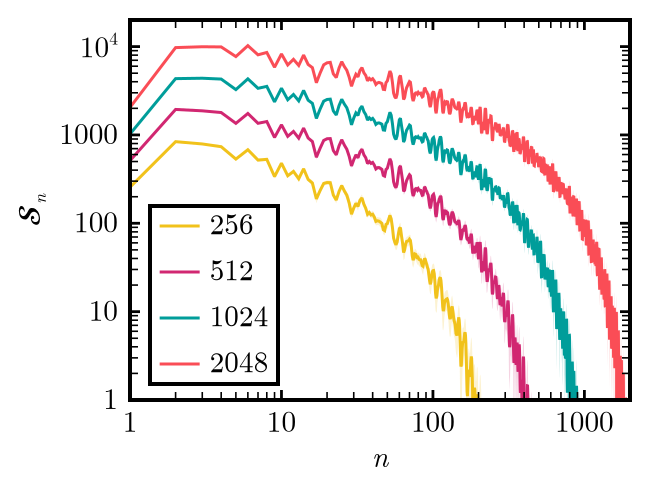

CairoMakie.Screen{IMAGE}


In [ ]:


average_std_plot_data_minkowski_quasicrystal = [average_histogram_with_std(abundance_hists_minkowski_quasicrystal[i]) for i in 1:length(abundance_hists_minkowski_quasicrystal)]
abundances_minkowski_quasicrystal_size_comp_plot = plot_mean_histograms_with_std(
    average_std_plot_data_minkowski_quasicrystal; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 2000.), 
    ylim = (1.e0, 20000.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = ["256", "512", "1024", "2048"], 
    magnification = 1,
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0)
    )

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_quasicrystal_size_comp_plot.pdf", 
    abundances_minkowski_quasicrystal_size_comp_plot)

display(abundances_minkowski_quasicrystal_size_comp_plot)

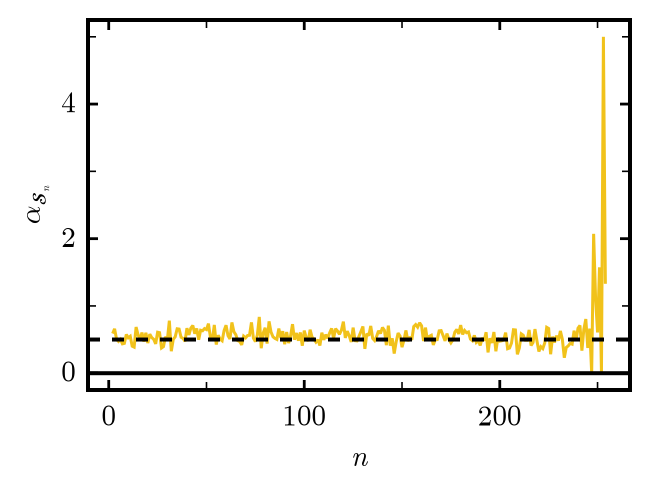

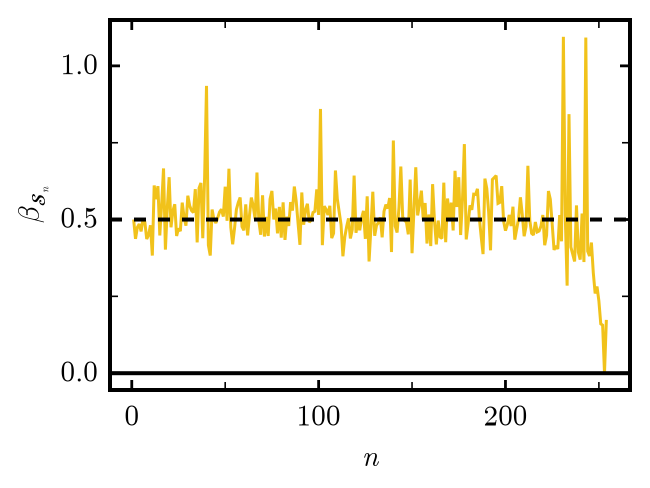

In [ ]:


dense_hists_minkowski_quasicrystal = densify_hists(abundance_hists_minkowski_quasicrystal[1])

abundances_minkowski_quasicrystal_std_exp = plot_alpha_bins(dense_hists_minkowski_quasicrystal; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
#bin_plot = 150,
N0 = 1,
magnification = 1)

abundances_minkowski_quasicrystal_mean_exp = plot_beta_bins(dense_hists_minkowski_quasicrystal; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
#bin_plot = 190,
N0 = 1,
magnification = 1)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_quasicrystal_mean_exp.pdf", 
    abundances_minkowski_quasicrystal_mean_exp)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_quasicrystal_std_exp.pdf", 
    abundances_minkowski_quasicrystal_std_exp)

foreach(display, 
    [abundances_minkowski_quasicrystal_std_exp, 
    abundances_minkowski_quasicrystal_mean_exp])

## Fit oscillating pattern

### Eyeball comparison

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_2048_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_2048_10000/statistics.jld2


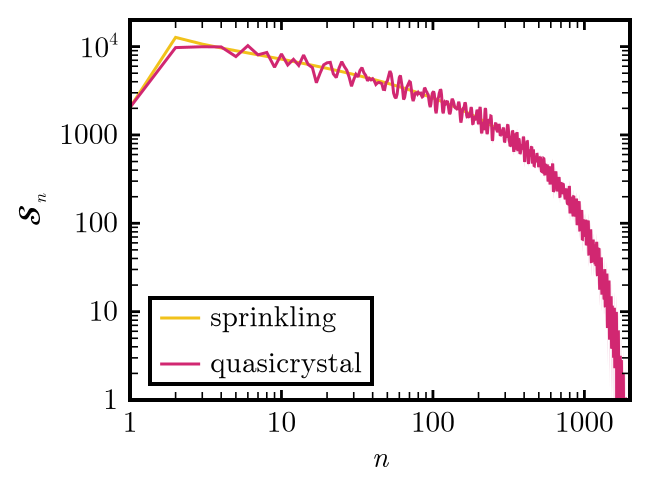

In [ ]:
data_paths_comp_mink_cryst_sprink = ["/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_2048_10000/statistics.jld2","/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_2048_10000/statistics.jld2"]
abundance_hists_comp_mink_cryst_sprink=load_histograms_from_paths(data_paths_comp_mink_cryst_sprink, :cardinalities_hist)
average_std_plot_data_comp_mink_cryst_sprink = [average_histogram_with_std(abundance_hists_comp_mink_cryst_sprink[i]) for i in 1:length(abundance_hists_comp_mink_cryst_sprink)]

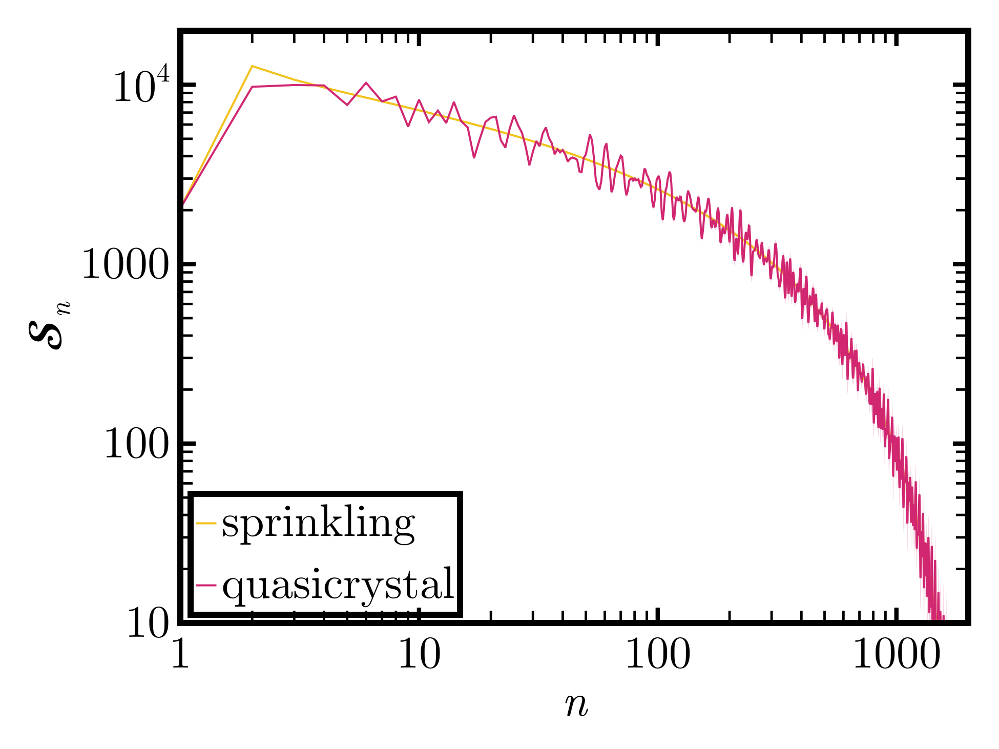

In [ ]:

abundances_comp_mink_cryst_sprink_size_comp_plot = plot_mean_histograms_with_std(
    average_std_plot_data_comp_mink_cryst_sprink; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 2000.), 
    ylim = (1.e1, 20000.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = ["sprinkling", "quasicrystal"], 
    magnification = 3,
    #plot_types = [:line, :scatter],
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0),
    markersize = 2,
    linewidth = 2
    )

### Fourier analysis

f_peak = 0.05405405405405406
P_est = 18.5
f = 0.05405405405405406  P ≈ 18.5  A = 0.06504631165386501
f = 0.03203203203203203  P ≈ 31.21875  A = 0.05166887939654834
f = 0.036036036036036036  P ≈ 27.75  A = 0.04346097404678746
f = 0.055055055055055056  P ≈ 18.163636363636364  A = 0.04235683948870975
f = 0.02902902902902903  P ≈ 34.44827586206896  A = 0.04171500075547071


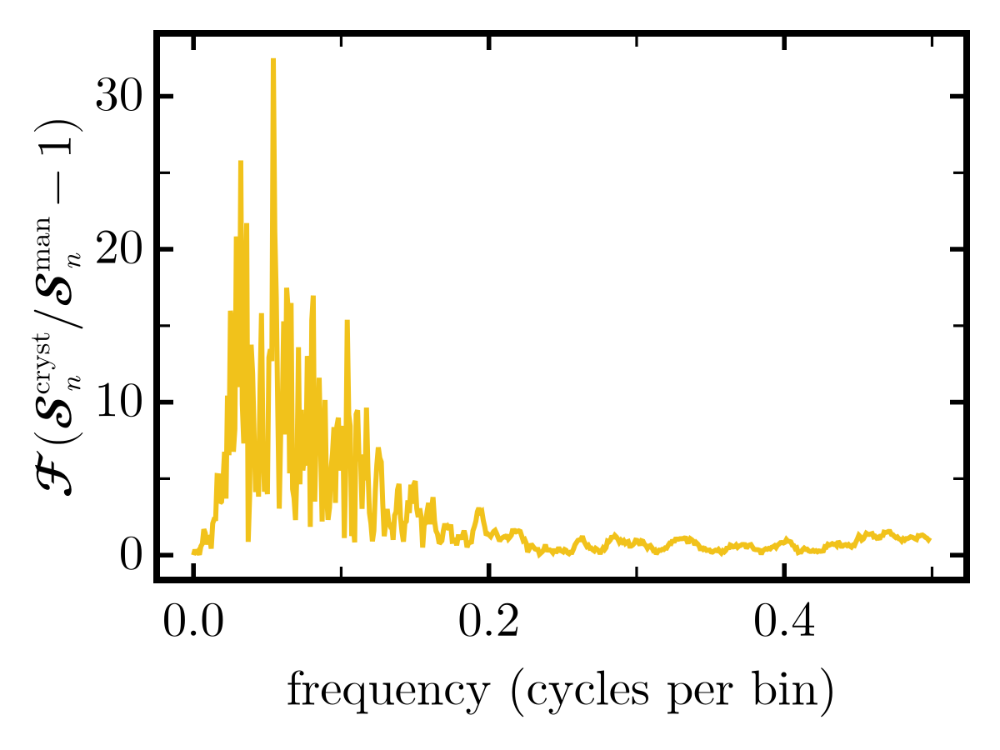

In [ ]:
using FFTW
r_comp_mink_cryst_sprink = average_std_plot_data_comp_mink_cryst_sprink[2][1][2:1000] ./ average_std_plot_data_comp_mink_cryst_sprink[1][1][2:1000] .- 1
r_dev_comp_mink_cryst_sprink = r_comp_mink_cryst_sprink .- Statistics.mean(r_comp_mink_cryst_sprink);
r_dev_fou_comp_mink_cryst_sprink = abs.(fft(r_dev_comp_mink_cryst_sprink))
r_dev_freqs_comp_mink_cryst_sprink = (0:length(r_dev_comp_mink_cryst_sprink)-1) ./ length(r_dev_comp_mink_cryst_sprink)  # cycles per sample
half = 1:(fld(length(r_dev_comp_mink_cryst_sprink),2))          # skip DC at 1
peak_idx = half[argmax(r_dev_fou_comp_mink_cryst_sprink[half])]
f_peak = r_dev_freqs_comp_mink_cryst_sprink[peak_idx]
P_est = 1 / f_peak           # period in “bins”

@show f_peak P_est

k = 5
idxs = sortperm(r_dev_fou_comp_mink_cryst_sprink[half]; rev=true)[1:k]
for i in idxs
    f = r_dev_freqs_comp_mink_cryst_sprink[half[i]]
    A = 2 * abs(r_dev_fou_comp_mink_cryst_sprink[half[i]]) / length(r_dev_comp_mink_cryst_sprink)
    println("f = ", f, "  P ≈ ", 1/f, "  A = ", A)
end

apply_paper_theme!(; magnification = 2)
fig, ax = lines(r_dev_freqs_comp_mink_cryst_sprink[keep], r_dev_fou_comp_mink_cryst_sprink[half])
ax.xlabel = "frequency (cycles per bin)"
ax.ylabel = L"\mathcal{F}(\mathcal{S}_n^{\mathrm{cryst}} / \mathcal{S}_n^{\mathrm{man}} -1)"

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/fft_comp_mink_cryst_sprink.pdf", 
    fig)
fig

In [98]:
k = 5
idxs = sortperm(r_dev_fou_comp_mink_cryst_sprink[half]; rev=true)[1:k]
for i in idxs
    f = r_dev_freqs_comp_mink_cryst_sprink[half[i]]
    A = 2 * abs(r_dev_fou_comp_mink_cryst_sprink[half[i]]) / length(r_dev_comp_mink_cryst_sprink)
    println("f = ", f, "  P ≈ ", 1/f, "  A = ", A)
end


f = 0.05405405405405406  P ≈ 18.5  A = 0.06504631165386501
f = 0.03203203203203203  P ≈ 31.21875  A = 0.05166887939654834
f = 0.036036036036036036  P ≈ 27.75  A = 0.04346097404678746
f = 0.055055055055055056  P ≈ 18.163636363636364  A = 0.04235683948870975
f = 0.02902902902902903  P ≈ 34.44827586206896  A = 0.04171500075547071


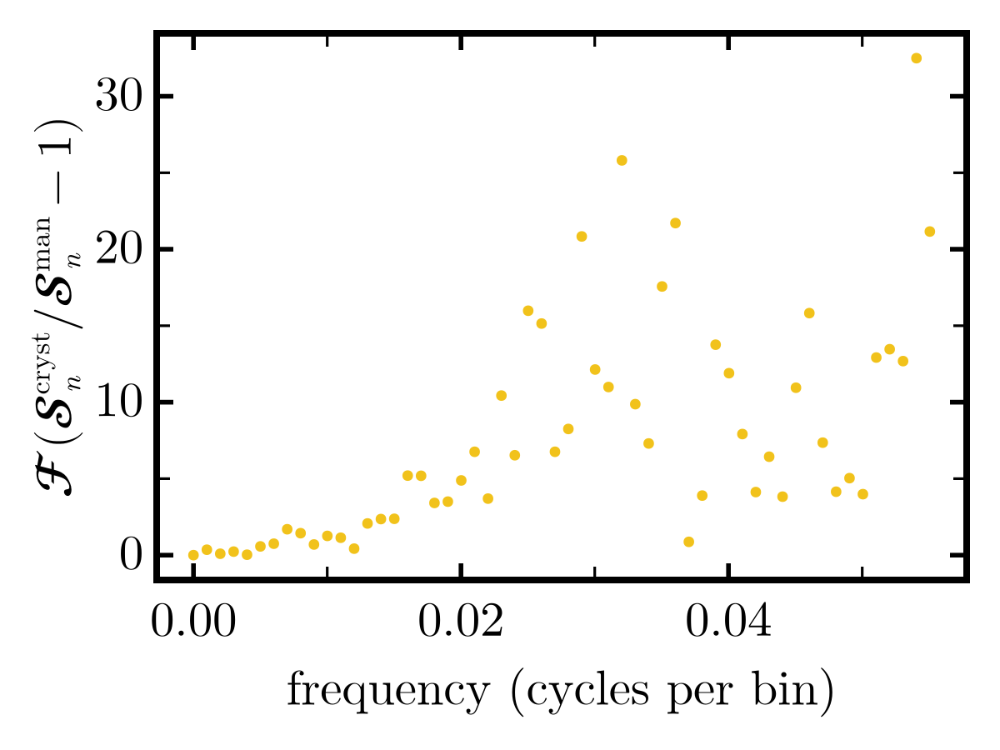

In [ ]:
apply_paper_theme!(; magnification = 2)
fig, ax = scatter(r_dev_freqs_comp_mink_cryst_sprink[half], r_dev_fou_comp_mink_cryst_sprink[half])
ax.xlabel = "frequency (cycles per bin)"
ax.ylabel = L"\mathcal{F}(\mathcal{S}_n^{\mathrm{cryst}} / \mathcal{S}_n^{\mathrm{man}} -1)"

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/fft_comp_mink_cryst_sprink.pdf", 
    fig)
fig

## Graph observables

In [ ]:
data_paths_mink = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ? 
["/Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2", 
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_sprinkling_256_10000/statistics.jld2"] :
["/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_256_10000/statistics.jl",
"/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_256_10000/statistics.jld2"]
in_degree_hists_mink         = load_histograms_from_paths(data_paths_mink, :in_degree_hist)
out_degree_hists_mink        = load_histograms_from_paths(data_paths_mink, :out_degree_hist)
ev_in_hists_mink             = load_histograms_from_paths(data_paths_mink, :ev_in_hist)
ev_out_hists_mink            = load_histograms_from_paths(data_paths_mink, :ev_out_hist)
connectivity_hists_mink      = join_histograms([in_degree_hists_mink,out_degree_hists_mink])
in_degree_link_hists_mink    = load_histograms_from_paths(data_paths_mink, :in_degree_hist_link)
out_degree_link_hists_mink   = load_histograms_from_paths(data_paths_mink, :out_degree_hist_link)
ev_in_link_hists_mink        = load_histograms_from_paths(data_paths_mink, :ev_in_hist_link)
ev_out_link_hists_mink       = load_histograms_from_paths(data_paths_mink, :ev_out_hist_link)
connectivity_link_hists_mink = join_histograms([in_degree_link_hists_mink,out_degree_link_hists_mink])
max_pathlen_hists_mink      = load_histograms_from_paths(data_paths_mink, :max_pathlen_hist)

  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/

2-element Vector{Vector{Dict}}:
 [Dict(22.0 => 1, 20.0 => 1, 30.0 => 1, 28.0 => 1), Dict(22.0 => 1, 29.0 => 2, 24.0 => 1, 30.0 => 1), Dict(15.0 => 1, 25.0 => 1, 27.0 => 2, 24.0 => 1, 28.0 => 1, 19.0 => 1), Dict(29.0 => 1, 31.0 => 1, 24.0 => 1, 30.0 => 1), Dict(25.0 => 1, 30.0 => 1, 28.0 => 1, 14.0 => 1), Dict(22.0 => 1, 25.0 => 1, 31.0 => 2, 19.0 => 1), Dict(15.0 => 1, 29.0 => 1, 27.0 => 1, 26.0 => 1, 23.0 => 1, 19.0 => 1), Dict(29.0 => 1, 26.0 => 1, 31.0 => 1, 23.0 => 1, 19.0 => 1), Dict(22.0 => 1, 32.0 => 1, 30.0 => 2, 28.0 => 1), Dict(32.0 => 2, 31.0 => 1, 19.0 => 1)  …  Dict(25.0 => 2, 28.0 => 3), Dict(29.0 => 1, 26.0 => 2, 28.0 => 2, 23.0 => 1), Dict(30.0 => 3, 28.0 => 1, 19.0 => 1), Dict(25.0 => 1, 10.0 => 1, 27.0 => 1, 30.0 => 2), Dict(10.0 => 1, 31.0 => 3, 24.0 => 1, 23.0 => 1), Dict(29.0 => 1, 24.0 => 1, 28.0 => 1, 23.0 => 1), Dict(29.0 => 1, 31.0 => 1, 14.0 => 1, 23.0 => 1), Dict(22.0 => 1, 29.0 => 1, 10.0 => 1, 28.0 => 1), Dict(22.0 => 1, 29.0 => 1, 30.0 => 1), Dict(21.0 => 

In [133]:
cset_size_mink = 256
normalized_in_degree_hists_mink         = normalize_hists(in_degree_hists_mink)
normalized_out_degree_hists_mink        = normalize_hists(out_degree_hists_mink)
normalized_ev_in_hists_mink             = normalize_hists(ev_in_hists_mink; normalization = cset_size_mink)
normalized_ev_out_hists_mink            = normalize_hists(ev_out_hists_mink; normalization = cset_size_mink)
normalized_connectivity_hists_mink      = normalize_hists(connectivity_hists_mink)
normalized_in_degree_link_hists_mink    = normalize_hists(in_degree_link_hists_mink)
normalized_out_degree_link_hists_mink   = normalize_hists(out_degree_link_hists_mink)
normalized_ev_in_link_hists_mink        = normalize_hists(ev_in_link_hists_mink; normalization = cset_size_mink)
normalized_ev_out_link_hists_mink       = normalize_hists(ev_out_link_hists_mink; normalization = cset_size_mink)
normalized_connectivity_link_hists_mink = normalize_hists(connectivity_link_hists_mink)
normalized_max_pathlen_hists_mink       = normalize_hists(max_pathlen_hists_mink; normalization = 1)

2-element Vector{Vector{Dict{Int64, Float64}}}:
 [Dict(22 => 1.0, 20 => 1.0, 30 => 1.0, 28 => 1.0), Dict(22 => 1.0, 29 => 2.0, 24 => 1.0, 30 => 1.0), Dict(15 => 1.0, 25 => 1.0, 27 => 2.0, 24 => 1.0, 28 => 1.0, 19 => 1.0), Dict(29 => 1.0, 31 => 1.0, 24 => 1.0, 30 => 1.0), Dict(25 => 1.0, 30 => 1.0, 28 => 1.0, 14 => 1.0), Dict(22 => 1.0, 25 => 1.0, 31 => 2.0, 19 => 1.0), Dict(15 => 1.0, 29 => 1.0, 27 => 1.0, 26 => 1.0, 23 => 1.0, 19 => 1.0), Dict(29 => 1.0, 26 => 1.0, 31 => 1.0, 23 => 1.0, 19 => 1.0), Dict(22 => 1.0, 32 => 1.0, 30 => 2.0, 28 => 1.0), Dict(32 => 2.0, 31 => 1.0, 19 => 1.0)  …  Dict(25 => 2.0, 28 => 3.0), Dict(29 => 1.0, 26 => 2.0, 28 => 2.0, 23 => 1.0), Dict(30 => 3.0, 28 => 1.0, 19 => 1.0), Dict(25 => 1.0, 10 => 1.0, 27 => 1.0, 30 => 2.0), Dict(10 => 1.0, 31 => 3.0, 24 => 1.0, 23 => 1.0), Dict(29 => 1.0, 24 => 1.0, 28 => 1.0, 23 => 1.0), Dict(29 => 1.0, 31 => 1.0, 14 => 1.0, 23 => 1.0), Dict(22 => 1.0, 29 => 1.0, 10 => 1.0, 28 => 1.0), Dict(22 => 1.0, 29 => 1.0, 30 => 1.0

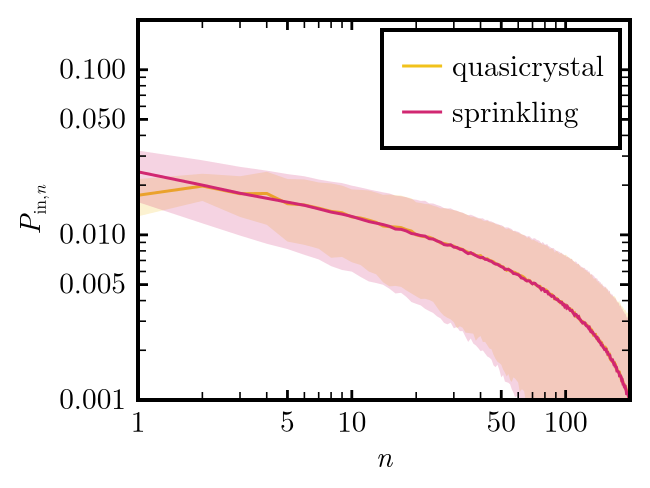

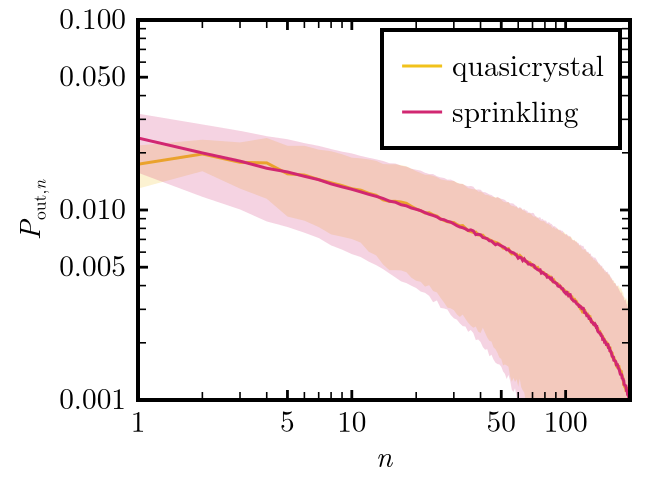

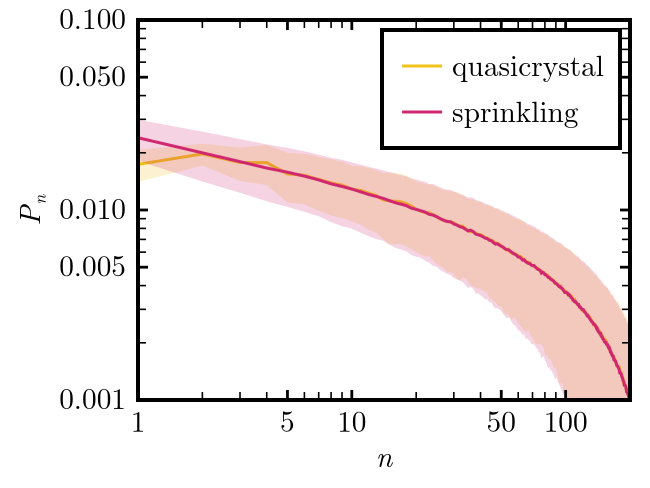

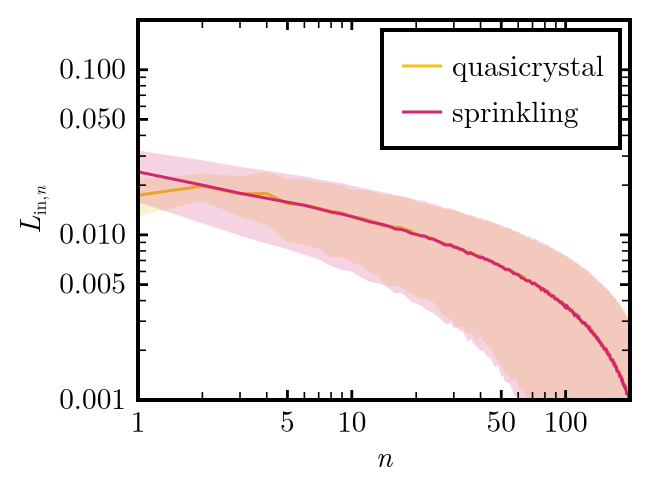

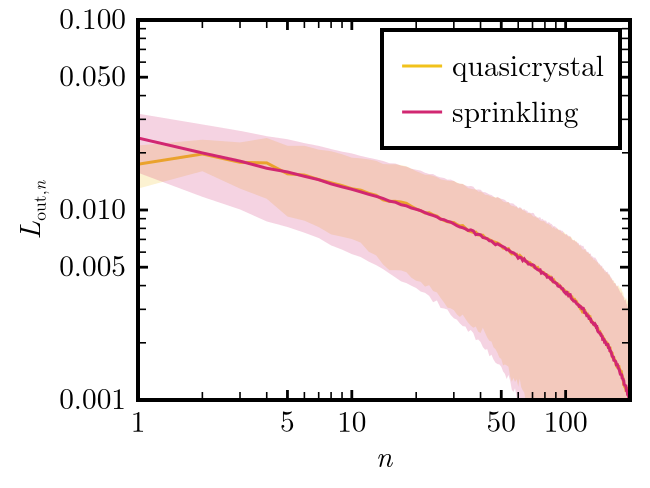

...

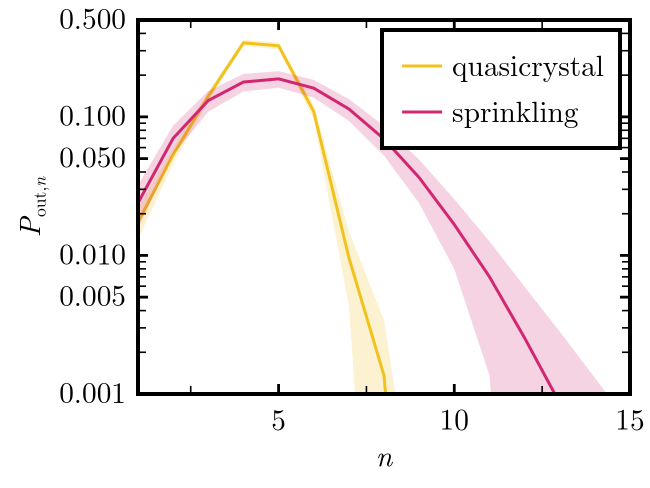

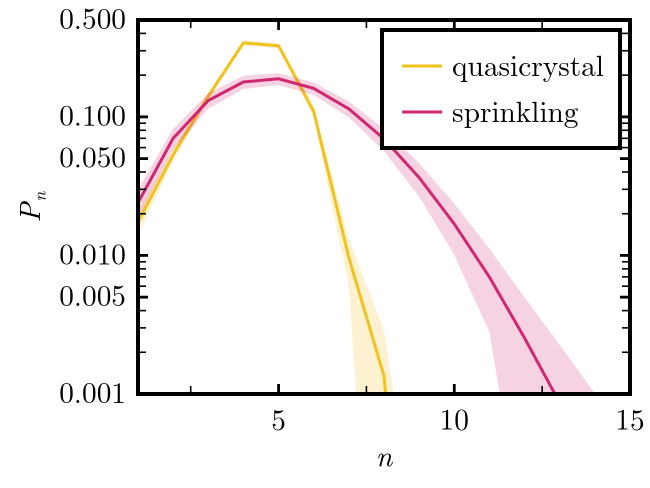

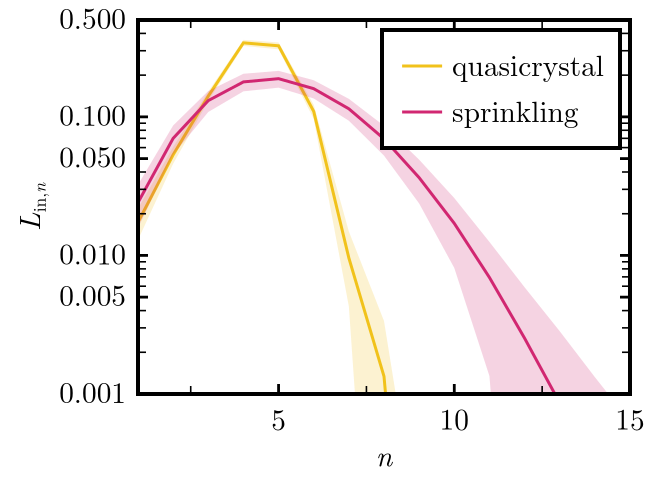

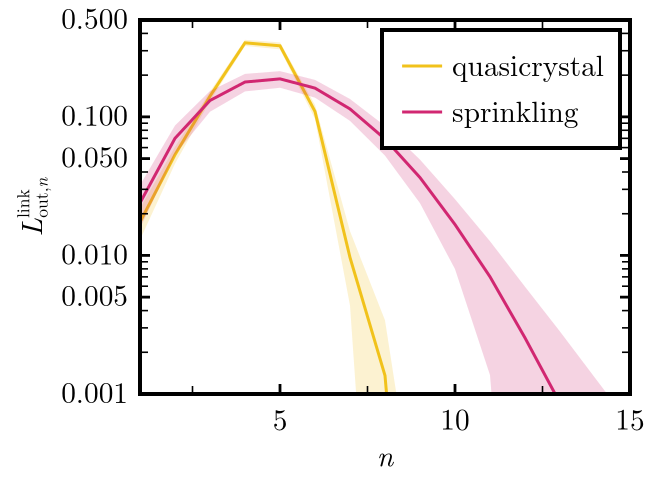

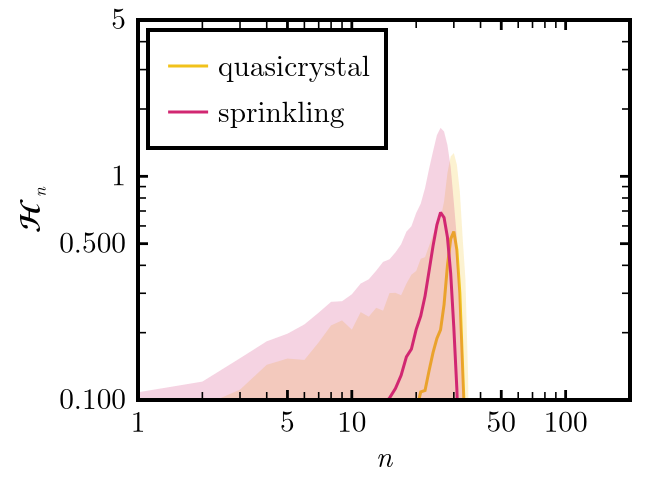

In [134]:
foreach(
    display,
    [
    plot_and_save_hists(
        normalized_in_degree_hists_mink,
        "sprinkling_quasicrystal/in_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
    ),

    plot_and_save_hists(
        normalized_out_degree_hists_mink,
        "sprinkling_quasicrystal/out_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
    ),

    plot_and_save_hists(
        normalized_connectivity_hists_mink,
        "sprinkling_quasicrystal/connectivity.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["quasicrystal", "sprinkling"], 
    ),

    plot_and_save_hists(
        normalized_ev_in_hists_mink,
        "sprinkling_quasicrystal/ev_in.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
    ),

    plot_and_save_hists(
        normalized_ev_out_hists_mink,
        "sprinkling_quasicrystal/ev_out.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{out}, n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
    ),

    plot_and_save_hists(
        normalized_in_degree_link_hists_mink,
        "sprinkling_quasicrystal/in_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_out_degree_link_hists_mink,
        "sprinkling_quasicrystal/out_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_connectivity_link_hists_mink,
        "sprinkling_quasicrystal/connectivity_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["quasicrystal", "sprinkling"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_in_link_hists_mink,
        "sprinkling_quasicrystal/ev_in_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_out_link_hists_mink,
        "sprinkling_quasicrystal/ev_out_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L^{\mathrm{link}}_{\mathrm{out},n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
        logscale_x = false,
    ),


    plot_and_save_hists(
        normalized_max_pathlen_hists_mink,
        "sprinkling_quasicrystal/max_pathlen.pdf";
        xlim = (1., 200.), 
        ylim = (.1, 5.), 
        xlabel = L"n", 
        ylabel = L"\mathcal{H}_{n}",
        hist_labels = ["quasicrystal", "sprinkling"], 
        legendpos = :lt
    ),

    ]
)

Degree distribution or graph-Laplacian eigenvalues of link matrix

# Minkowski sprinklings

## Size checks

In [ ]:
data_paths_minkowski_sprinkling = ["/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_300_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_400_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_512_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_600_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_1024_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_2048_10000/statistics.jld2"]
abundance_hists_minkowski_sprinkling=load_histograms_from_paths(data_paths_minkowski_sprinkling, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_300_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_400_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_512_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_600_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_1024_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_2048_10000/statistics.jld2


7-element Vector{Vector{Dict}}:
 [Dict(56 => 71, 35 => 139, 110 => 18, 60 => 53, 30 => 153, 6 => 516, 67 => 60, 73 => 47, 115 => 11, 153 => 3…), Dict(56 => 85, 35 => 139, 110 => 18, 60 => 66, 30 => 173, 6 => 551, 67 => 55, 215 => 1, 73 => 47, 182 => 1…), Dict(56 => 55, 35 => 155, 110 => 15, 60 => 62, 30 => 185, 6 => 521, 67 => 49, 73 => 46, 182 => 1, 164 => 4…), Dict(56 => 72, 35 => 144, 110 => 16, 60 => 67, 30 => 166, 6 => 567, 67 => 66, 73 => 55, 182 => 2, 164 => 2…), Dict(56 => 68, 35 => 125, 110 => 20, 60 => 52, 30 => 157, 6 => 544, 67 => 53, 73 => 37, 182 => 3, 164 => 2…), Dict(56 => 76, 35 => 127, 110 => 24, 60 => 62, 30 => 173, 6 => 563, 67 => 53, 73 => 41, 182 => 1, 164 => 3…), Dict(56 => 60, 35 => 117, 110 => 15, 60 => 55, 30 => 134, 6 => 574, 67 => 39, 215 => 1, 73 => 38, 182 => 2…), Dict(56 => 61, 35 => 123, 110 => 13, 60 => 54, 30 => 164, 6 => 539, 67 => 41, 73 => 53, 182 => 1, 164 => 2…), Dict(56 => 69, 35 => 137, 110 => 12, 60 => 66, 30 => 172, 6 => 552, 67 => 65, 215 => 

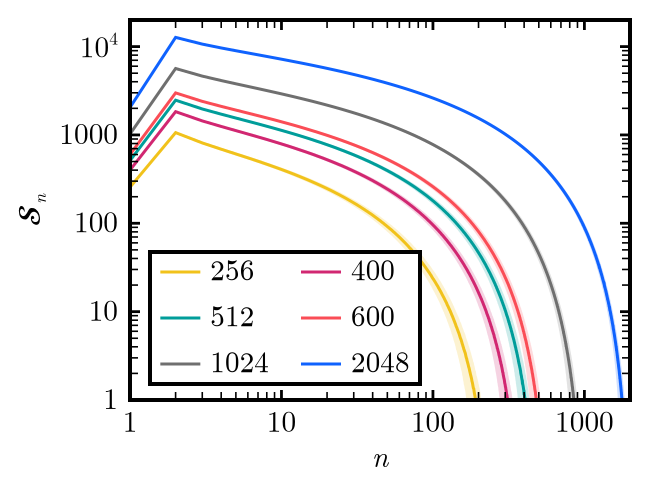

CairoMakie.Screen{IMAGE}


In [ ]:


abundance_hists_minkowski_sprinkling_red = [abundance_hists_minkowski_sprinkling[i] for i in [1, 3, 4, 5, 6, 7]]

average_std_plot_data_minkowski_sprinkling = [average_histogram_with_std(hists) for hists in abundance_hists_minkowski_sprinkling_red]
abundances_minkowski_sprinkling_size_comp_plot = plot_mean_histograms_with_std(
    average_std_plot_data_minkowski_sprinkling; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 2000.), 
    ylim = (1., 20000.), 
    xlabel = L"n", 
    ylabel = L"\mathcal{S}_n",
    hist_labels = ["256", "400", "512", "600", "1024", "2048"], 
    magnification = 1,
    legendpos = :lb,
    legendmargin = (10, 8, 8, 8),
    legendpadding = (5,5,0,0),
    n_Legend_columns = 2,
    )

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_sprinkling_size_comp_plot.pdf", 
    abundances_minkowski_sprinkling_size_comp_plot)

display(abundances_minkowski_sprinkling_size_comp_plot)

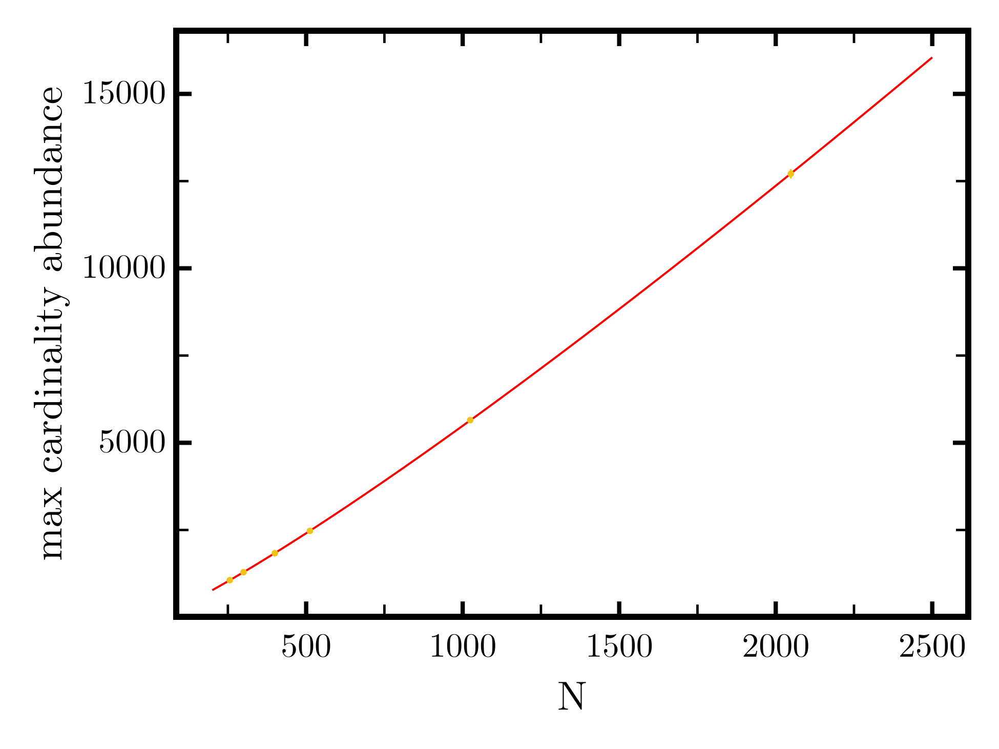

(params = (a = 1.8426324134576029, b = 1.160197345115875, c = -86.77124020418088), rel_residuals = [0.00217096948451198, -0.0006291532598169039, -0.0018409826233101044, -0.0009614407251645357, 0.0014420496672389296, -0.0002986758849948461], χ² = 0.007127008069403743)


In [ ]:


average_mink_max = [data_mink_size[i][1][2] for i in 1:length(data_mink_size)];
std_mink_max = [data_mink_size[i][2][2] for i in 1:length(data_mink_size)];
fit_res_mink_max = fit_histogram_bins(
    average_mink_max    ,
    (x, p) -> p.c + p.a * x .^ p.b,
    (:a, :b, :c),
    1,
    6;
    stds = std_mink_max,
    minimize_χ² = true,
    #init = (a = 1., b = 1., c = 1.),
    x_values = [256.0, 300., 400., 512.0, 1024.0, 2048.0],
    goodness_of_fit = true,
    multistart = 100,
    rng = MersenneTwister(42),
    )

figsize = apply_paper_theme!(
    magnification = 3,
    double_column = false,
    )
fig = Figure(size=figsize)
ax = Axis(fig[1,1];
    xlabel = "N",
    ylabel = "max cardinality abundance",
    )
x_fit = range(200, stop = 2500, length = 100)
y_fit = fit_res_mink_max.params.c .+ fit_res_mink_max.params.a .* x_fit .^ fit_res_mink_max.params.b
lines!(ax, x_fit, y_fit; linewidth = 2, color = :red)
scatter!(ax, [256, 300, 400, 512, 1024, 2048], average_mink_max;)
errorbars!(ax, [256, 300, 400, 512, 1024, 2048], average_mink_max, std_mink_max; direction = :y)
display(fig)
println(fit_res_mink_max)

In [ ]:


average_mink_normalized = [data_mink_size[i][1] / data_mink_size[i][1][2] for i in 1:length(data_mink_size)];
std_mink_normalized = [data_mink_size[i][2] / data_mink_size[i][1][2] for i in 1:length(data_mink_size)];
x_mink_normalized = [2:50, 2:60, 2:80, 2:100, 2:200, 2:400];
fit_res_mink_normalized = [fit_histogram_bins(
    average_mink_normalized[i],
    (x, p) -> p.a + p.b * x .^ p.α,
    (:a, :b, :α),
    2,
    [50, 60, 80, 100, 200, 400][i];
    stds = std_mink_normalized[i],
    minimize_χ² = true,
    init = (a = 1., b = 1., α = 1.),
    #x_values = x_values[i],
    goodness_of_fit = true,
    multistart = 1000,
    rng = MersenneTwister(42),
    )
    for i in 1:length(data_mink_size)]

6-element Vector{@NamedTuple{params::@NamedTuple{a::Float64, b::Float64, α::Float64}, rel_residuals::Vector{Float64}, χ²::Float64}}:
 (params = (a = -0.2168636990477334, b = 1.5803676030418468, α = -0.4214659117192311), rel_residuals = [0.03685764180558648, -0.01742424663312655, -0.023248603341194145, -0.020156208966233807, -0.014148642699614838, -0.008858150465638237, -0.0047698069322730805, -0.0010796538019400058, 0.002623701733850219, 0.0050561531592683345  …  -0.006829103481446729, -0.008118936172014845, -0.007015834986195147, -0.008541845211937155, -0.005727799960236552, -0.00877869341918018, -0.00546164811308828, -0.00798249856669602, -0.005725665812135195, -0.006235242349421504], χ² = 0.0596962129139229)
 (params = (a = -0.23400055546839185, b = 1.5685576319605659, α = -0.39282530765301504), rel_residuals = [0.03932967109890251, -0.015467884475984732, -0.022640387847218356, -0.019578269216931447, -0.015596855723893471, -0.010721140480144109, -0.006082923076238781, -0.00340231745

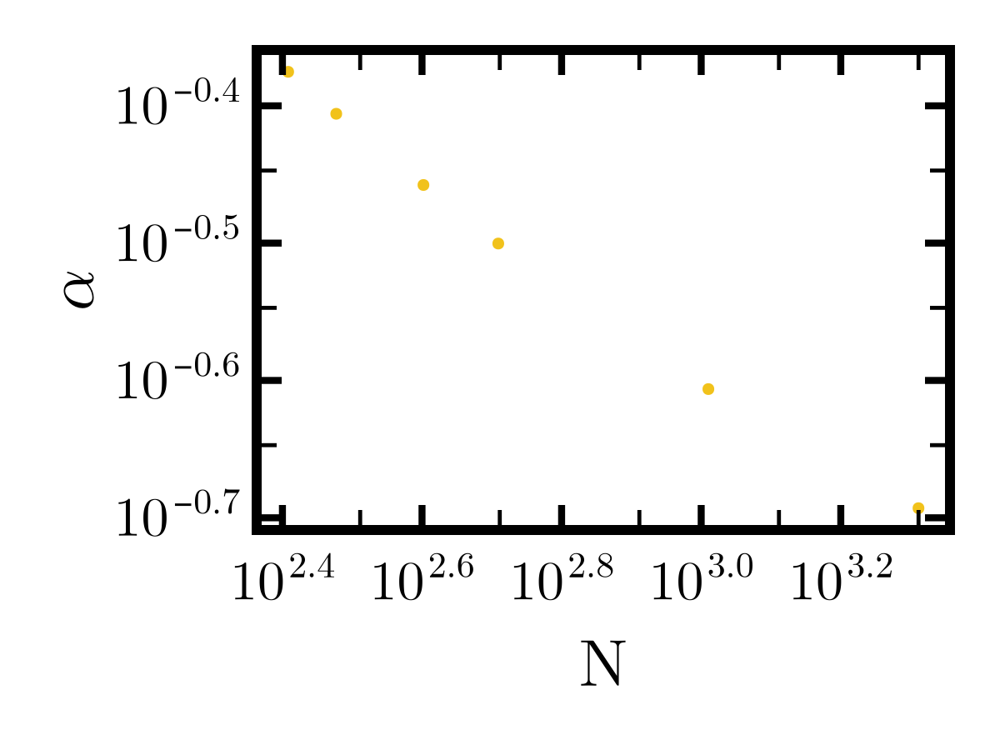

CairoMakie.Screen{IMAGE}


In [ ]:
apply_paper_theme!(
    magnification = 3,
    double_column = false,
    logscale_y = false,
    logscale_x = false,
    )
fig= Figure()
ax = Axis(fig[1,1];
    xlabel = "N",
    ylabel = L"\alpha",
    xscale = log10,
    yscale = log10
    )
scatter!(
    fig[1,1],
    [256, 300, 400, 512, 1024, 2048],
    [abs(fit.params.α) for fit in fit_res_mink_normalized];
    markersize = 10,
    )
display(fig)


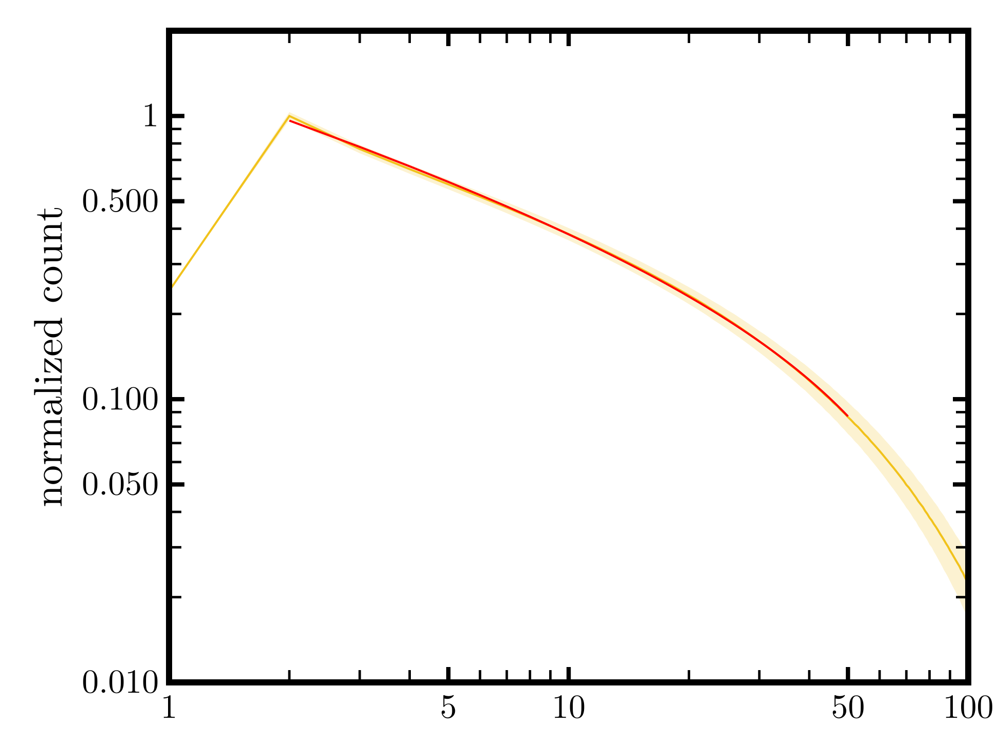

In [ ]:


fig, ax = plot_mean_histograms_with_std(
    [(average_mink_normalized[1], std_mink_normalized[1])];
ylabel = "normalized count",
return_axis = true,
logscale_x = true,
logscale_y = true,
xlim = (1., 100.),
ylim = (1.e-2, 2.),
magnification = 3,
linewidth = 2
)
lines!(ax, x_mink_normalized[1], fit_res_mink_normalized[1].params.a .+ fit_res_mink_normalized[1].params.b .* x_mink_normalized[1] .^ fit_res_mink_normalized[1].params.α; color = :red, linewidth = 2)
fig

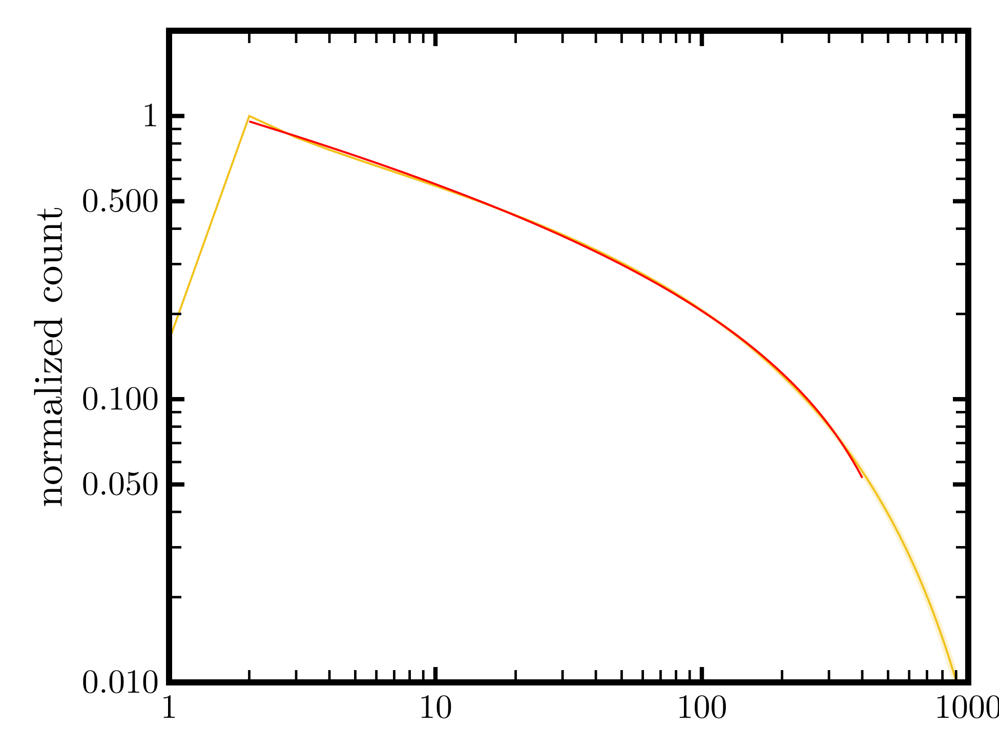

In [ ]:


fig, ax = plot_mean_histograms_with_std(
    [(average_mink_normalized[end], std_mink_normalized[end])];
ylabel = "normalized count",
return_axis = true,
logscale_x = true,
logscale_y = true,
xlim = (1., 1000.),
ylim = (1.e-2, 2.),
magnification = 3,
linewidth = 2
)
lines!(ax, x_mink_normalized[end], fit_res_mink_normalized[end].params.a .+ fit_res_mink_normalized[end].params.b .* x_mink_normalized[end] .^ fit_res_mink_normalized[end].params.α; color = :red, linewidth = 2)
fig

### Convergence checks

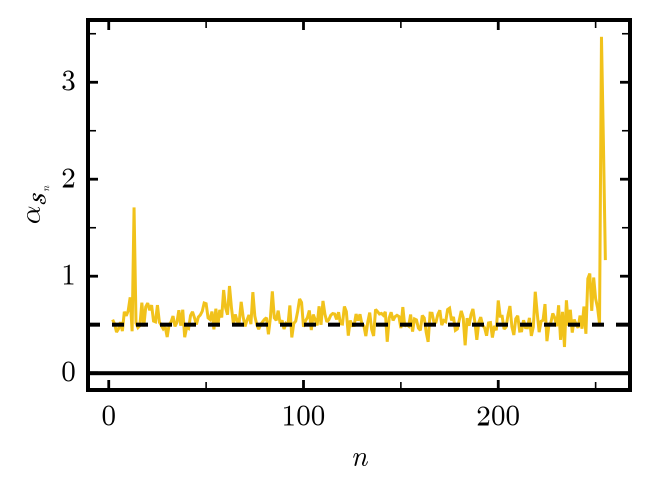

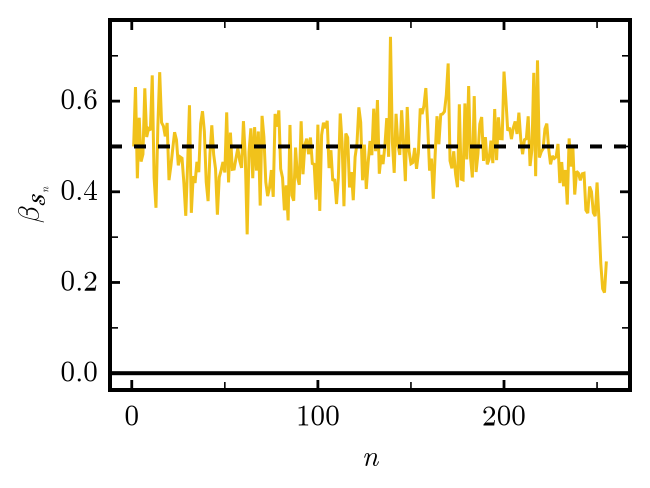

In [ ]:


dense_hists_minkowski_sprinkling = densify_hists(abundance_hists_minkowski_sprinkling[1])

abundances_minkowski_sprinkling_std_exp = plot_alpha_bins(dense_hists_minkowski_sprinkling; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
#bin_plot = 150,
N0 = 1,
magnification = 1)

abundances_minkowski_sprinkling_mean_exp = plot_beta_bins(dense_hists_minkowski_sprinkling; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
#bin_plot = 190,
N0 = 1,
magnification = 1)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_sprinkling_mean_exp.pdf", 
    abundances_minkowski_sprinkling_mean_exp)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_sprinkling_std_exp.pdf", 
    abundances_minkowski_sprinkling_std_exp)

foreach(display, 
    [abundances_minkowski_sprinkling_std_exp, 
    abundances_minkowski_sprinkling_mean_exp])

## Exact result comparison

In [ ]:
data_paths_minkowski_sprinkling_ex_comp = ["/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_512_10000/statistics.jld2"]
abundance_hists_minkowski_sprinkling_ex_comp=load_histograms_from_paths(data_paths_minkowski_sprinkling_ex_comp, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_512_10000/statistics.jld2


2-element Vector{Vector{Dict}}:
 [Dict(56 => 71, 35 => 139, 110 => 18, 60 => 53, 30 => 153, 6 => 516, 67 => 60, 73 => 47, 115 => 11, 153 => 3…), Dict(56 => 85, 35 => 139, 110 => 18, 60 => 66, 30 => 173, 6 => 551, 67 => 55, 215 => 1, 73 => 47, 182 => 1…), Dict(56 => 55, 35 => 155, 110 => 15, 60 => 62, 30 => 185, 6 => 521, 67 => 49, 73 => 46, 182 => 1, 164 => 4…), Dict(56 => 72, 35 => 144, 110 => 16, 60 => 67, 30 => 166, 6 => 567, 67 => 66, 73 => 55, 182 => 2, 164 => 2…), Dict(56 => 68, 35 => 125, 110 => 20, 60 => 52, 30 => 157, 6 => 544, 67 => 53, 73 => 37, 182 => 3, 164 => 2…), Dict(56 => 76, 35 => 127, 110 => 24, 60 => 62, 30 => 173, 6 => 563, 67 => 53, 73 => 41, 182 => 1, 164 => 3…), Dict(56 => 60, 35 => 117, 110 => 15, 60 => 55, 30 => 134, 6 => 574, 67 => 39, 215 => 1, 73 => 38, 182 => 2…), Dict(56 => 61, 35 => 123, 110 => 13, 60 => 54, 30 => 164, 6 => 539, 67 => 41, 73 => 53, 182 => 1, 164 => 2…), Dict(56 => 69, 35 => 137, 110 => 12, 60 => 66, 30 => 172, 6 => 552, 67 => 65, 215 => 

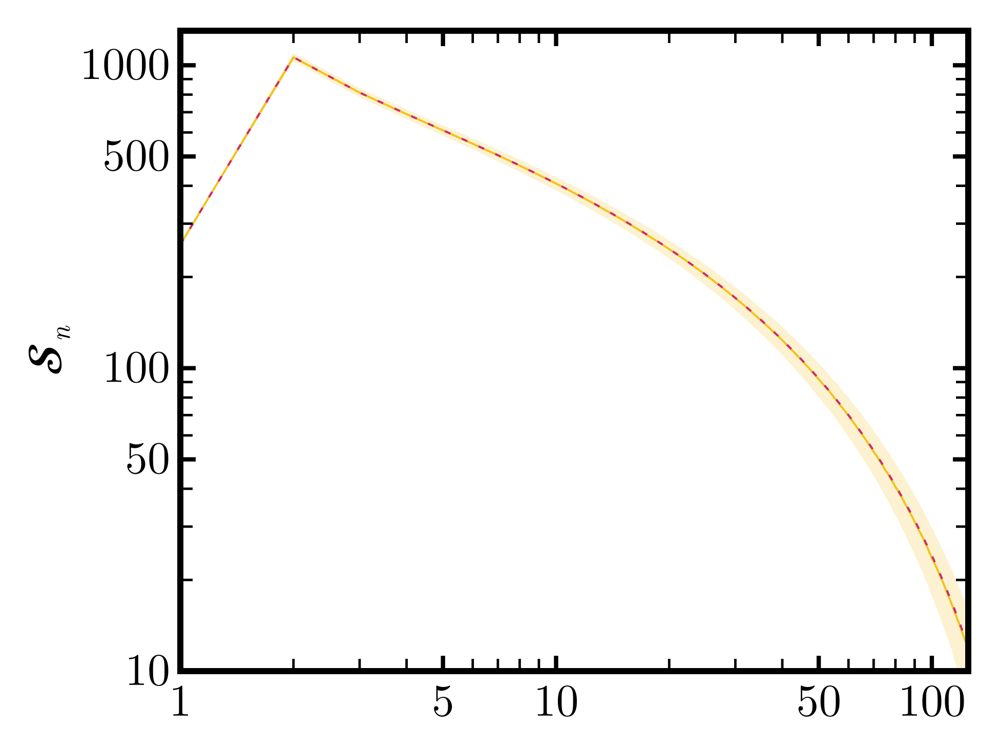

In [ ]:


x_val_mink_ex_comp = 1:256;
average_std_plot_data_minkowski_sprinkling_ex_comp = [average_histogram_with_std(abundance_hists_minkowski_sprinkling_ex_comp[1])]

fig, ax = plot_mean_histograms_with_std(
    average_std_plot_data_minkowski_sprinkling_ex_comp;
    ylabel = L"\mathcal{S}_n",
    return_axis = true,
    logscale_x = true, 
    logscale_y = true,
    xlim = (1., 125.),
    ylim = (1.e1, 1300.),
    magnification = 3,
    linewidth = 2
)
lines!(ax, x_val_mink_ex_comp, [minkowski_interval_abundance_2d_inclusive_asymptotic(x_val, 256) for x_val in x_val_mink_ex_comp]; color = colorant"#D12771", linestyle = (:dash,:loose), linewidth = 2)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_comp_analytical_mink.pdf", 
    fig)

fig

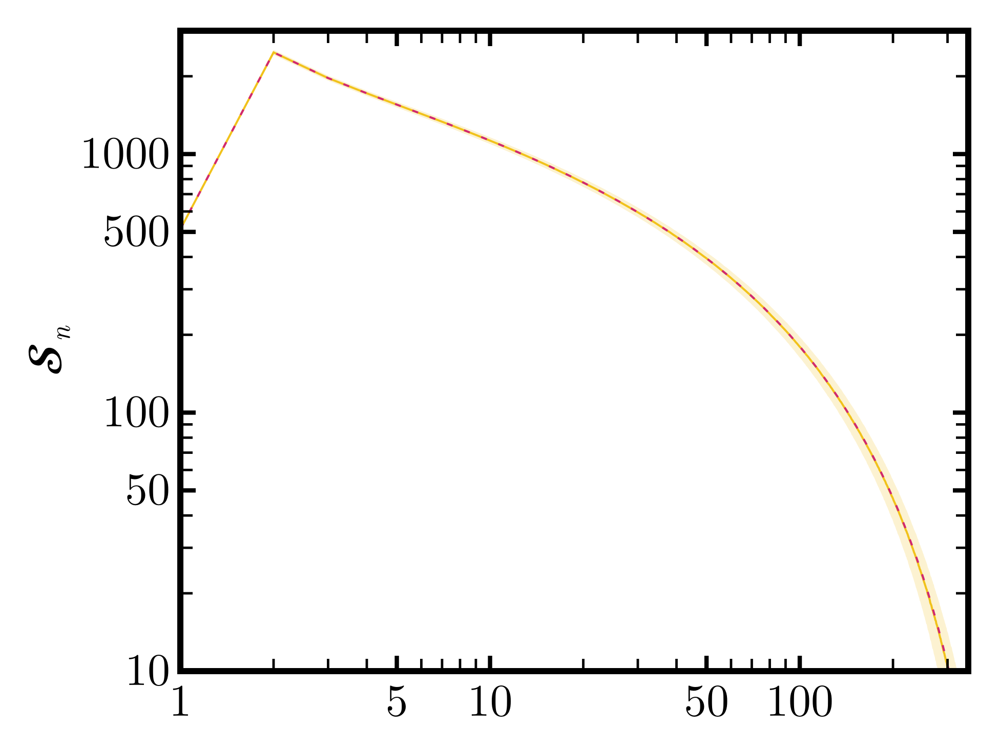

In [ ]:


x_val_mink_ex_comp = 1:512;
average_std_plot_data_minkowski_sprinkling_ex_comp = [average_histogram_with_std(abundance_hists_minkowski_sprinkling_ex_comp[2])]

fig, ax = plot_mean_histograms_with_std(
    average_std_plot_data_minkowski_sprinkling_ex_comp;
    ylabel = L"\mathcal{S}_n",
    return_axis = true,
    logscale_x = true, 
    logscale_y = true,
    xlim = (1., 350.),
    ylim = (1.e1, 3000.),
    magnification = 3,
    linewidth = 2
)
lines!(ax, x_val_mink_ex_comp, [minkowski_interval_abundance_2d_inclusive_asymptotic(x_val, 512) for x_val in x_val_mink_ex_comp]; color = colorant"#D12771", linestyle = (:dash,:loose), linewidth = 2)

fig

## Higher dimension check

In [ ]:
data_paths_minkowski_sprinkling_higher_dim = ["/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_2048_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_3D_2048_10000/statistics.jld2"]
abundance_hists_minkowski_sprinkling_higher_dim=load_histograms_from_paths(data_paths_minkowski_sprinkling_higher_dim, :cardinalities_hist)

  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_2048_10000/statistics.jld2
  Loaded 10000 histograms from /Volumes/Causal Set Silo/causal_sets/analysis/minkowski_sprinkling_3D_2048_10000/statistics.jld2


2-element Vector{Vector{Dict}}:
 [Dict(1144 => 49, 1175 => 51, 719 => 251, 1546 => 7, 1703 => 5, 1028 => 82, 699 => 284, 831 => 181, 1299 => 32, 1438 => 25…), Dict(1144 => 40, 1175 => 48, 719 => 211, 1546 => 5, 1703 => 5, 1028 => 64, 699 => 236, 831 => 161, 1299 => 22, 1438 => 9…), Dict(1144 => 58, 1175 => 39, 719 => 234, 1546 => 5, 1703 => 3, 1028 => 80, 699 => 231, 831 => 164, 1299 => 30, 1438 => 9…), Dict(1144 => 47, 1175 => 46, 719 => 209, 1546 => 3, 1703 => 2, 1028 => 69, 699 => 256, 831 => 143, 1299 => 22, 1438 => 10…), Dict(1144 => 35, 1175 => 34, 719 => 221, 1546 => 3, 1703 => 1, 1028 => 72, 699 => 230, 831 => 150, 1299 => 22, 1438 => 9…), Dict(1144 => 47, 1175 => 36, 719 => 230, 1546 => 8, 1028 => 77, 699 => 258, 831 => 147, 1299 => 17, 1438 => 13, 1074 => 54…), Dict(1144 => 54, 1175 => 36, 719 => 228, 1546 => 8, 1703 => 1, 1028 => 70, 699 => 240, 831 => 176, 1299 => 23, 1438 => 11…), Dict(1144 => 53, 1175 => 46, 719 => 226, 1546 => 11, 1703 => 1, 1028 => 86, 699 => 269, 831 =

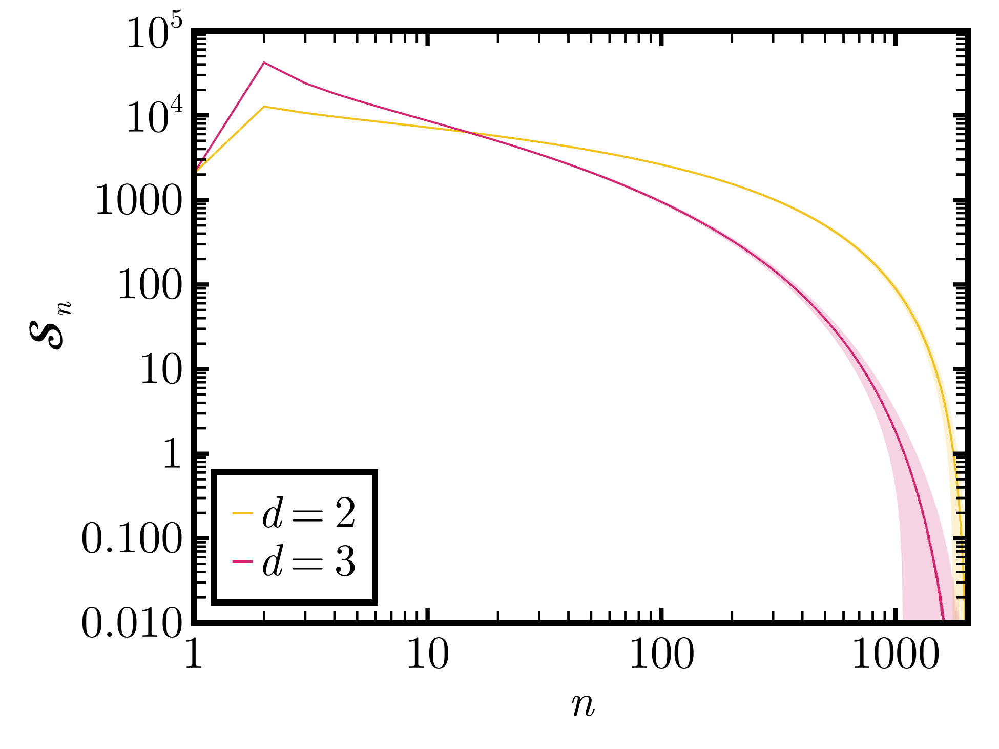

CairoMakie.Screen{PDF}


In [ ]:

average_std_plot_data_minkowski_sprinkling_higher_dim = [average_histogram_with_std(hist) for hist in abundance_hists_minkowski_sprinkling_higher_dim]
fig_minkowski_sprinkling_higher_dim = plot_mean_histograms_with_std(
    average_std_plot_data_minkowski_sprinkling_higher_dim; 
    logscale_x = true, 
    logscale_y = true, 
    xlim = (1., 2048.), 
    ylim = (1.e-2, 10^5.), 
    xlabel = L"n",
    ylabel = L"\mathcal{S}_n", 
    hist_labels = [L"d = 2", L"d = 3"], 
    magnification = 3,
    legendpos = :lb,
    legendmargin = (20,20,20,20),
    #normalize = true,
    linewidth = 2
    )

display(fig_minkowski_sprinkling_higher_dim)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_sprinkling_higher_dim.pdf", 
    fig_minkowski_sprinkling_higher_dim)

### Convergence checks

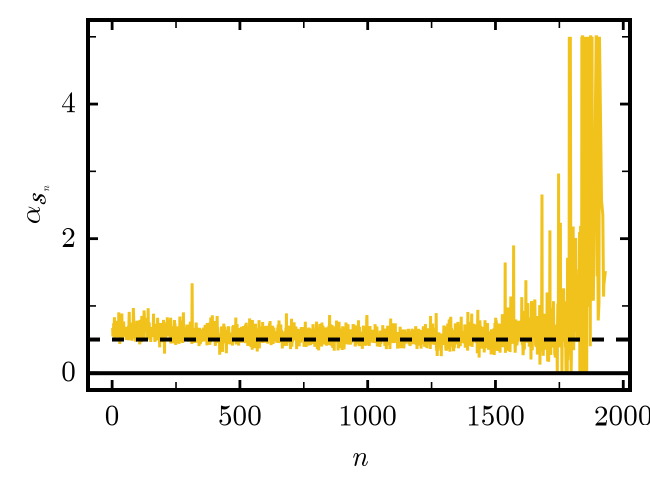

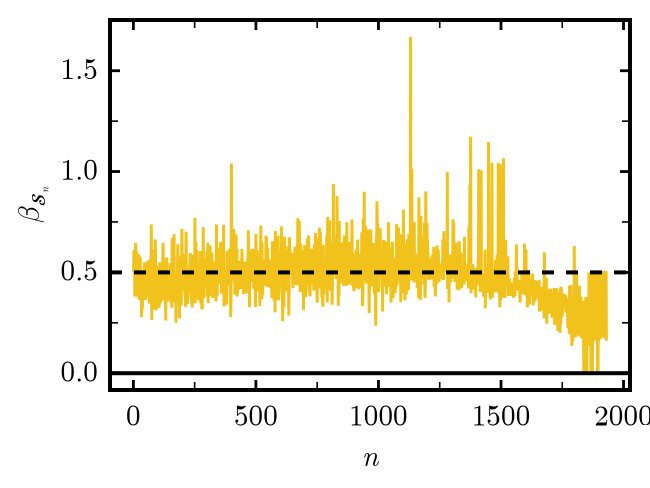

In [ ]:


dense_hists_minkowski_sprinkling_higher_dim = densify_hists(abundance_hists_minkowski_sprinkling_higher_dim[2])

abundances_minkowski_sprinkling_higher_dim_std_exp = plot_alpha_bins(dense_hists_minkowski_sprinkling_higher_dim; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\alpha_{\mathcal{S}_n}",
#bin_plot = 150,
N0 = 1,
magnification = 1)

abundances_minkowski_sprinkling_higher_dim_mean_exp = plot_beta_bins(dense_hists_minkowski_sprinkling_higher_dim; 
batchsize = 1,
bin_average = 1,
xlabel = L"n",
ylabel = L"\beta_{\mathcal{S}_n}",
#bin_plot = 190,
N0 = 1,
magnification = 1)

save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_sprinkling_higher_dim_mean_exp.pdf", 
    abundances_minkowski_sprinkling_higher_dim_mean_exp)
save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_minkowski_sprinkling_higher_dim_std_exp.pdf", 
    abundances_minkowski_sprinkling_higher_dim_std_exp)

foreach(display, 
    [abundances_minkowski_sprinkling_higher_dim_std_exp, 
    abundances_minkowski_sprinkling_higher_dim_mean_exp])

# Grids

## Sizes

In [ ]:
data_paths_grid = ["/Volumes/Causal Set Silo/causal_sets/analysis/grid_256_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/grid_512_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/grid_1024_10000/statistics.jld2", "/Volumes/Causal Set Silo/causal_sets/analysis/grid_2048_10000/statistics.jld2"]
abundance_hists_grid=load_histograms_from_paths(data_paths_grid, :cardinalities_hist)

┌ Warning: Opening file with JLD2.MmapIO failed, falling back to IOStream
└ @ JLD2 ~/.julia/packages/JLD2/hbsZG/src/JLD2.jl:162


LoadError: TaskFailedException

[91m    nested task error: [39mSystemError: opening file "/Volumes/Causal Set Silo/causal_sets/analysis/grid_256_10000/statistics.jld2": No such file or directory
    Stacktrace:
      [1] [0m[1msystemerror[22m[0m[1m([22m[90mp[39m::[0mString, [90merrno[39m::[0mInt32; [90mextrainfo[39m::[0mNothing[0m[1m)[22m
    [90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:186[24m[39m
      [2] [0m[1mopen[22m[0m[1m([22m[90mfname[39m::[0mString; [90mlock[39m::[0mBool, [90mread[39m::[0mBool, [90mwrite[39m::[0mBool, [90mcreate[39m::[0mBool, [90mtruncate[39m::[0mBool, [90mappend[39m::[0mBool[0m[1m)[22m
    [90m    @[39m [90mBase[39m [90m./[39m[90m[4miostream.jl:317[24m[39m
      [3] [0m[1mopen[22m
    [90m    @[39m [90m./[39m[90m[4miostream.jl:296[24m[39m[90m [inlined][39m
      [4] [0m[1mopenfile[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:152[24m[39m[90m [inlined][39m
      [5] [0m[1mopenfile[22m[0m[1m([22m[90mT[39m::[0mType, [90mfname[39m::[0mString, [90mwr[39m::[0mBool, [90mcreate[39m::[0mBool, [90mtruncate[39m::[0mBool, [90mfallback[39m::[0mType[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:163[24m[39m
      [6] [0m[1mjldopen[22m[0m[1m([22m[90mfname[39m::[0mString, [90mwr[39m::[0mBool, [90mcreate[39m::[0mBool, [90mtruncate[39m::[0mBool, [90miotype[39m::[0mType[90m{…}[39m; [90mfallback[39m::[0mType[90m{…}[39m, [90mcompress[39m::[0mBool, [90mmmaparrays[39m::[0mBool, [90mtypemap[39m::[0mFunction, [90mparallel_read[39m::[0mBool, [90mplain[39m::[0mBool[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:227[24m[39m
      [7] [0m[1mjldopen[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:174[24m[39m[90m [inlined][39m
      [8] [0m[1m#jldopen#14[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:297[24m[39m[90m [inlined][39m
      [9] [0m[1mjldopen[22m[0m[1m([22m[90mfname[39m::[0mString, [90mmode[39m::[0mString[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:290[24m[39m
     [10] [0m[1mjldopen[22m[0m[1m([22m::[0mFunction, ::[0mString, ::[0mVararg[90m{String}[39m; [90mkws[39m::[0m@Kwargs[90m{}[39m[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mloadsave.jl:2[24m[39m
     [11] [0m[1mjldopen[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mloadsave.jl:1[24m[39m[90m [inlined][39m
     [12] [0m[1mmacro expansion[22m
    [90m    @[39m [90m~/Desktop/git_projects/Causal sets/CausalSetZoology/analysis/[39m[90m[4mutils.jl:113[24m[39m[90m [inlined][39m
     [13] [0m[1m(::var"#28#29"{var"#30#31"{Vector{String}, Symbol, Vector{Vector{…}}, UnitRange{Int64}}})[22m[0m[1m([22m[90mtid[39m::[0mInt64; [90monethread[39m::[0mBool[0m[1m)[22m
    [90m    @[39m [35mMain[39m [90m./[39m[90m[4mthreadingconstructs.jl:276[24m[39m
     [14] [0m[1m#28[22m
    [90m    @[39m [90m./[39m[90m[4mthreadingconstructs.jl:243[24m[39m[90m [inlined][39m
     [15] [0m[1m(::Base.Threads.var"#threading_run##0#threading_run##1"{var"#28#29"{var"#30#31"{…}}, Int64})[22m[0m[1m([22m[0m[1m)[22m
    [90m    @[39m [90mBase.Threads[39m [90m./[39m[90m[4mthreadingconstructs.jl:177[24m[39m
    
    [91mcaused by: [39mSystemError: opening file "/Volumes/Causal Set Silo/causal_sets/analysis/grid_256_10000/statistics.jld2": No such file or directory
    Stacktrace:
      [1] [0m[1msystemerror[22m[0m[1m([22m[90mp[39m::[0mString, [90merrno[39m::[0mInt32; [90mextrainfo[39m::[0mNothing[0m[1m)[22m
    [90m    @[39m [90mBase[39m [90m./[39m[90m[4merror.jl:186[24m[39m
      [2] [0m[1mopen[22m[0m[1m([22m[90mfname[39m::[0mString; [90mlock[39m::[0mBool, [90mread[39m::[0mBool, [90mwrite[39m::[0mBool, [90mcreate[39m::[0mBool, [90mtruncate[39m::[0mBool, [90mappend[39m::[0mBool[0m[1m)[22m
    [90m    @[39m [90mBase[39m [90m./[39m[90m[4miostream.jl:317[24m[39m
      [3] [0m[1mopen[22m
    [90m    @[39m [90m./[39m[90m[4miostream.jl:296[24m[39m[90m [inlined][39m
      [4] [0m[1mJLD2.MmapIO[22m[0m[1m([22m[90mfname[39m::[0mString, [90mwrite[39m::[0mBool, [90mcreate[39m::[0mBool, [90mtruncate[39m::[0mBool[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/io/[39m[90m[4mmmapio.jl:101[24m[39m
      [5] [0m[1mopenfile[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:155[24m[39m[90m [inlined][39m
      [6] [0m[1mopenfile[22m[0m[1m([22m[90mT[39m::[0mType, [90mfname[39m::[0mString, [90mwr[39m::[0mBool, [90mcreate[39m::[0mBool, [90mtruncate[39m::[0mBool, [90mfallback[39m::[0mType[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:160[24m[39m
      [7] [0m[1mjldopen[22m[0m[1m([22m[90mfname[39m::[0mString, [90mwr[39m::[0mBool, [90mcreate[39m::[0mBool, [90mtruncate[39m::[0mBool, [90miotype[39m::[0mType[90m{…}[39m; [90mfallback[39m::[0mType[90m{…}[39m, [90mcompress[39m::[0mBool, [90mmmaparrays[39m::[0mBool, [90mtypemap[39m::[0mFunction, [90mparallel_read[39m::[0mBool, [90mplain[39m::[0mBool[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:227[24m[39m
      [8] [0m[1mjldopen[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:174[24m[39m[90m [inlined][39m
      [9] [0m[1m#jldopen#14[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:297[24m[39m[90m [inlined][39m
     [10] [0m[1mjldopen[22m[0m[1m([22m[90mfname[39m::[0mString, [90mmode[39m::[0mString[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mJLD2.jl:290[24m[39m
     [11] [0m[1mjldopen[22m[0m[1m([22m::[0mFunction, ::[0mString, ::[0mVararg[90m{String}[39m; [90mkws[39m::[0m@Kwargs[90m{}[39m[0m[1m)[22m
    [90m    @[39m [36mJLD2[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mloadsave.jl:2[24m[39m
     [12] [0m[1mjldopen[22m
    [90m    @[39m [90m~/.julia/packages/JLD2/hbsZG/src/[39m[90m[4mloadsave.jl:1[24m[39m[90m [inlined][39m
     [13] [0m[1mmacro expansion[22m
    [90m    @[39m [90m~/Desktop/git_projects/Causal sets/CausalSetZoology/analysis/[39m[90m[4mutils.jl:113[24m[39m[90m [inlined][39m
     [14] [0m[1m(::var"#28#29"{var"#30#31"{Vector{String}, Symbol, Vector{Vector{…}}, UnitRange{Int64}}})[22m[0m[1m([22m[90mtid[39m::[0mInt64; [90monethread[39m::[0mBool[0m[1m)[22m
    [90m    @[39m [35mMain[39m [90m./[39m[90m[4mthreadingconstructs.jl:276[24m[39m
     [15] [0m[1m#28[22m
    [90m    @[39m [90m./[39m[90m[4mthreadingconstructs.jl:243[24m[39m[90m [inlined][39m
     [16] [0m[1m(::Base.Threads.var"#threading_run##0#threading_run##1"{var"#28#29"{var"#30#31"{…}}, Int64})[22m[0m[1m([22m[0m[1m)[22m
    [90m    @[39m [90mBase.Threads[39m [90m./[39m[90m[4mthreadingconstructs.jl:177[24m[39m

## Fit oscillations around sprinkling

### Load code

In [ ]:

data_paths_comp_grid_man = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ? ["/Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_2048_10000/statistics.jld2"] : ["/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_2048_10000/statistics.jld2"]
abundance_hists_comp_grid_man=load_histograms_from_paths(data_paths_comp_grid_man, :cardinalities_hist)
average_abundance_hists_comp_grid_man, std_abundance_hists_comp_grid_man = average_histogram_with_std(abundance_hists_comp_grid_man[1])

  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_2048_10000/statistics.jld2


([2048.0, 12027.1501, 10045.5498, 9067.8579, 8425.0061, 7947.6472, 7567.6656, 7255.156, 6987.2341, 6757.2846  …  0.0001, 0.0001, 0.0001, 0.0001, 0.0, 0.0002, 0.0001, 0.0, 0.0001, 0.0001], [0.0, 318.8895388217943, 302.1340492562198, 291.17847363356964, 283.7643442414632, 278.7218167495226, 272.6870311852677, 268.2722070286048, 263.2599048415742, 259.40098612542073  …  0.009999499987499376, 0.009999499987499376, 0.009999499987499376, 0.009999499987499376, 0.0, 0.014140721339450827, 0.009999499987499376, 0.0, 0.009999499987499376, 0.009999499987499376])

### Quadratic

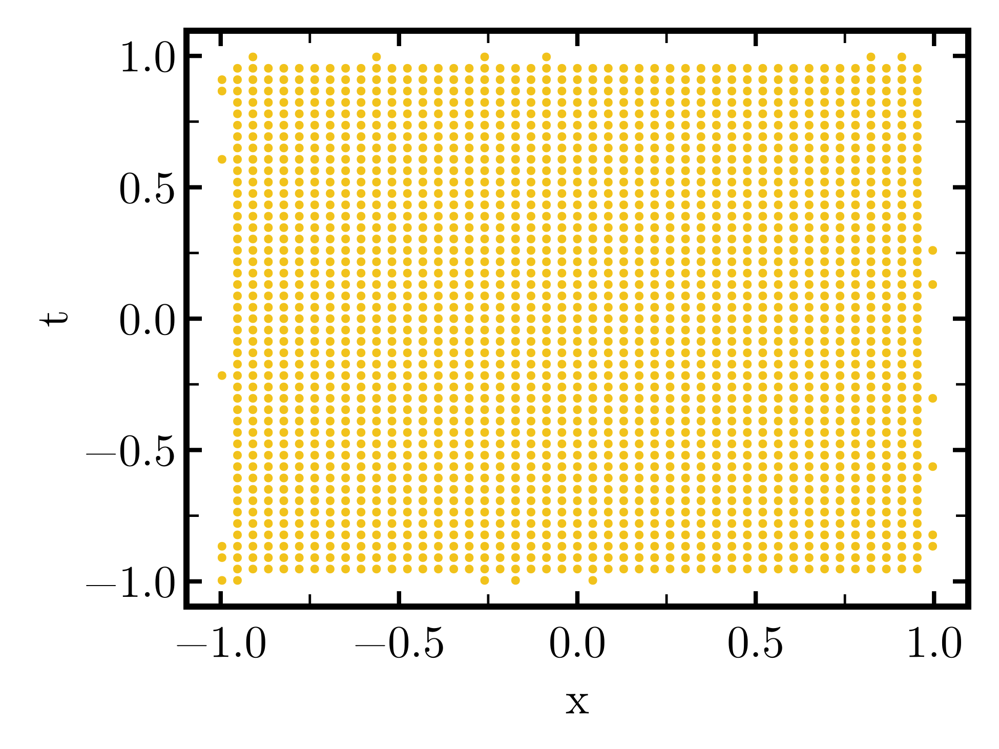

In [34]:
fig, _ = create_grid_and_plot(
    2048, 
    "quadratic",
    0.; 
    magnification=3.,
    fig_path= fig_path("quad_grid_rot_0.pdf")
    )
fig

idx = 1775
f_peak = 0.003945885005636978
P_est = 253.42857142857144
f = 0.08906426155580609  P ≈ 11.227848101265822  A = 0.009431445893608819
f = 0.12401352874859076  P ≈ 8.063636363636364  A = 0.00919196709283386
f = 0.14543404735062007  P ≈ 6.875968992248062  A = 0.009090461600021136
f = 0.09244644870349493  P ≈ 10.817073170731707  A = 0.007600442914345062
f = 0.14656144306651633  P ≈ 6.823076923076924  A = 0.007495764945520482
f = 0.1245772266065389  P ≈ 8.027149321266968  A = 0.007341351533675366
f = 0.1459977452085682  P ≈ 6.8494208494208495  A = 0.007292162492083545
f = 0.09582863585118377  P ≈ 10.435294117647057  A = 0.007227834534572484
f = 0.09131905298759865  P ≈ 10.950617283950617  A = 0.007165579138014485
f = 0.29537767756482525  P ≈ 3.385496183206107  A = 0.006921424566486431
f = 0.2897406989853439  P ≈ 3.45136186770428  A = 0.006884739300916784
f = 0.1488162344983089  P ≈ 6.71969696969697  A = 0.0068077300834143584
f = 0.20969560315670802  P ≈ 4.768817204301075  A = 0.006

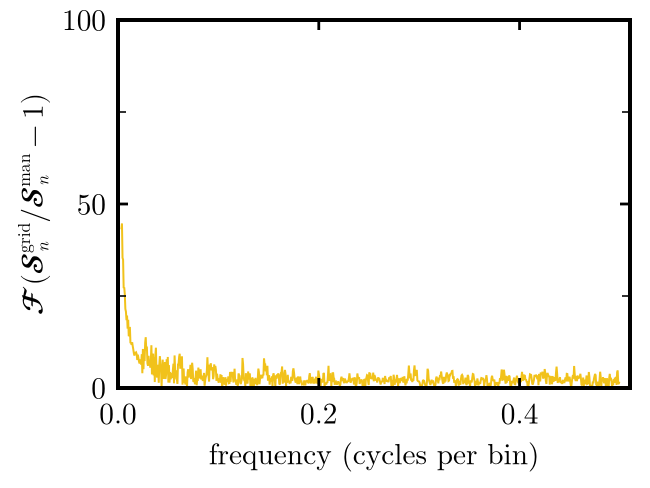

In [29]:
fourier_transform_grid_deviation(
    average_abundance_hists_comp_grid_man, 
    2048, 
    "quadratic"; 
    max_peak_order = 20,
    rotation_angle=0., 
    fig_path= fig_path("comp_quad_grid_man_rot_0.pdf"), 
    magnification = 1,
    ylim = (0.,100.),
    )

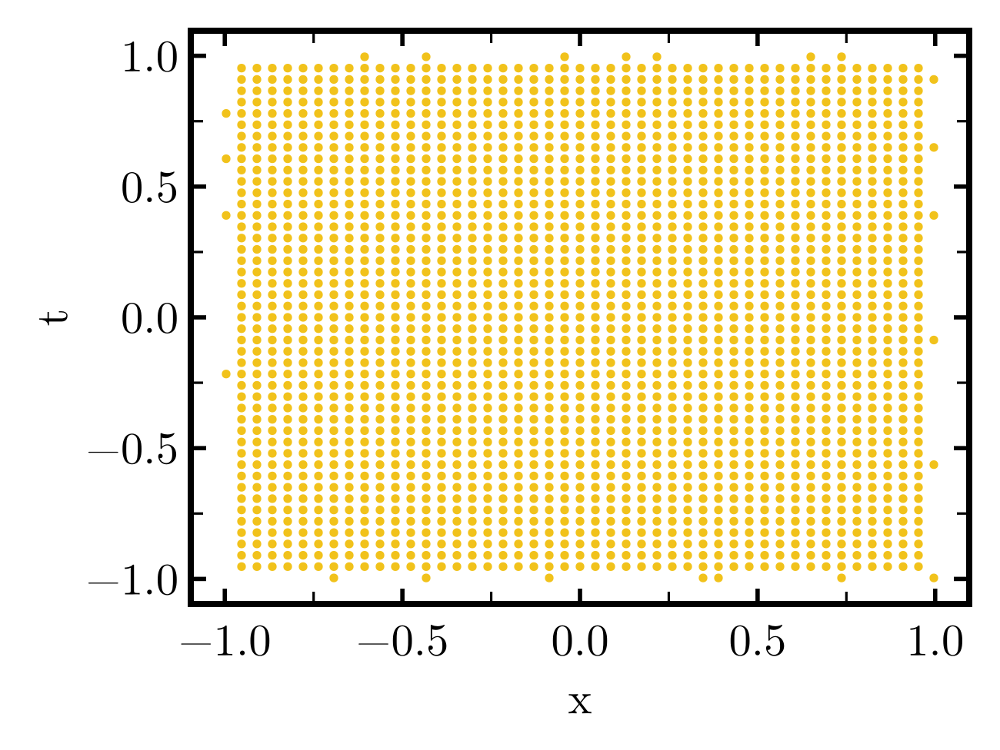

In [25]:
fig, _ = create_grid_and_plot(
    2048, 
    "quadratic",
    1e-12;
    magnification=2.,
    fig_path= fig_path("quad_grid_rot_1e-12.pdf")
    )
fig

idx = 1775
f_peak = 0.49943630214205187
P_est = 2.002257336343115
f = 0.49943630214205187  P ≈ 2.002257336343115  A = 0.14737743128608952
f = 0.24971815107102593  P ≈ 4.00451467268623  A = 0.12661452060050138
f = 0.40022547914317924  P ≈ 2.498591549295775  A = 0.06862434228203305
f = 0.1668545659526494  P ≈ 5.993243243243243  A = 0.06517949852881479
f = 0.3337091319052988  P ≈ 2.9966216216216215  A = 0.05919745738596125
f = 0.12514092446448705  P ≈ 7.990990990990991  A = 0.05864022180163102
f = 0.28579481397970685  P ≈ 3.4990138067061145  A = 0.05527825026040751
f = 0.16629086809470123  P ≈ 6.013559322033899  A = 0.054401858886962584
f = 0.37485907553551295  P ≈ 2.6676691729323307  A = 0.049550655133117245
f = 0.1245772266065389  P ≈ 8.027149321266968  A = 0.0484920978942596
f = 0.22209695603156707  P ≈ 4.50253807106599  A = 0.04180550985905695
f = 0.0834272829763247  P ≈ 11.986486486486486  A = 0.04130568667377357
f = 0.20011273957158962  P ≈ 4.99718309859155  A = 0.040779040391208374

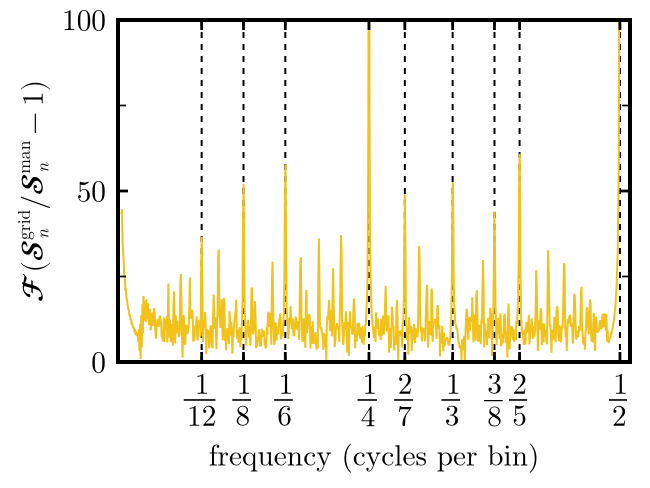

In [28]:
fourier_transform_grid_deviation(
    average_abundance_hists_comp_grid_man, 
    2048, 
    "quadratic"; 
    rotation_angle=1e-12, 
    max_peak_order=20, 
    fig_path= fig_path("comp_quad_grid_man_rot_1e-12.pdf"), 
    xtick_fracs=[1//4,1//2,1//6,2//5, 1//8, 2//7, 1//12, 1//3, 3//8],
    ylim = (0., 100.))

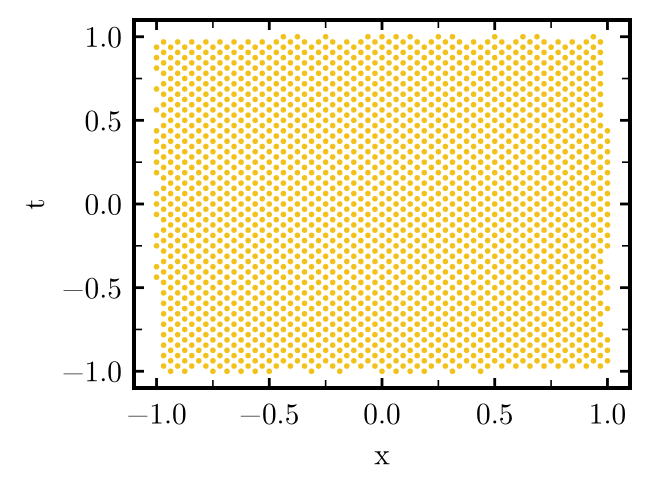

In [15]:
fig, _ = create_grid_and_plot(
    2048, 
    "quadratic",
    45.; 
    magnification = 1.,
    fig_path= fig_path("quad_grid_rot_45.pdf")
    )
fig

idx = 1775
f_peak = 0.0033821871476888386
P_est = 295.6666666666667
f = 0.24971815107102593  P ≈ 4.00451467268623  A = 0.038862924217236396
f = 0.33258173618940245  P ≈ 3.0067796610169495  A = 0.03409445083965018
f = 0.49943630214205187  P ≈ 2.002257336343115  A = 0.031796945827467595
f = 0.40022547914317924  P ≈ 2.498591549295775  A = 0.02235219489101674
f = 0.1668545659526494  P ≈ 5.993243243243243  A = 0.017219442696218827
f = 0.14317925591882752  P ≈ 6.984251968503936  A = 0.016376068467228434
f = 0.16629086809470123  P ≈ 6.013559322033899  A = 0.015558153328268794
f = 0.33032694475760993  P ≈ 3.0273037542662116  A = 0.014640583975799782
f = 0.20067643742953778  P ≈ 4.98314606741573  A = 0.013527253550232377
f = 0.25140924464487036  P ≈ 3.9775784753363226  A = 0.012924541248770096
f = 0.1995490417136415  P ≈ 5.011299435028248  A = 0.012874559755945888
f = 0.12514092446448705  P ≈ 7.990990990990991  A = 0.012853094504281822
f = 0.3359639233370913  P ≈ 2.976510067114094  A = 0.012851

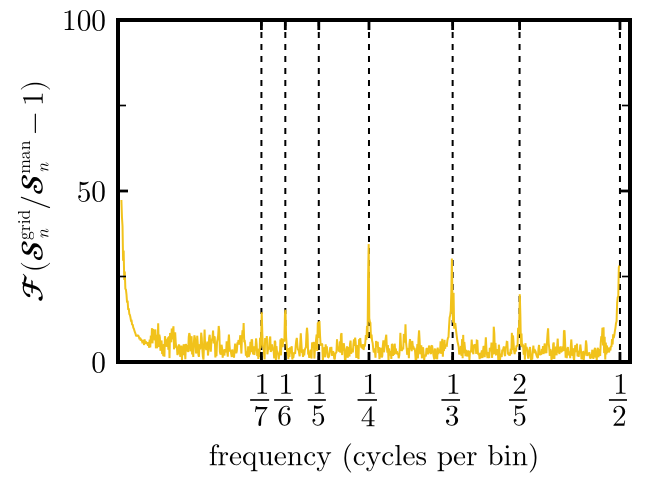

In [27]:

fourier_transform_grid_deviation(
    average_abundance_hists_comp_grid_man, 
    2048, 
    "quadratic"; 
    rotation_angle=45., 
    max_peak_order=20, 
    fig_path= fig_path("comp_quad_grid_man_rot_45.pdf"), 
    xtick_fracs=[1//4,1//2,1//3, 2//5,1//5, 1//6, 1//7],
    ylim = (0., 100.)
    )

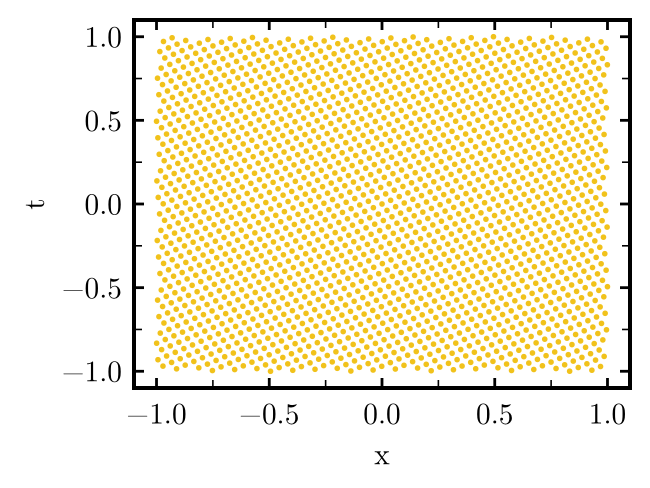

In [13]:
fig, _ = create_grid_and_plot(
    2048, 
    "quadratic",
    30.;
    fig_path= fig_path("quad_grid_rot_30.pdf")
    )
fig

idx = 1775
f_peak = 0.49943630214205187
P_est = 2.002257336343115
f = 0.49943630214205187  P ≈ 2.002257336343115  A = 0.1580852889048437
f = 0.33314543404735064  P ≈ 3.0016920473773263  A = 0.030008430429929567
f = 0.2829763246899662  P ≈ 3.5338645418326693  A = 0.029988988085612248
f = 0.11781285231116122  P ≈ 8.488038277511961  A = 0.02951582502530336
f = 0.2914317925591883  P ≈ 3.4313346228239845  A = 0.02846220339711282
f = 0.21702367531003383  P ≈ 4.607792207792207  A = 0.02791979628250276
f = 0.15107102593010147  P ≈ 6.619402985074627  A = 0.025248211353483745
f = 0.19503945885005636  P ≈ 5.127167630057804  A = 0.02496887711956363
f = 0.43291995490417134  P ≈ 2.3098958333333335  A = 0.024479980911305044
f = 0.2502818489289741  P ≈ 3.9954954954954953  A = 0.02420004778747135
f = 0.32074408117249154  P ≈ 3.117750439367311  A = 0.023683882832660434
f = 0.35851183765501693  P ≈ 2.789308176100629  A = 0.023670608026289713
f = 0.11724915445321307  P ≈ 8.528846153846155  A = 0.023277899

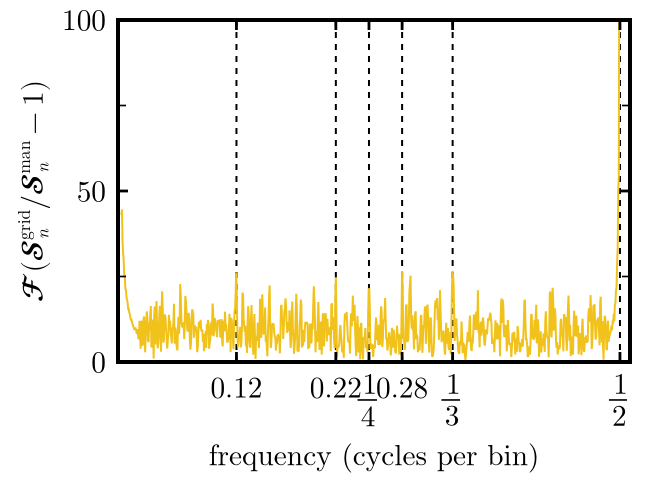

In [26]:
fourier_transform_grid_deviation(
    average_abundance_hists_comp_grid_man, 
    2048, 
    "quadratic"; 
    rotation_angle=30., 
    max_peak_order=20, 
    fig_path = fig_path("comp_quad_grid_man_rot_30.pdf"), 
    xtick_fracs=Any[1//4,1//2,1//3,0.283,.118,.217], 
    ylim = (0., 100.))

### Rectangular

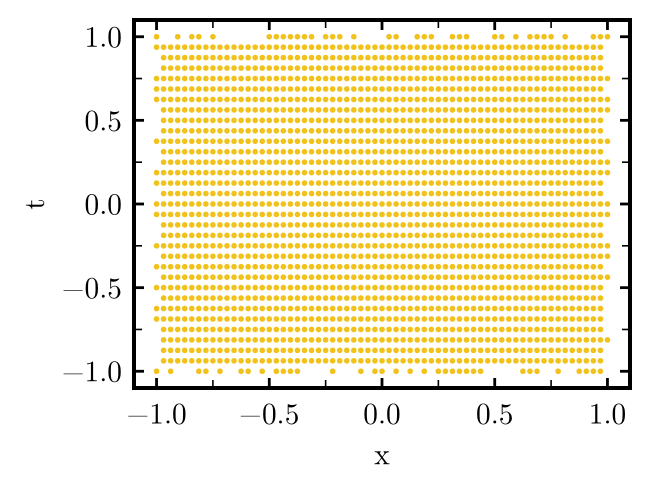

In [8]:

fig, _ = create_grid_and_plot(
    2048, 
    "rectangular",
    0.;
    segment_ratio=2.,
    magnification=1.,
    fig_path=fig_path("quad_grid_rot_0_segrat_1e-12.pdf")
    )
fig

idx = 1775
f_peak = 0.49943630214205187
P_est = 2.002257336343115
f = 0.49943630214205187  P ≈ 2.002257336343115  A = 0.16162136290288417
f = 0.2502818489289741  P ≈ 3.9954954954954953  A = 0.1034482362586126
f = 0.33314543404735064  P ≈ 3.0016920473773263  A = 0.0987687230947118
f = 0.37485907553551295  P ≈ 2.6676691729323307  A = 0.054566212886767704
f = 0.20011273957158962  P ≈ 4.99718309859155  A = 0.05329964859419768
f = 0.12514092446448705  P ≈ 7.990990990990991  A = 0.049900918385177274
f = 0.14261555806087936  P ≈ 7.011857707509882  A = 0.04584416586734409
f = 0.1245772266065389  P ≈ 8.027149321266968  A = 0.04261968410928275
f = 0.12570462232243518  P ≈ 7.955156950672645  A = 0.0390698043800132
f = 0.14317925591882752  P ≈ 6.984251968503936  A = 0.038341806018409766
f = 0.4165727170236753  P ≈ 2.4005412719891743  A = 0.03649715984903224
f = 0.42841037204058624  P ≈ 2.3342105263157893  A = 0.035202138342922844
f = 0.1273957158962796  P ≈ 7.849557522123893  A = 0.035041746563187

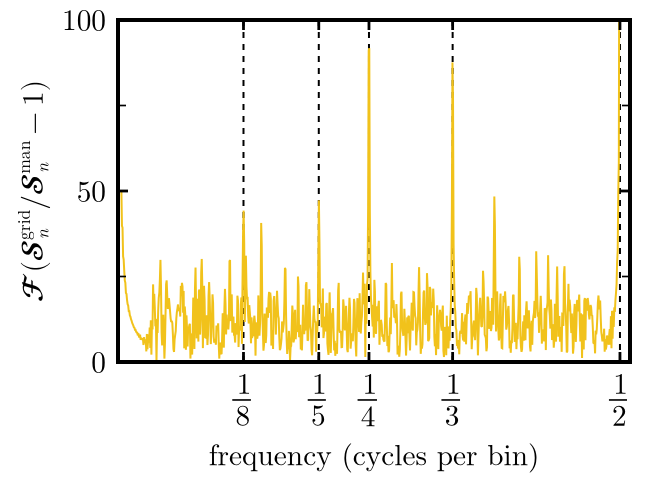

In [37]:
fourier_transform_grid_deviation(
    average_abundance_hists_comp_grid_man, 
    2048, 
    "rectangular"; 
    rotation_angle=0., 
    max_peak_order=20, 
    segment_ratio=2.,
    fig_path = fig_path("comp_rect_grid_man_rot_0_segrat_2.pdf"), 
    xtick_fracs=[1//2,1//4,1//3,1//5,1//8], 
    ylim = (0., 100.),
    )

#### Hexagonal

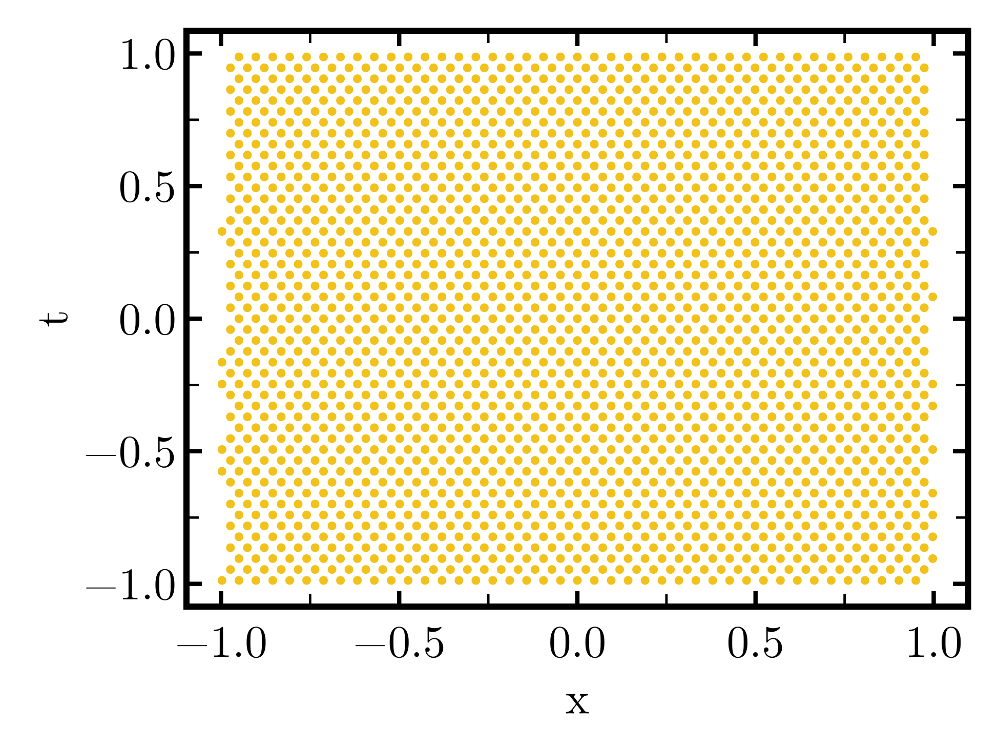

In [35]:

fig, _ = create_grid_and_plot(
    2048, 
    "hexagonal",
    0.;
    segment_ratio=2.,
    fig_path=fig_path("hex_grid_rot_0_segrat_2.pdf"),
    magnification=3.
    )
fig

idx = 1775
f_peak = 0.49943630214205187
P_est = 2.002257336343115
f = 0.49943630214205187  P ≈ 2.002257336343115  A = 0.1541806362602085
f = 0.21138669673055244  P ≈ 4.730666666666666  A = 0.08050861001746173
f = 0.14430665163472378  P ≈ 6.9296875  A = 0.05670845337778637
f = 0.3551296505073281  P ≈ 2.8158730158730156  A = 0.05542262518054242
f = 0.28861330326944756  P ≈ 3.46484375  A = 0.04993271679497178
f = 0.14487034949267194  P ≈ 6.90272373540856  A = 0.04964827290549308
f = 0.4036076662908681  P ≈ 2.4776536312849164  A = 0.04693039922124348
f = 0.21025930101465615  P ≈ 4.7560321715817695  A = 0.04536371240362613
f = 0.0963923337091319  P ≈ 10.374269005847953  A = 0.04391612923836037
f = 0.3765501691093574  P ≈ 2.6556886227544907  A = 0.04335121753878842
f = 0.21645997745208567  P ≈ 4.619791666666667  A = 0.043324746565764814
f = 0.09695603156708005  P ≈ 10.313953488372093  A = 0.04263075567557215
f = 0.32638105975197296  P ≈ 3.063903281519862  A = 0.04076133569659688
f = 0.143742

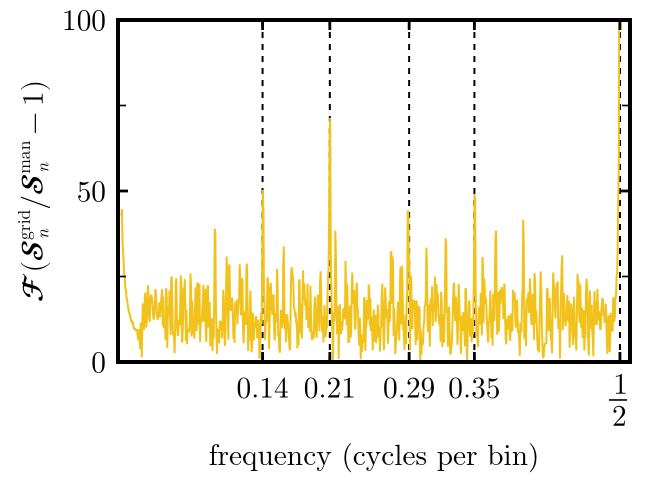

In [38]:

fourier_transform_grid_deviation(
    average_abundance_hists_comp_grid_man, 
    2048, 
    "hexagonal"; 
    rotation_angle=0., 
    max_peak_order=20, 
    segment_ratio=2.,
    fig_path = fig_path("comp_hex_grid_man_rot_0_segrat_2.pdf"), 
    xtick_fracs=Any[1//2, .211, .144, .355, .29], 
    ylim = (0., 100.),
    )

### Fit with period fixed to 4

multistart 1: χ² = 14.664660775175388 (best = 14.664660775175388)
multistart 10: χ² = 79.72040593272202 (best = 14.664660775175388)
multistart 20: χ² = 79.72043188647925 (best = 8.443101246749817)
multistart 30: χ² = 79.7204064411517 (best = 8.443101246749817)
multistart 40: χ² = 79.72040608095308 (best = 8.144792593206422)
multistart 50: χ² = 79.72040589109203 (best = 8.144792593206422)
multistart 60: χ² = 79.72040685216548 (best = 5.89556975994311)
multistart 70: χ² = 79.72040705670702 (best = 5.89556975994311)
multistart 80: χ² = 79.72040600002484 (best = 5.89556975994311)
multistart 90: χ² = 79.72040595959507 (best = 5.89556975994311)
multistart 100: χ² = 16.702599010226567 (best = 5.89556975994311)
multistart done: best χ² = 5.89556975994311
(a0 = 1.1700090681420603, a1 = 0.40029082243119607, ϕ1 = 2.6509710530799913, P1 = 1.9840959366888864, a2 = 0.3156924893303947, ϕ2 = -1.037836956251863, P2 = 2.6621039067583534)
χ²: 5.89556975994311


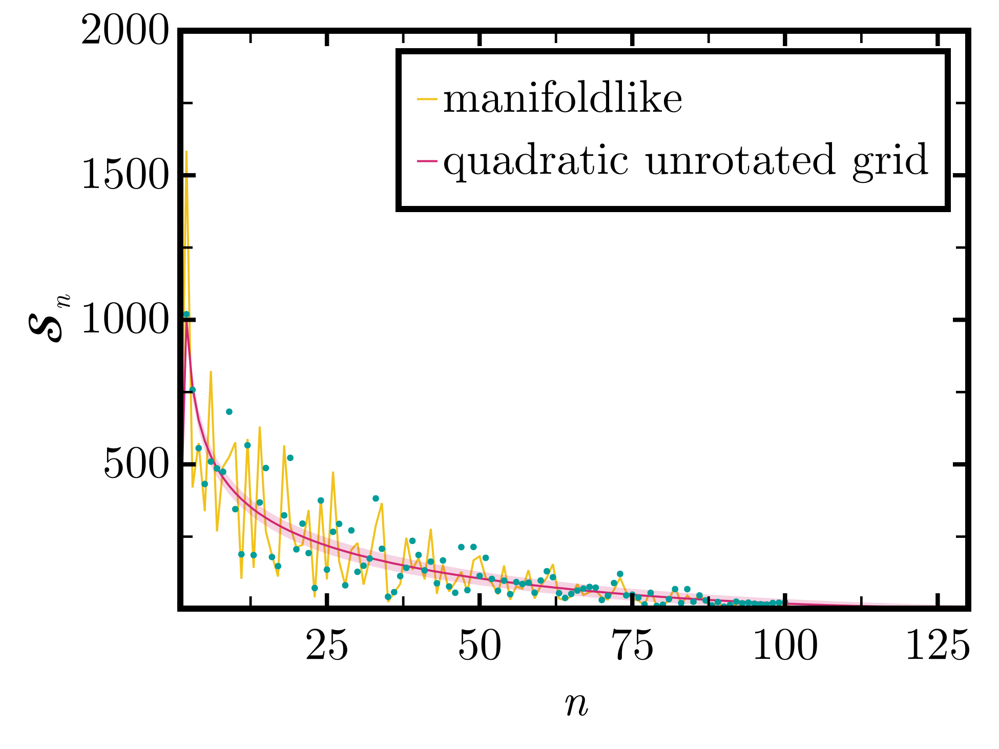

In [ ]:


fit_end = 100
multistart = 100
K = 2

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F(K)
    ex = :(p.a0)
    for i in 1:K
        ai = Symbol("a$i")
        ϕi = Symbol("ϕ$i")
        Pi = Symbol("P$i")
        ex = :($ex +
               p.$ai * cos($(2π*i) * x / p.$Pi + p.$ϕi)
        )
    end
    return :( (x, p) -> $ex )
end

amps = [.8^n for n in 1:K]  # length K
syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("ϕ$i"), Symbol("P$i")), 1:K; init = (:a0,))

vals = Any[1.0]  # a0
for i in 1:K
    push!(vals, amps[i], Float64(π/2), 3.0)  # a_i, ϕ_i, P _i
end

init = NamedTuple{syms}(Tuple(vals))

let F = eval(make_F(K))

    param_syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("ϕ$i"), Symbol("P$i")),
                    1:K; init = (:a0,))


    model = (x, p) -> base[x] * F(x, p)

    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ  # σ scaled by oscillatory factor

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        #rng = MersenneTwister(42322),
        verbose = true,
        method = Optim.BFGS(),
        autodiff = AutoForwardDiff()
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    scatter!(ax, xs, ys[xs] ./ F.(xs, Ref(params));
        color = colorant"#009D9A")

    save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_comp_quad_grid_man_fit.pdf", 
        fig)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    scatter!(ax, xs, base[xs] .* F.(xs, Ref(params));
        color = colorant"#009D9A")

    save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_comp_quad_grid_man_fit_2.pdf", 
        fig)

    fig
end

multistart 1: χ² = 78.02422704044804 (best = 78.02422704044804)
multistart 10: χ² = 78.02417507951941 (best = 6.062032139345865)
multistart 20: χ² = 78.02422704044807 (best = 6.062032139345865)
multistart 30: χ² = 6.062032139345875 (best = 6.062032139345865)
multistart 40: χ² = 78.02422704044805 (best = 6.062032139345865)
multistart 50: χ² = 18.701755966461256 (best = 6.062032139345865)
multistart 60: χ² = 11.098946601705501 (best = 6.0620321393458605)
multistart 70: χ² = 6.062032139345887 (best = 6.0620321393458605)
multistart 80: χ² = 78.02417091966942 (best = 6.0620321393458605)
multistart 90: χ² = 70.42142984067726 (best = 6.062032139345854)
multistart 100: χ² = 78.02422704044807 (best = 6.062032139345854)
multistart done: best χ² = 6.062032139345854
(a0 = 1.1634758708838357, a1 = 0.1935792136201853, b1 = -0.22000393085947753, a2 = -0.3582915253471536, b2 = 0.10044345630081383)
χ²: 6.062032139345854


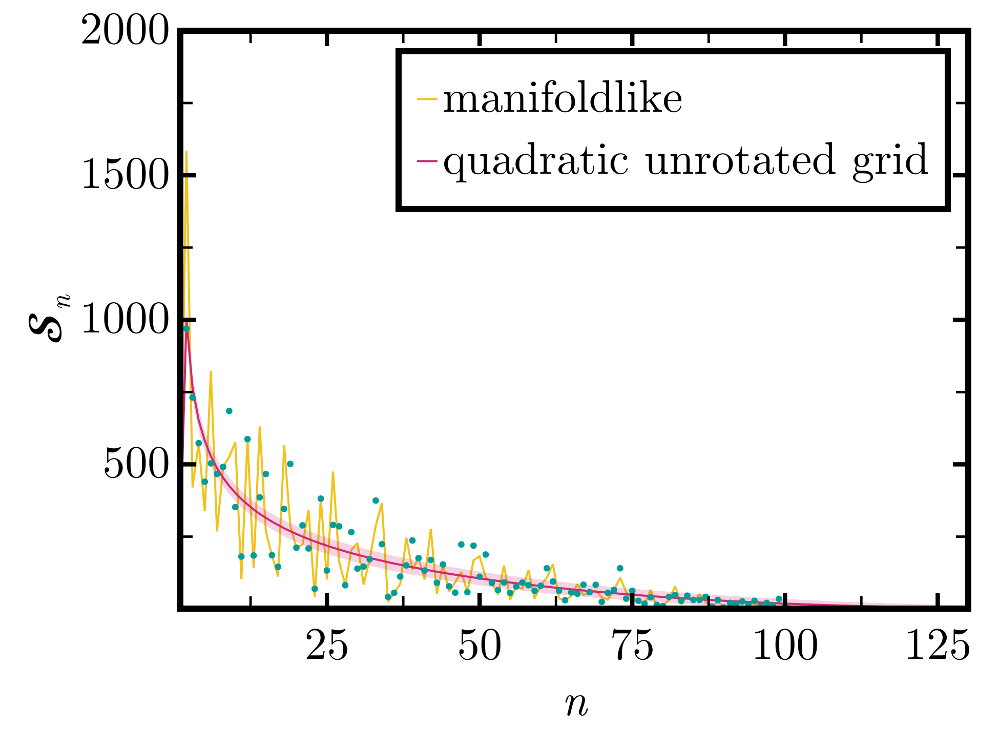

In [ ]:


fit_end = 100
multistart = 100
K = 2

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F(K)
    ex = :(p.a0)
    for i in 1:K
        ai = Symbol("a$i")
        bi = Symbol("b$i")
        ex = :($ex +
               p.$ai * cos($(2π*i) * x / 4) +
               p.$bi * sin($(2π*i) * x / 4))
    end
    return :( (x, p) -> $ex )
end

amps = [.8^n for n in 1:K]  # length K
syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")), 1:K; init = (:a0,))

vals = Any[1.0]  # a0
for i in 1:K
    push!(vals, amps[i], amps[i])  # a_i, b_i
end

init = NamedTuple{syms}(Tuple(vals))

let F = eval(make_F(K))

    param_syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")),
                    1:K; init = (:a0,))


    model = (x, p) -> base[x] * F(x, p)

    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ  # σ scaled by oscillatory factor

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        #rng = MersenneTwister(42322),
        verbose = true,
        method = Optim.BFGS(),
        autodiff = AutoForwardDiff()
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    scatter!(ax, xs, ys[xs] ./ F.(xs, Ref(params));
        color = colorant"#009D9A")

    save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_comp_quad_grid_man_fit.pdf", 
        fig)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    scatter!(ax, xs, base[xs] .* F.(xs, Ref(params));
        color = colorant"#009D9A")

    save("/Users/fabian/Desktop/Local Calculations/git_projects/Causal Sets/data/CausalSetZoology/plots/abundances_comp_quad_grid_man_fit_2.pdf", 
        fig)

    fig
end

### Over-fit

(P = 1.7123775564518717, a0 = 1.2519869127067693, a1 = -0.24036022985267494, b1 = 0.02846704495967053, a2 = 0.16973792006748042, b2 = -0.18786860027345437, a3 = 0.1318880257142514, b3 = 0.3854160447718059, a4 = -0.29854150838064764, b4 = -0.13205730661175372, a5 = 0.08776690810252963, b5 = -0.011183805370843071, a6 = -0.45925313926466965, b6 = -0.09257024489281941)
χ²: 3.833782842246235


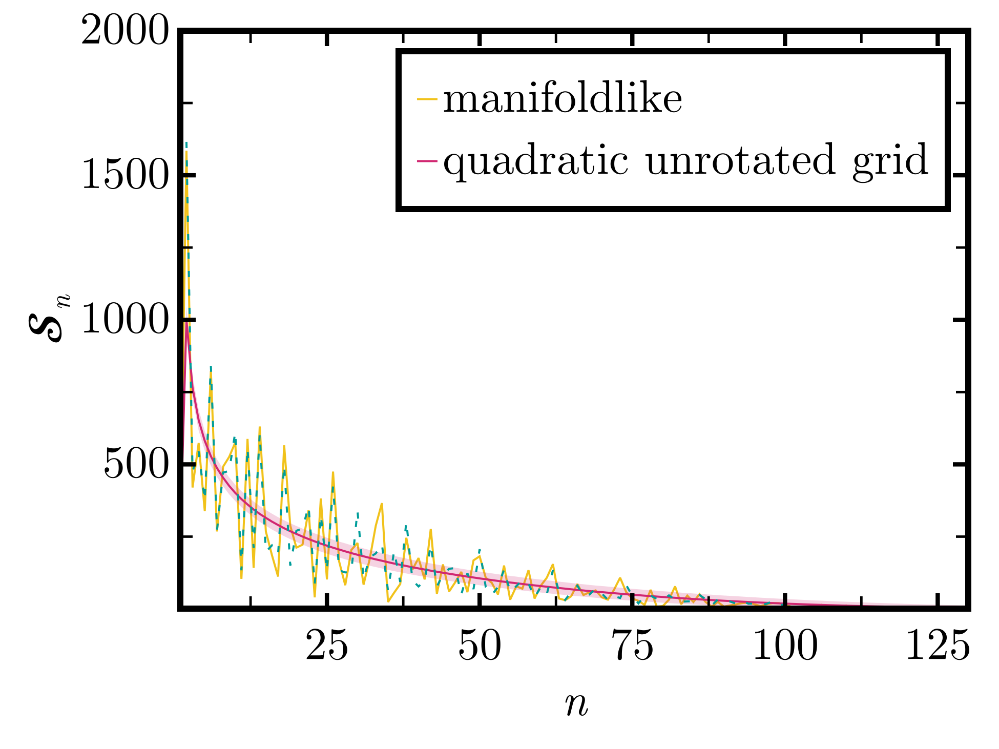

In [ ]:


fit_end = 100
multistart = 100000
K = 6

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F(K)
    ex = :(p.a0)
    for i in 1:K
        ai = Symbol("a$i")
        bi = Symbol("b$i")
        ex = :($ex +
               p.$ai * cos($(2π*i) * x / p.P) +
               p.$bi * sin($(2π*i) * x / p.P))
    end
    return :( (x, p) -> $ex )
end

amps = [.8^n for n in 1:K]  # length K
syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")), 1:K; init = (:a0,))

vals = Any[1.0]  # a0
for i in 1:K
    push!(vals, amps[i], amps[i])  # a_i, b_i
end

init = NamedTuple{(syms..., :P)}((vals..., 3.0))

let F = eval(make_F(K))

    param_syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")),
                    1:K; init = (:P, :a0))


    model = (x, p) -> base[x] * F(x, p)

    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ  # σ scaled by oscillatory factor

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        #rng = MersenneTwister(42322),
        verbose = false,
        method = Optim.BFGS(),
        autodiff = AutoForwardDiff()
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    lines!(ax, xs, ys[xs] ./ F.(xs, Ref(params));
        color = colorant"#009D9A", linestyle = (:dash, :loose), linewidth = 2)
    fig
end

(P = 0.1445641740679614, a0 = 1.2372989010671924, a1 = 0.0677700800898942, b1 = -0.054192760241445946, a2 = 0.06856740209983403, b2 = 0.27929439235244846, a3 = 0.11902123384943317, b3 = 0.3441634836078867, a4 = -0.30124303504215294, b4 = 0.07565806826003933, a5 = -0.06331137475546321, b5 = 0.03748698207000354, a6 = -0.40586087982087454, b6 = -0.21941462568884768, a7 = -0.19514376127044752, b7 = 0.003687543569764806)
χ²: 3.7968433833699327


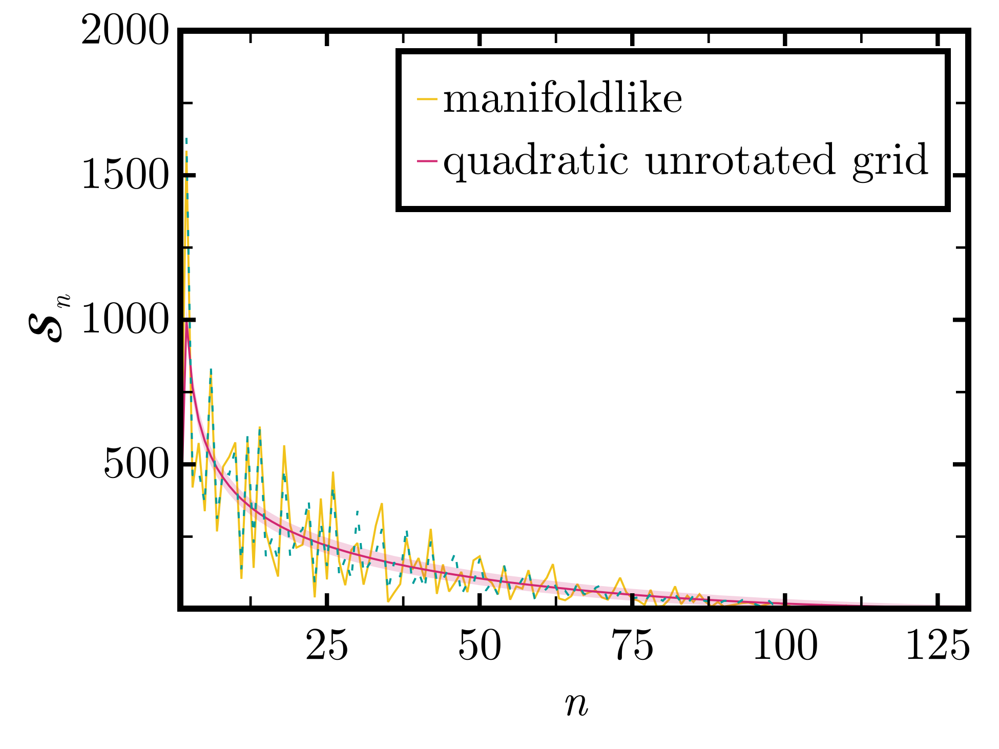

In [ ]:


fit_end = 100
multistart = 100000
K = 7

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F(K)
    ex = :(p.a0)
    for i in 1:K
        ai = Symbol("a$i")
        bi = Symbol("b$i")
        ex = :($ex +
               p.$ai * cos($(2π*i) * x / p.P) +
               p.$bi * sin($(2π*i) * x / p.P))
    end
    return :( (x, p) -> $ex )
end

amps = [.8^n for n in 1:K]  # length K
syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")), 1:K; init = (:a0,))

vals = Any[1.0]  # a0
for i in 1:K
    push!(vals, amps[i], amps[i])  # a_i, b_i
end

init = NamedTuple{(syms..., :P)}((vals..., 3.0))

let F = eval(make_F(K))

    param_syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")),
                    1:K; init = (:P, :a0))


    model = (x, p) -> base[x] * F(x, p)

    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ  # σ scaled by oscillatory factor

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        #rng = MersenneTwister(42322),
        verbose = false,
        method = Optim.BFGS(),
        autodiff = AutoForwardDiff()
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    lines!(ax, xs, ys[xs] ./ F.(xs, Ref(params));
        color = colorant"#009D9A", linestyle = (:dash, :loose), linewidth = 2)
    fig
end

(P = 1.0901042331063255, a0 = 1.277559584160248, a1 = 0.15943763262624427, b1 = 0.018789086634906155, a2 = 0.16304220169622574, b2 = 0.3249120771295429, a3 = 0.11234178812416752, b3 = 0.4158226284748759, a4 = -0.21393848545402522, b4 = 0.10451884994428498, a5 = -0.22863674409625928, b5 = 0.043756023894213694, a6 = -0.4672551503863221, b6 = -0.17499582217802687, a7 = -0.13274314047682956, b7 = 0.007857521956772069, a8 = -0.16292648793107906, b8 = -0.1222290367924614)
χ²: 3.5342466111619304


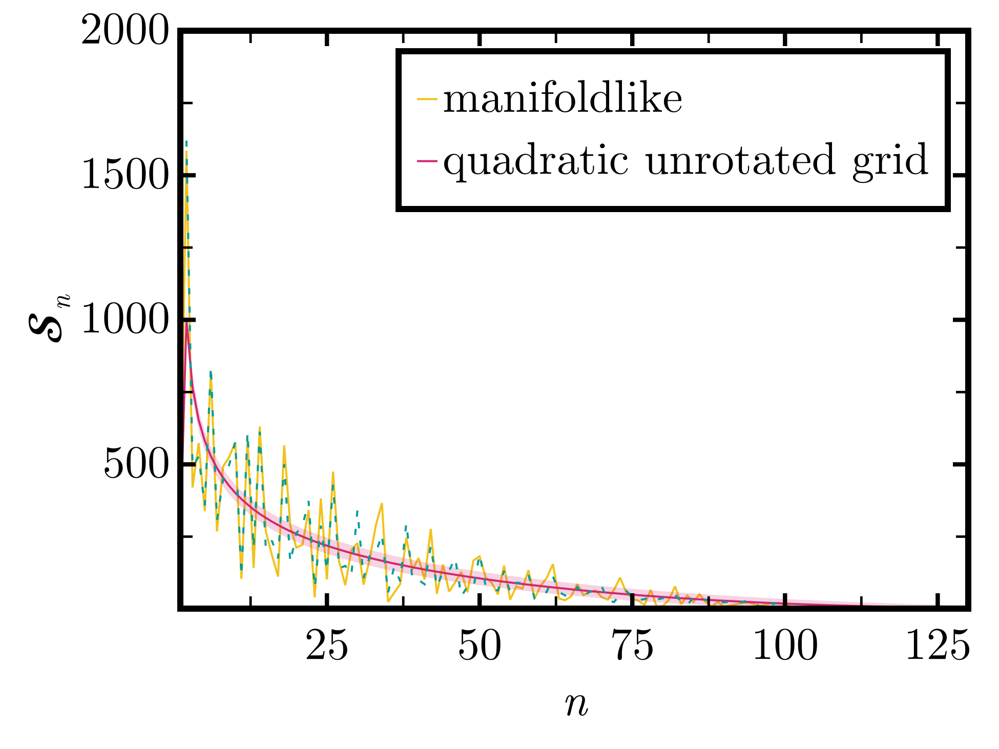

In [ ]:


fit_end = 100
multistart = 100000
K = 8

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F(K)
    ex = :(p.a0)
    for i in 1:K
        ai = Symbol("a$i")
        bi = Symbol("b$i")
        ex = :($ex +
               p.$ai * cos($(2π*i) * x / p.P) +
               p.$bi * sin($(2π*i) * x / p.P))
    end
    return :( (x, p) -> $ex )
end

amps = [.8^n for n in 1:K]  # length K
syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")), 1:K; init = (:a0,))

vals = Any[1.0]  # a0
for i in 1:K
    push!(vals, amps[i], amps[i])  # a_i, b_i
end

init = NamedTuple{(syms..., :P)}((vals..., 3.0))

let F = eval(make_F(K))

    param_syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")),
                    1:K; init = (:P, :a0))


    model = (x, p) -> base[x] * F(x, p)

    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ  # σ scaled by oscillatory factor

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        #rng = MersenneTwister(42322),
        verbose = false,
        method = Optim.BFGS(),
        autodiff = AutoForwardDiff()
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    lines!(ax, xs, ys[xs] ./ F.(xs, Ref(params));
        color = colorant"#009D9A", linestyle = (:dash, :loose), linewidth = 2)
    fig
end

(P = 0.34278539786029755, a0 = 1.2549334693057912, a1 = 0.12109203835438184, b1 = -0.022475541905830582, a2 = 0.1517036044148302, b2 = 0.2797964539794187, a3 = 0.12866287752259065, b3 = 0.39207008076904293, a4 = -0.1713572369937209, b4 = 0.09891440399674085, a5 = -0.22242915046353026, b5 = 0.05270848413245686, a6 = -0.4744405266210547, b6 = -0.06452102350696293, a7 = -0.11122927147715846, b7 = 0.05658366091608903, a8 = -0.19747322782869883, b8 = -0.09429448494017006, a9 = -0.03631410664705792, b9 = 0.05985320241188409)
χ²: 3.583157003870376


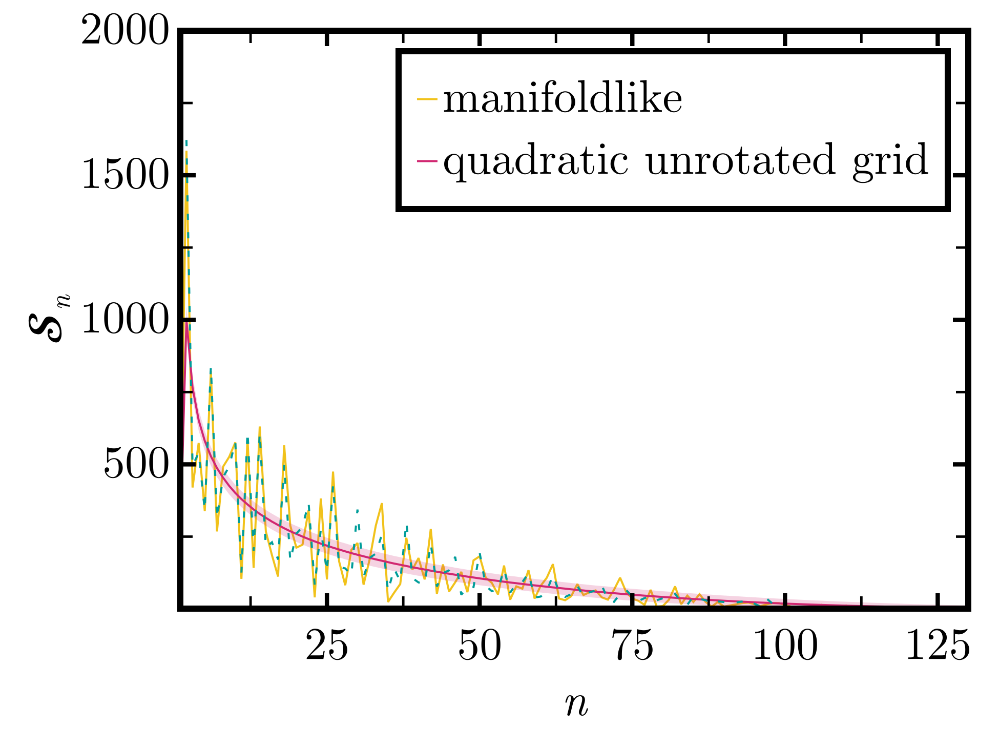

In [ ]:


fit_end = 100
multistart = 100000
K = 9

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F(K)
    ex = :(p.a0)
    for i in 1:K
        ai = Symbol("a$i")
        bi = Symbol("b$i")
        ex = :($ex +
               p.$ai * cos($(2π*i) * x / p.P) +
               p.$bi * sin($(2π*i) * x / p.P))
    end
    return :( (x, p) -> $ex )
end

amps = [.8^n for n in 1:K]  # length K
syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")), 1:K; init = (:a0,))

vals = Any[1.0]  # a0
for i in 1:K
    push!(vals, amps[i], amps[i])  # a_i, b_i
end

init = NamedTuple{(syms..., :P)}((vals..., 3.0))

let F = eval(make_F(K))

    param_syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")),
                    1:K; init = (:P, :a0))


    model = (x, p) -> base[x] * F(x, p)

    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ  # σ scaled by oscillatory factor

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        #rng = MersenneTwister(42322),
        verbose = false,
        method = Optim.BFGS(),
        autodiff = AutoForwardDiff()
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    lines!(ax, xs, ys[xs] ./ F.(xs, Ref(params));
        color = colorant"#009D9A", linestyle = (:dash, :loose), linewidth = 2)
    fig
end

(P = 1.1759412603119574, a0 = 1.2346336685772232, a1 = -0.2504613228168176, b1 = 0.04026069871024798, a2 = 0.18172158346331546, b2 = -0.029141292627052014, a3 = 0.04932256096982068, b3 = -0.14472688327983851, a4 = 4.73755860850263e-5, b4 = 0.2580295094124979, a5 = 0.3002037262596935, b5 = -0.0853224411548443, a6 = -0.1371686641539832, b6 = 0.03171890507573843, a7 = 0.056022185656738686, b7 = -0.021122048210354256, a8 = 0.030826824887094248, b8 = -0.215516556111872, a9 = 0.004139755095031991, b9 = 0.2813584294672528, a10 = -0.28785401653204806, b10 = -0.3061184641752679)
χ²: 3.571338209497656


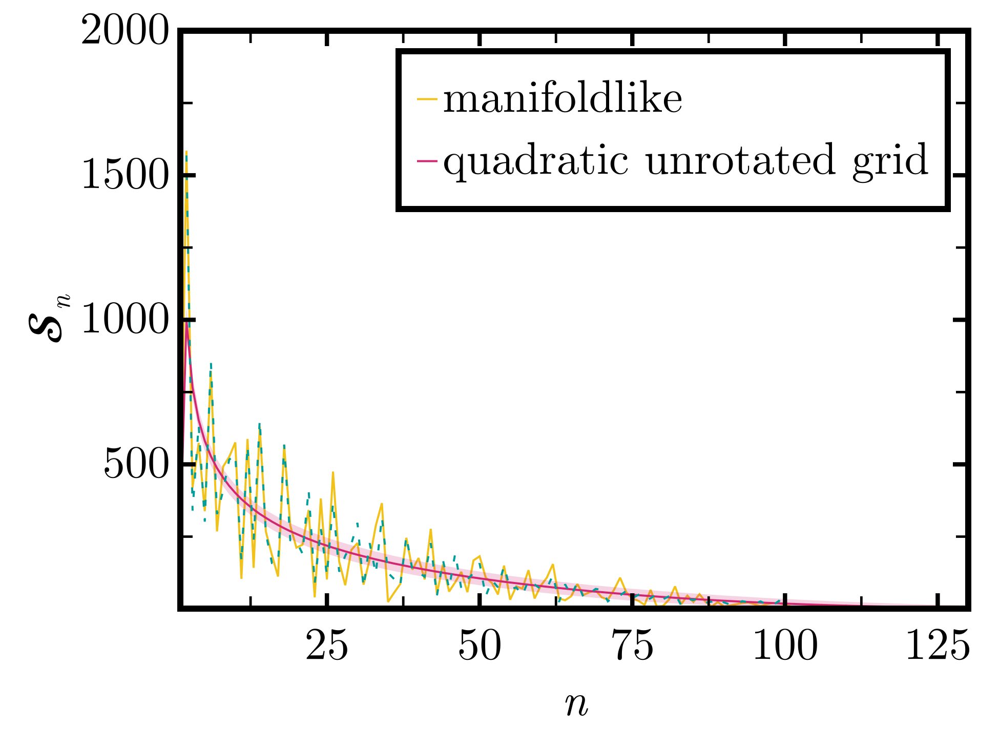

In [ ]:


fit_end = 100
multistart = 100000
K = 10

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F(K)
    ex = :(p.a0)
    for i in 1:K
        ai = Symbol("a$i")
        bi = Symbol("b$i")
        ex = :($ex +
               p.$ai * cos($(2π*i) * x / p.P) +
               p.$bi * sin($(2π*i) * x / p.P))
    end
    return :( (x, p) -> $ex )
end

amps = [.8^n for n in 1:K]  # length K
syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")), 1:K; init = (:a0,))

vals = Any[1.0]  # a0
for i in 1:K
    push!(vals, amps[i], amps[i])  # a_i, b_i
end

init = NamedTuple{(syms..., :P)}((vals..., 3.0))

let F = eval(make_F(K))

    param_syms = foldl((acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i")),
                    1:K; init = (:P, :a0))


    model = (x, p) -> base[x] * F(x, p)

    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ  # σ scaled by oscillatory factor

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        #rng = MersenneTwister(42322),
        verbose = false,
        method = Optim.BFGS(),
        autodiff = AutoForwardDiff()
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    lines!(ax, xs, ys[xs] ./ F.(xs, Ref(params));
        color = colorant"#009D9A", linestyle = (:dash, :loose), linewidth = 2)
    fig
end

### Nonlinear fit

multistart 1: χ² = 9.59223765190351 (best = 9.59223765190351)
multistart 100: χ² = 16.361688563451338 (best = 8.757648468735056)
multistart 200: χ² = 16.553989445799374 (best = 5.895569996328309)
multistart 300: χ² = 79.62057846061113 (best = 5.895569996328309)
multistart 400: χ² = 16.12401595447313 (best = 5.895569996328309)
multistart 500: χ² = 15.041090203972006 (best = 5.895569996328309)
multistart 600: χ² = 16.639772389920303 (best = 5.895569996328309)
multistart 700: χ² = 63.69020987314743 (best = 5.895569996328309)
multistart 800: χ² = 76.0690935351885 (best = 5.895569996328309)
multistart 900: χ² = 15.98376369944405 (best = 5.895569760035072)
multistart 1000: χ² = 14.860212117354038 (best = 5.895569760035072)
multistart done: best χ² = 5.895569760035072
(c = 1.1700098950124804, a1 = 0.1603975275198034, b1 = -0.27191046569911664, P1 = 4.020673831889423, a2 = -0.35307378736791384, b2 = 0.18860827923948303, P2 = 2.0161610963387955)
χ²: 5.895569760035072


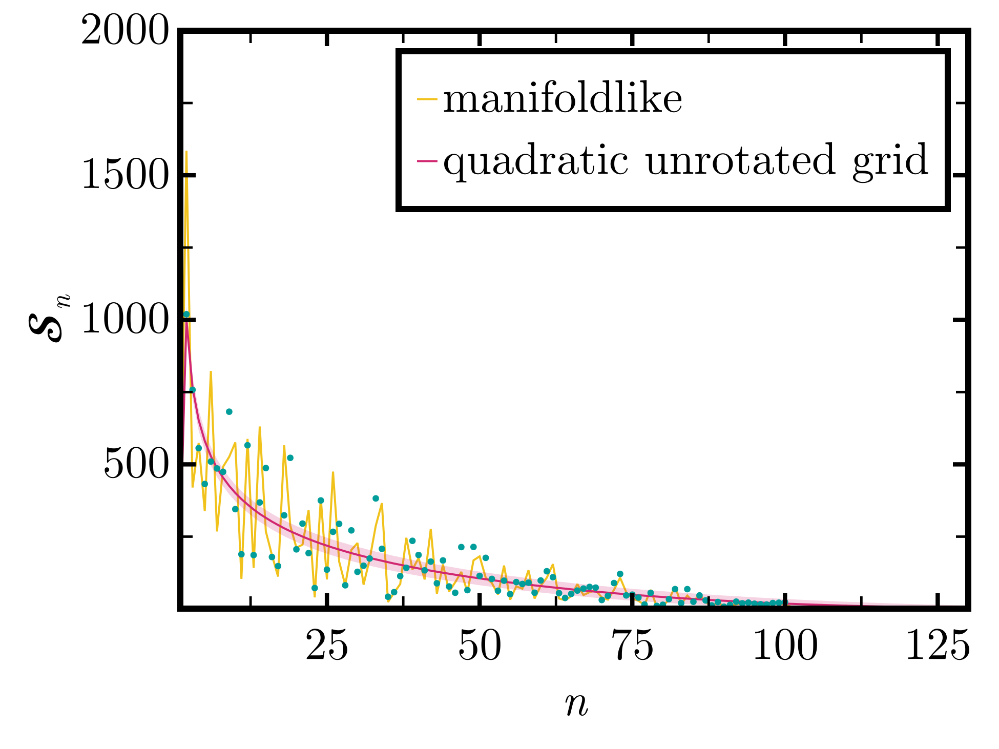

In [ ]:


fit_end = 100
multistart = 1000
K = 2

xs = collect(2:fit_end)
base = average_std_plot_data_comp_quad_grid_man[1][1]
ys = average_std_plot_data_comp_quad_grid_man[2][1]
σs = average_std_plot_data_comp_quad_grid_man[2][2]

function make_F_freeP(K)
    ex = :(p.c)
    for i in 1:K
        ai = Symbol("a$i")
        bi = Symbol("b$i")
        Pi = Symbol("P$i")
        ex = :($ex +
               p.$ai * cos(2π * x / p.$Pi) +
               p.$bi * sin(2π * x / p.$Pi))
    end
    return :( (x, p) -> $ex )
end

param_syms = foldl(
    (acc, i) -> (acc..., Symbol("a$i"), Symbol("b$i"), Symbol("P$i")),
    1:K; init = (:c,)
)

amps = [0.3 / i for i in 1:K]
periods = [4.0 * i for i in 1:K]

vals = Any[1.0]  # c
for i in 1:K
    push!(vals, amps[i], amps[i], periods[i])
end
init = NamedTuple{param_syms}(Tuple(vals))

# bounds: c, a_i, b_i free; P_i in [2, 20]
lo_vals = Any[-Inf]
hi_vals = Any[Inf]
for i in 1:K
    push!(lo_vals, -Inf, -Inf, 2.0)   # a_i, b_i, P_i
    push!(hi_vals,  Inf,  Inf, 20.0)
end
bounds = (NamedTuple{param_syms}(Tuple(lo_vals)),
          NamedTuple{param_syms}(Tuple(hi_vals)))

let F = eval(make_F_freeP(K))
    model = (x, p) -> base[x] * F(x, p)
    std_fn = (ys, preds, σ, p) -> abs.(F.(xs, Ref(p))) .* σ

    params, res, χ² = fit_histogram_bins(
        ys,
        model,
        param_syms,
        2,
        fit_end;
        stds = σs,
        std_fn = std_fn,
        init = init,
        bounds = bounds,
        minimize_χ² = true,
        goodness_of_fit = true,
        multistart = multistart,
        verbose = true,
        method = Optim.NelderMead(),
    )

    println(params)
    println("χ²: ", χ²)

    fig, ax = plot_mean_histograms_with_std(
        average_std_plot_data_comp_quad_grid_man;
        logscale_x = false,
        logscale_y = false,
        xlim = (1., 130.),
        ylim = (1.e0, 2000.),
        xlabel = L"n",
        ylabel = L"\mathcal{S}_n",
        hist_labels = ["manifoldlike", "quadratic unrotated grid"],
        magnification = 3,
        legendpos = :rt,
        legendmargin = (20,20,20,20),
        linewidth = 2,
        return_axis = true,
    )

    scatter!(ax, xs, base[xs] .* F.(xs, Ref(params));
           color = colorant"#009D9A")
    fig
end



## Graph observables

In [ ]:
data_paths_grid = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ? 
["/Users/fabianwagner/Desktop/git_projects/Causal sets/data/grid_256_10000/statistics.jld2", 
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2"] :
["/Volumes/Causal Set Silo/causal_sets/analysis/grid_256_10000/statistics.jl",
"/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2"]
in_degree_hists_grid         = load_histograms_from_paths(data_paths_grid, :in_degree_hist)
out_degree_hists_grid        = load_histograms_from_paths(data_paths_grid, :out_degree_hist)
ev_in_hists_grid             = load_histograms_from_paths(data_paths_grid, :ev_in_hist)
ev_out_hists_grid            = load_histograms_from_paths(data_paths_grid, :ev_out_hist)
connectivity_hists_grid      = join_histograms([in_degree_hists_grid,out_degree_hists_grid])
in_degree_link_hists_grid    = load_histograms_from_paths(data_paths_grid, :in_degree_hist_link)
out_degree_link_hists_grid   = load_histograms_from_paths(data_paths_grid, :out_degree_hist_link)
ev_in_link_hists_grid        = load_histograms_from_paths(data_paths_grid, :ev_in_hist_link)
ev_out_link_hists_grid       = load_histograms_from_paths(data_paths_grid, :ev_out_hist_link)
connectivity_link_hists_grid = join_histograms([in_degree_link_hists_grid,out_degree_link_hists_grid])
max_pathlen_hists_grid      = load_histograms_from_paths(data_paths_grid, :max_pathlen_hist)

  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_sprinkling_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 10000 histograms from /Users/fa

2-element Vector{Vector{Dict}}:
 [Dict(22.0 => 1, 20.0 => 1, 30.0 => 1, 28.0 => 1), Dict(22.0 => 1, 29.0 => 2, 24.0 => 1, 30.0 => 1), Dict(15.0 => 1, 25.0 => 1, 27.0 => 2, 24.0 => 1, 28.0 => 1, 19.0 => 1), Dict(29.0 => 1, 31.0 => 1, 24.0 => 1, 30.0 => 1), Dict(25.0 => 1, 30.0 => 1, 28.0 => 1, 14.0 => 1), Dict(22.0 => 1, 25.0 => 1, 31.0 => 2, 19.0 => 1), Dict(15.0 => 1, 29.0 => 1, 27.0 => 1, 26.0 => 1, 23.0 => 1, 19.0 => 1), Dict(29.0 => 1, 26.0 => 1, 31.0 => 1, 23.0 => 1, 19.0 => 1), Dict(22.0 => 1, 32.0 => 1, 30.0 => 2, 28.0 => 1), Dict(32.0 => 2, 31.0 => 1, 19.0 => 1)  …  Dict(25.0 => 2, 28.0 => 3), Dict(29.0 => 1, 26.0 => 2, 28.0 => 2, 23.0 => 1), Dict(30.0 => 3, 28.0 => 1, 19.0 => 1), Dict(25.0 => 1, 10.0 => 1, 27.0 => 1, 30.0 => 2), Dict(10.0 => 1, 31.0 => 3, 24.0 => 1, 23.0 => 1), Dict(29.0 => 1, 24.0 => 1, 28.0 => 1, 23.0 => 1), Dict(29.0 => 1, 31.0 => 1, 14.0 => 1, 23.0 => 1), Dict(22.0 => 1, 29.0 => 1, 10.0 => 1, 28.0 => 1), Dict(22.0 => 1, 29.0 => 1, 30.0 => 1), Dict(21.0 => 

In [116]:
cset_size_grid = 256
normalized_in_degree_hists_grid         = normalize_hists(in_degree_hists_grid)
normalized_out_degree_hists_grid        = normalize_hists(out_degree_hists_grid)
normalized_ev_in_hists_grid             = normalize_hists(ev_in_hists_grid; normalization = cset_size_grid)
normalized_ev_out_hists_grid            = normalize_hists(ev_out_hists_grid; normalization = cset_size_grid)
normalized_connectivity_hists_grid      = normalize_hists(connectivity_hists_grid)
normalized_in_degree_link_hists_grid    = normalize_hists(in_degree_link_hists_grid)
normalized_out_degree_link_hists_grid   = normalize_hists(out_degree_link_hists_grid)
normalized_ev_in_link_hists_grid        = normalize_hists(ev_in_link_hists_grid; normalization = cset_size_grid)
normalized_ev_out_link_hists_grid       = normalize_hists(ev_out_link_hists_grid; normalization = cset_size_grid)
normalized_connectivity_link_hists_grid = normalize_hists(connectivity_link_hists_grid)
normalized_max_pathlen_hists_grid       = normalize_hists(max_pathlen_hists_grid; normalization = 1)

2-element Vector{Vector{Dict{Int64, Float64}}}:
 [Dict(22 => 1.0, 20 => 1.0, 30 => 1.0, 28 => 1.0), Dict(22 => 1.0, 29 => 2.0, 24 => 1.0, 30 => 1.0), Dict(15 => 1.0, 25 => 1.0, 27 => 2.0, 24 => 1.0, 28 => 1.0, 19 => 1.0), Dict(29 => 1.0, 31 => 1.0, 24 => 1.0, 30 => 1.0), Dict(25 => 1.0, 30 => 1.0, 28 => 1.0, 14 => 1.0), Dict(22 => 1.0, 25 => 1.0, 31 => 2.0, 19 => 1.0), Dict(15 => 1.0, 29 => 1.0, 27 => 1.0, 26 => 1.0, 23 => 1.0, 19 => 1.0), Dict(29 => 1.0, 26 => 1.0, 31 => 1.0, 23 => 1.0, 19 => 1.0), Dict(22 => 1.0, 32 => 1.0, 30 => 2.0, 28 => 1.0), Dict(32 => 2.0, 31 => 1.0, 19 => 1.0)  …  Dict(25 => 2.0, 28 => 3.0), Dict(29 => 1.0, 26 => 2.0, 28 => 2.0, 23 => 1.0), Dict(30 => 3.0, 28 => 1.0, 19 => 1.0), Dict(25 => 1.0, 10 => 1.0, 27 => 1.0, 30 => 2.0), Dict(10 => 1.0, 31 => 3.0, 24 => 1.0, 23 => 1.0), Dict(29 => 1.0, 24 => 1.0, 28 => 1.0, 23 => 1.0), Dict(29 => 1.0, 31 => 1.0, 14 => 1.0, 23 => 1.0), Dict(22 => 1.0, 29 => 1.0, 10 => 1.0, 28 => 1.0), Dict(22 => 1.0, 29 => 1.0, 30 => 1.0

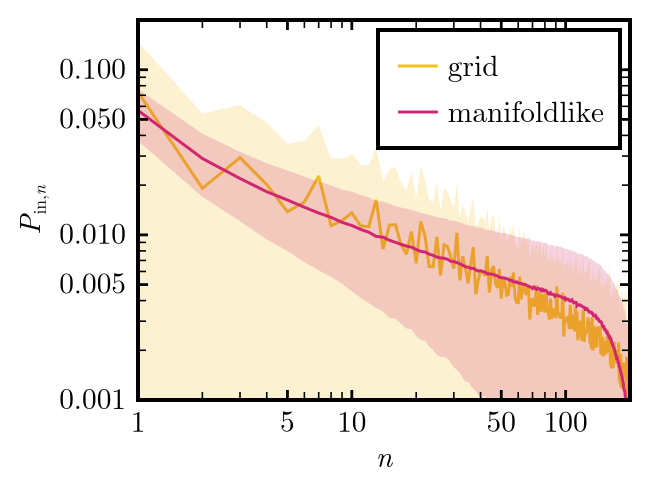

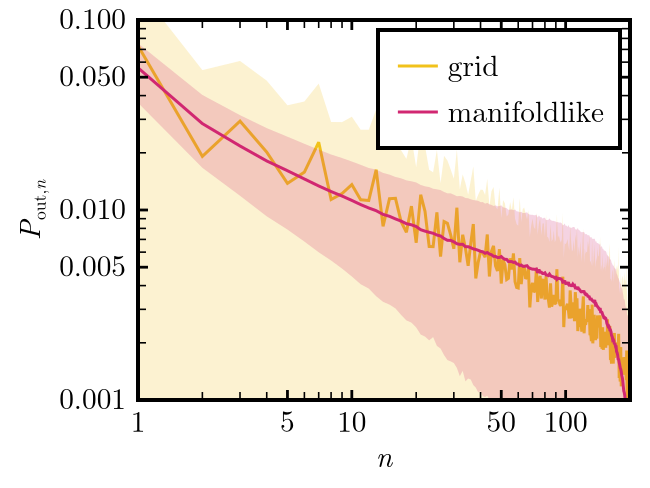

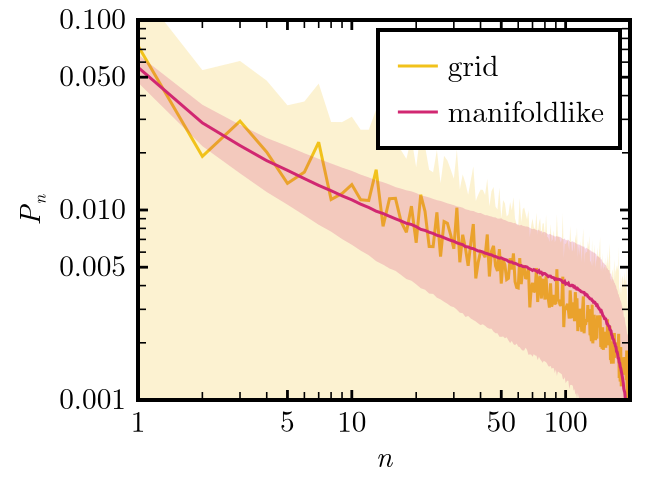

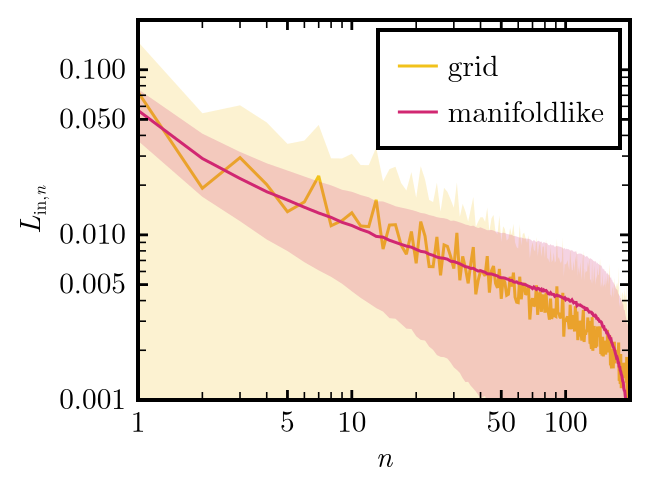

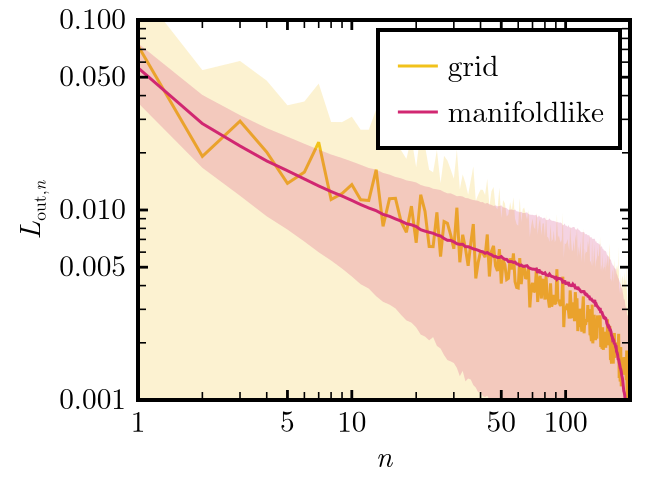

...

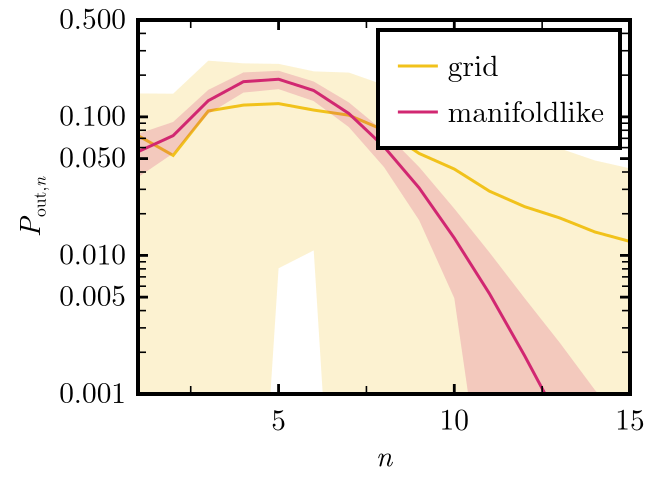

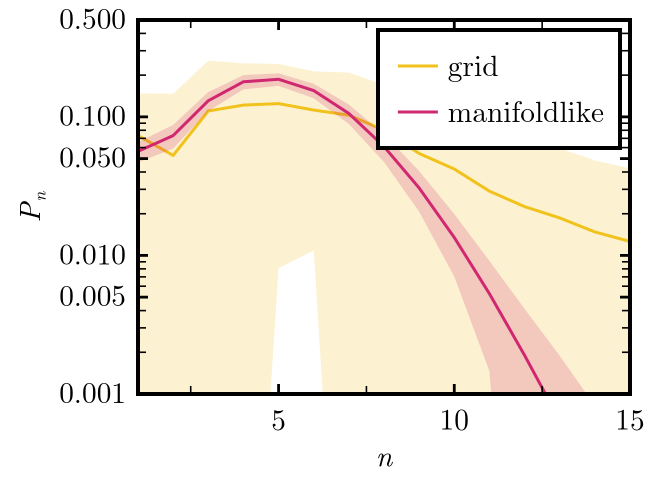

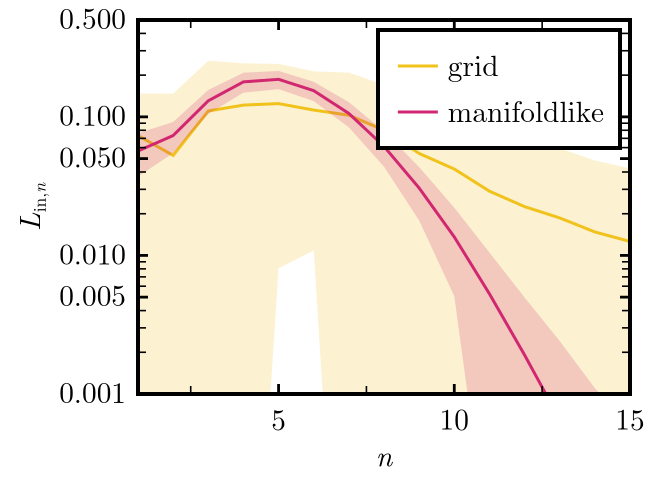

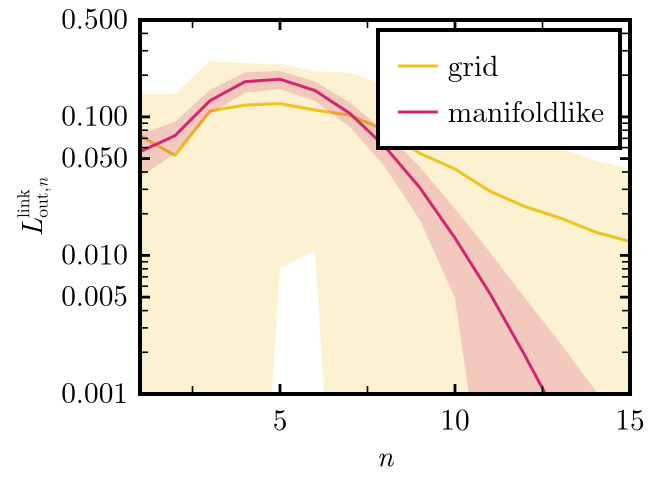

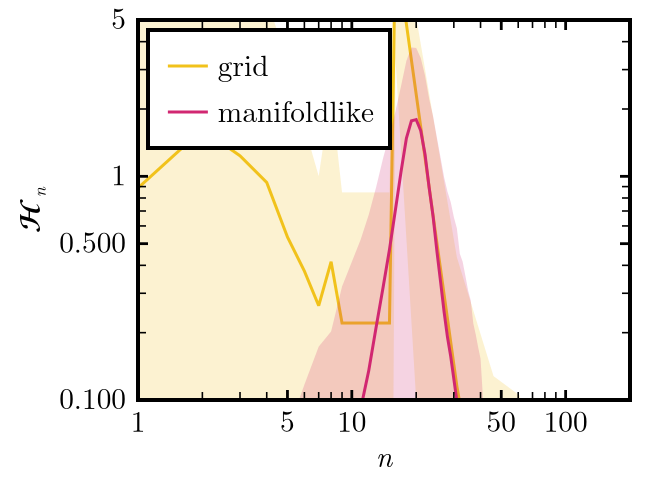

In [120]:
foreach(
    display,
    [
    plot_and_save_hists(
        normalized_in_degree_hists_grid,
        "grid_man/in_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["grid", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_out_degree_hists_grid,
        "grid_man/out_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["grid", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_connectivity_hists_grid,
        "grid_man/connectivity.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["grid", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_ev_in_hists_grid,
        "grid_man/ev_in.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["grid", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_ev_out_hists_grid,
        "grid_man/ev_out.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{out}, n}",
        hist_labels = ["grid", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_in_degree_link_hists_grid,
        "grid_man/in_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["grid", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_out_degree_link_hists_grid,
        "grid_man/out_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["grid", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_connectivity_link_hists_grid,
        "grid_man/connectivity_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["grid", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_in_link_hists_grid,
        "grid_man/ev_in_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["grid", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_out_link_hists_grid,
        "grid_man/ev_out_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L^{\mathrm{link}}_{\mathrm{out},n}",
        hist_labels = ["grid", "manifoldlike"], 
        logscale_x = false,
    ),


    plot_and_save_hists(
        normalized_max_pathlen_hists_grid,
        "grid_man/max_pathlen.pdf";
        xlim = (1., 200.), 
        ylim = (.1, 5.), 
        xlabel = L"n", 
        ylabel = L"\mathcal{H}_{n}",
        hist_labels = ["grid", "manifoldlike"], 
        legendpos = :lt
    ),

    ]
)

# Layered

## Graph observables

In [ ]:
data_paths_layered = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ? 
["/Users/fabianwagner/Desktop/git_projects/Causal sets/data/layered_256_10000/statistics.jld2", 
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2"] :
["/Volumes/Causal Set Silo/causal_sets/analysis/layered_256_10000/statistics.jl",
"/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_256_10000/statistics.jld2"]
in_degree_hists_layered         = load_histograms_from_paths(data_paths_layered, :in_degree_hist)
out_degree_hists_layered        = load_histograms_from_paths(data_paths_layered, :out_degree_hist)
ev_in_hists_layered             = load_histograms_from_paths(data_paths_layered, :ev_in_hist)
ev_out_hists_layered            = load_histograms_from_paths(data_paths_layered, :ev_out_hist)
connectivity_hists_layered      = join_histograms([in_degree_hists_layered,out_degree_hists_layered])
in_degree_link_hists_layered    = load_histograms_from_paths(data_paths_layered, :in_degree_hist_link)
out_degree_link_hists_layered   = load_histograms_from_paths(data_paths_layered, :out_degree_hist_link)
ev_in_link_hists_layered        = load_histograms_from_paths(data_paths_layered, :ev_in_hist_link)
ev_out_link_hists_layered       = load_histograms_from_paths(data_paths_layered, :ev_out_hist_link)
connectivity_link_hists_layered = join_histograms([in_degree_link_hists_layered,out_degree_link_hists_layered])
max_pathlen_hists_layered       = load_histograms_from_paths(data_paths_layered, :max_pathlen_hist)

  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/layered_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/layered_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/layered_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/layered_256_10000/statistics.jld2
  Loaded 10000 values from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_sim

2-element Vector{Vector{Dict}}:
 [Dict(10.0 => 21), Dict(12.0 => 1, 19.0 => 8), Dict(1.0 => 1, 23.0 => 7), Dict(15.0 => 15), Dict(9.0 => 31), Dict(12.0 => 31), Dict(5.0 => 4, 7.0 => 1, 12.0 => 4, 8.0 => 1, 1.0 => 9, 0.0 => 22, 4.0 => 3, 6.0 => 5, 13.0 => 8, 11.0 => 1…), Dict(10.0 => 17), Dict(1.0 => 148), Dict(6.0 => 37)  …  Dict(16.0 => 20), Dict(7.0 => 38), Dict(5.0 => 28), Dict(20.0 => 13), Dict(0.0 => 4, 6.0 => 1, 7.0 => 3, 15.0 => 1, 9.0 => 3, 12.0 => 1, 14.0 => 1, 17.0 => 12, 1.0 => 2), Dict(0.0 => 5, 5.0 => 61, 2.0 => 1, 1.0 => 12), Dict(5.0 => 54), Dict(16.0 => 14), Dict(0.0 => 176, 2.0 => 8, 3.0 => 2, 1.0 => 28), Dict(17.0 => 14)]
 [Dict(22.0 => 5, 20.0 => 1, 21.0 => 1, 23.0 => 1), Dict(22.0 => 3, 20.0 => 2, 21.0 => 2, 23.0 => 2, 19.0 => 4), Dict(15.0 => 4, 16.0 => 2, 20.0 => 2, 25.0 => 1, 24.0 => 3, 14.0 => 1, 19.0 => 2), Dict(16.0 => 1, 20.0 => 3, 21.0 => 6, 17.0 => 2, 19.0 => 1), Dict(16.0 => 1, 18.0 => 1, 19.0 => 2), Dict(22.0 => 2, 20.0 => 2, 21.0 => 3, 18.0 => 2, 17.0 =>

In [127]:
cset_size_layered = 256
normalized_in_degree_hists_layered         = normalize_hists(in_degree_hists_layered)
normalized_out_degree_hists_layered        = normalize_hists(out_degree_hists_layered)
normalized_ev_in_hists_layered             = normalize_hists(ev_in_hists_layered; normalization = cset_size_layered)
normalized_ev_out_hists_layered            = normalize_hists(ev_out_hists_layered; normalization = cset_size_layered)
normalized_connectivity_hists_layered      = normalize_hists(connectivity_hists_layered)
normalized_in_degree_link_hists_layered    = normalize_hists(in_degree_link_hists_layered)
normalized_out_degree_link_hists_layered   = normalize_hists(out_degree_link_hists_layered)
normalized_ev_in_link_hists_layered        = normalize_hists(ev_in_link_hists_layered; normalization = cset_size_layered)
normalized_ev_out_link_hists_layered       = normalize_hists(ev_out_link_hists_layered; normalization = cset_size_layered)
normalized_connectivity_link_hists_layered = normalize_hists(connectivity_link_hists_layered)
normalized_max_pathlen_hists_layered       = normalize_hists(max_pathlen_hists_layered; normalization = 1)

2-element Vector{Vector{Dict{Int64, Float64}}}:
 [Dict(10 => 21.0), Dict(12 => 1.0, 19 => 8.0), Dict(1 => 1.0, 23 => 7.0), Dict(15 => 15.0), Dict(9 => 31.0), Dict(12 => 31.0), Dict(5 => 4.0, 12 => 4.0, 8 => 1.0, 1 => 9.0, 0 => 22.0, 6 => 5.0, 11 => 1.0, 9 => 3.0, 3 => 3.0, 7 => 1.0…), Dict(10 => 17.0), Dict(1 => 148.0), Dict(6 => 37.0)  …  Dict(16 => 20.0), Dict(7 => 38.0), Dict(5 => 28.0), Dict(20 => 13.0), Dict(0 => 4.0, 6 => 1.0, 7 => 3.0, 15 => 1.0, 9 => 3.0, 12 => 1.0, 14 => 1.0, 17 => 12.0, 1 => 2.0), Dict(0 => 5.0, 5 => 61.0, 2 => 1.0, 1 => 12.0), Dict(5 => 54.0), Dict(16 => 14.0), Dict(0 => 176.0, 2 => 8.0, 3 => 2.0, 1 => 28.0), Dict(17 => 14.0)]
 [Dict(22 => 5.0, 20 => 1.0, 21 => 1.0, 23 => 1.0), Dict(22 => 3.0, 20 => 2.0, 21 => 2.0, 23 => 2.0, 19 => 4.0), Dict(15 => 4.0, 16 => 2.0, 20 => 2.0, 25 => 1.0, 24 => 3.0, 14 => 1.0, 19 => 2.0), Dict(16 => 1.0, 20 => 3.0, 21 => 6.0, 17 => 2.0, 19 => 1.0), Dict(16 => 1.0, 18 => 1.0, 19 => 2.0), Dict(22 => 2.0, 20 => 2.0, 21 => 3.0, 18 

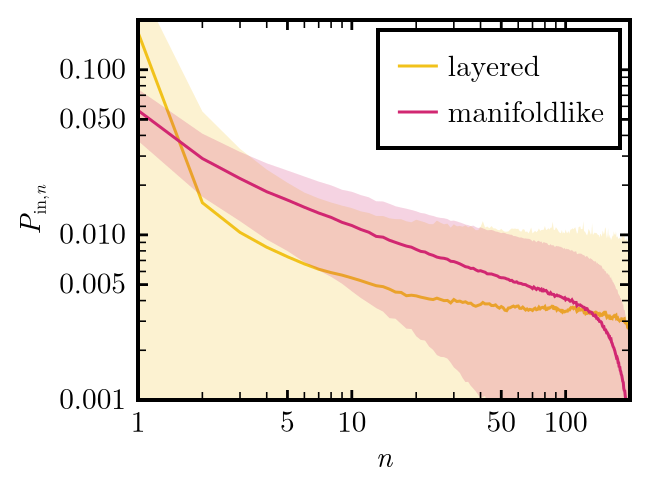

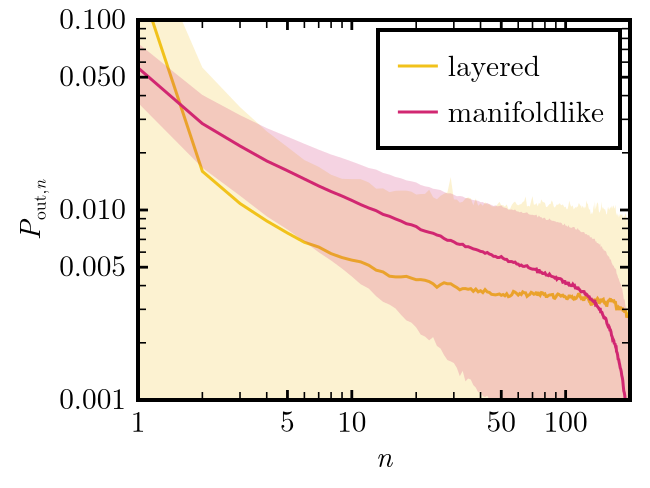

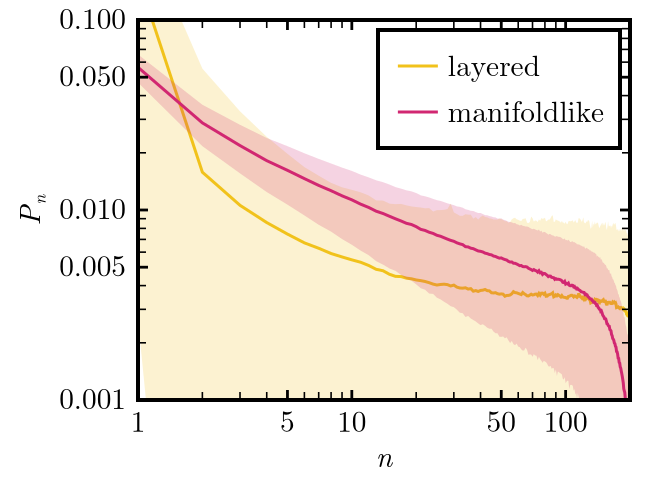

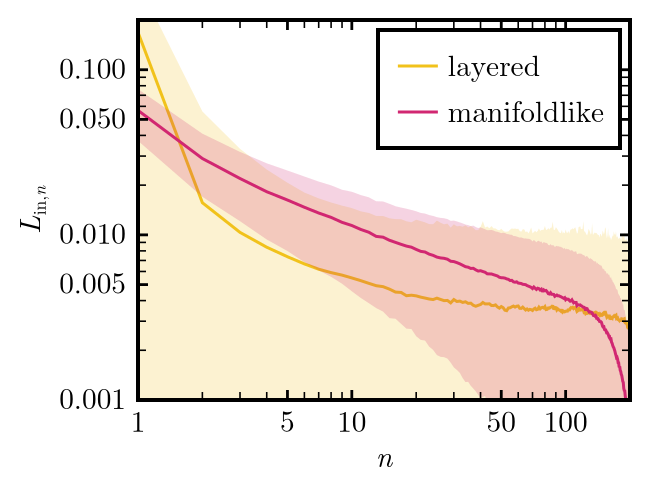

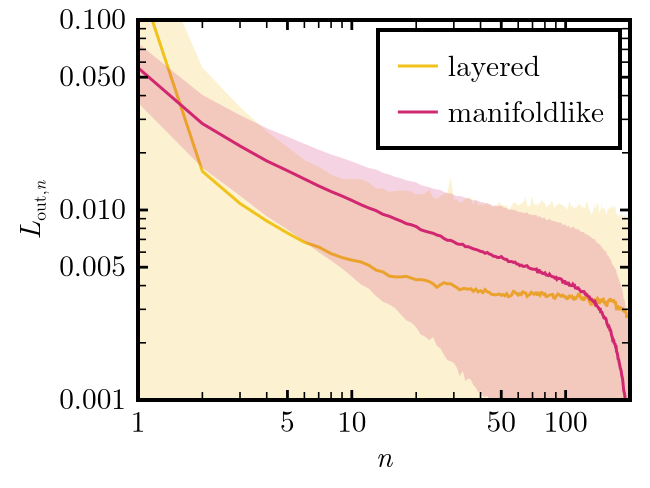

...

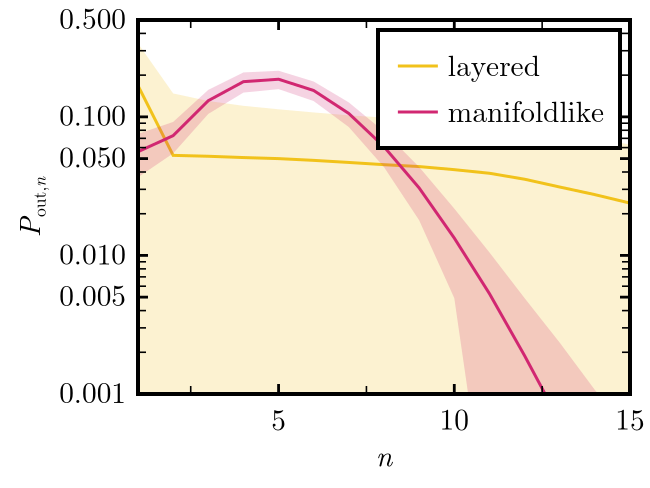

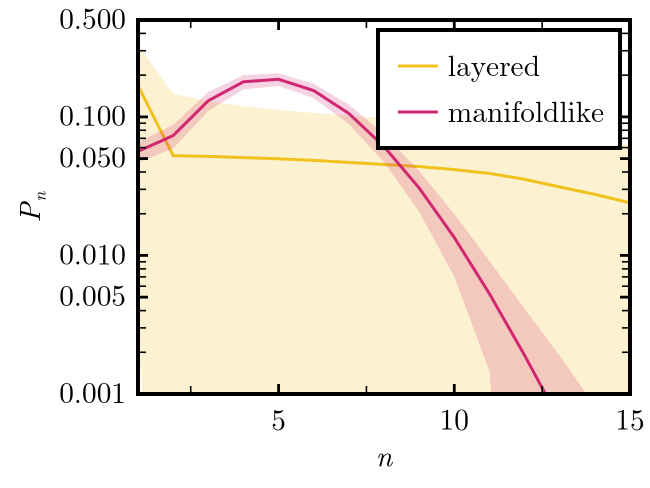

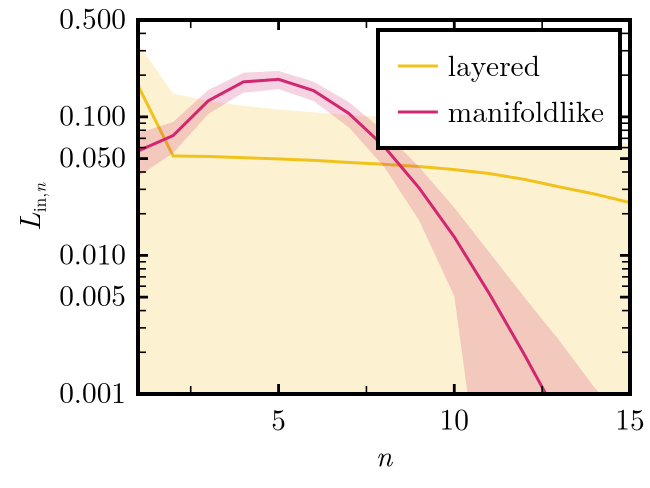

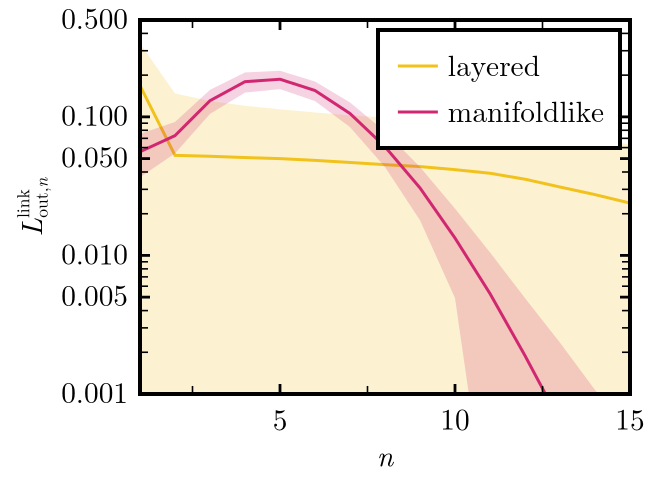

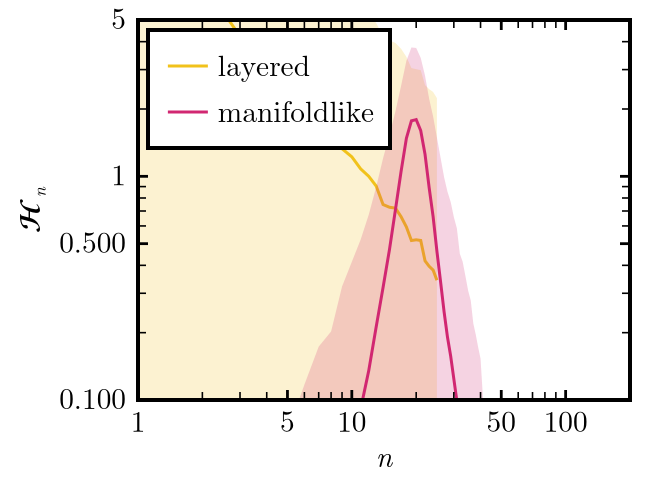

In [128]:
foreach(
    display,
    [
    plot_and_save_hists(
        normalized_in_degree_hists_layered,
        "layered_man/in_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["layered", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_out_degree_hists_layered,
        "layered_man/out_degree.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["layered", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_connectivity_hists_layered,
        "layered_man/connectivity.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["layered", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_ev_in_hists_layered,
        "layered_man/ev_in.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .2), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["layered", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_ev_out_hists_layered,
        "layered_man/ev_out.pdf";
        xlim = (1., 200.), 
        ylim = (1.e-3, .1), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{out}, n}",
        hist_labels = ["layered", "manifoldlike"], 
    ),

    plot_and_save_hists(
        normalized_in_degree_link_hists_layered,
        "layered_man/in_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{in}, n}",
        hist_labels = ["layered", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_out_degree_link_hists_layered,
        "layered_man/out_degree_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_{\mathrm{out}, n}",
        hist_labels = ["layered", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_connectivity_link_hists_layered,
        "layered_man/connectivity_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"P_n",
        hist_labels = ["layered", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_in_link_hists_layered,
        "layered_man/ev_in_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L_{\mathrm{in}, n}",
        hist_labels = ["layered", "manifoldlike"], 
        logscale_x = false,
    ),

    plot_and_save_hists(
        normalized_ev_out_link_hists_layered,
        "layered_man/ev_out_link.pdf";
        xlim = (1., 15.), 
        ylim = (1.e-3, .5), 
        xlabel = L"n", 
        ylabel = L"L^{\mathrm{link}}_{\mathrm{out},n}",
        hist_labels = ["layered", "manifoldlike"], 
        logscale_x = false,
    ),


    plot_and_save_hists(
        normalized_max_pathlen_hists_layered,
        "layered_man/max_pathlen.pdf";
        xlim = (1., 200.), 
        ylim = (.1, 5.), 
        xlabel = L"n", 
        ylabel = L"\mathcal{H}_{n}",
        hist_labels = ["layered", "manifoldlike"], 
        legendpos = :lt
    ),

    ]
)

Should be best max(max_pathlen)

# Parallel plots

In [4]:
parallel_plot_paths = gethostname() == "MacEichhorn-Wagner-F-wifi1.itp.uni-heidelberg.de" ? 
["/Users/fabianwagner/Desktop/git_projects/Causal sets/data/grid_256_10000/statistics.jld2",
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/layered_256_10000/statistics.jld2",
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/random_256_10000/statistics.jld2",
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2", 
"/Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2"] :
["/Volumes/Causal Set Silo/causal_sets/analysis/grid_2048_10000/statistics.jl",
"/Volumes/Causal Set Silo/causal_sets/analysis/layered_2048_10000/statistics.jl",
"/Volumes/Causal Set Silo/causal_sets/analysis/random_2048_10000/statistics.jl",
"/Volumes/Causal Set Silo/causal_sets/analysis/minkowski_quasicrystal_2048_10000/statistics.jld2",
"/Volumes/Causal Set Silo/causal_sets/analysis/manifoldlike_simply_connected_2048_10000/statistics.jld2"]

5-element Vector{String}:
 "/Users/fabianwagner/Desktop/git" ⋯ 26 bytes ⋯ "/grid_256_10000/statistics.jld2"
 "/Users/fabianwagner/Desktop/git" ⋯ 29 bytes ⋯ "yered_256_10000/statistics.jld2"
 "/Users/fabianwagner/Desktop/git" ⋯ 28 bytes ⋯ "andom_256_10000/statistics.jld2"
 "/Users/fabianwagner/Desktop/git" ⋯ 45 bytes ⋯ "stal_256_10000/statistics.jld2"
 "/Users/fabianwagner/Desktop/git" ⋯ 52 bytes ⋯ "cted_256_10000/statistics.jld2"

In [47]:
parallel_plot_observables = [:max_pathlen_max, (:max_pathlen_hist,15), :in_degree_median, (:in_degree_hist,1), :in_degree_median_link, (:in_degree_hist,15), (:ev_in_hist_link,5)]

7-element Vector{Any}:
 :max_pathlen_max
 (:max_pathlen_hist, 15)
 :in_degree_median
 (:in_degree_hist, 1)
 :in_degree_median_link
 (:in_degree_hist, 15)
 (:ev_in_hist_link, 5)

In [48]:
parallel_plot_data = load_fields_from_paths(
    parallel_plot_paths,
    parallel_plot_observables;
    thinning = .01
)
GC.gc()

  Loaded 100 values per field from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/grid_256_10000/statistics.jld2
  Loaded 100 values per field from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/layered_256_10000/statistics.jld2
  Loaded 100 values per field from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/random_256_10000/statistics.jld2
  Loaded 100 values per field from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/minkowski_quasicrystal_256_10000/statistics.jld2
  Loaded 100 values per field from /Users/fabianwagner/Desktop/git_projects/Causal sets/data/manifoldlike_simply_connected_256_10000/statistics.jld2


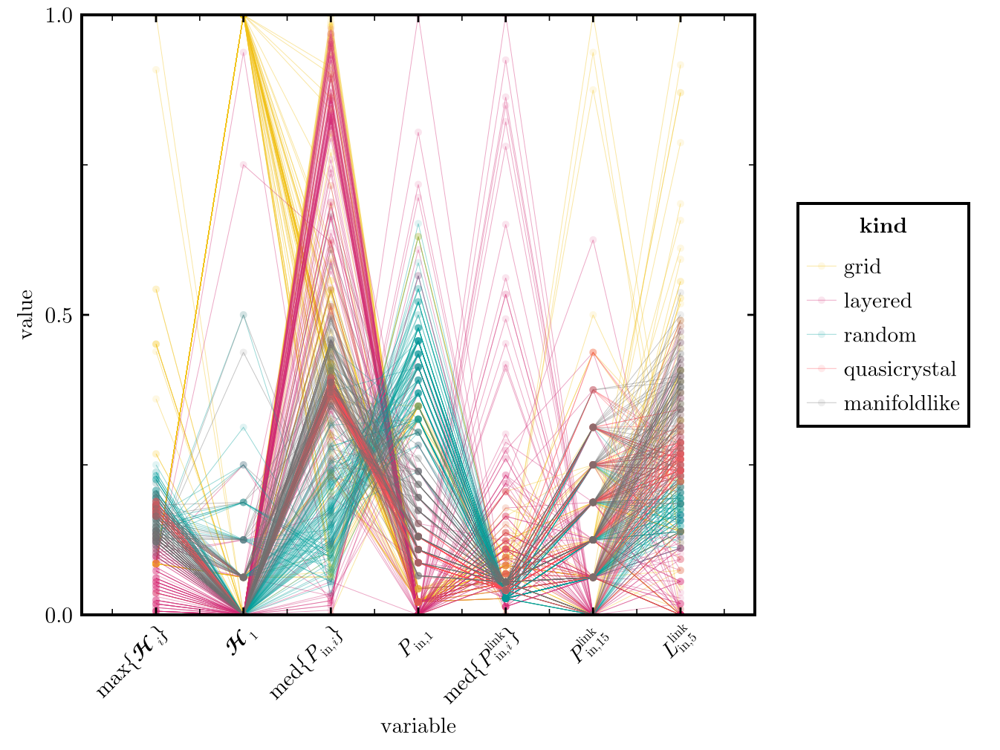

In [50]:
create_parallel_plot(
    parallel_plot_data, 
    [L"\mathrm{max}\{\mathcal{H}_i\}", L"\mathcal{H}_1", L"\mathrm{med}\{P_{\mathrm{in},i}\}", L"P_{\mathrm{in},1}", L"\mathrm{med}\{P^{\mathrm{link}}_{\mathrm{in},i}\}", L"P_{\mathrm{in},15}^{\mathrm{link}}", L"L_{\mathrm{in},5}^{\mathrm{link}}"],
    ["grid", "layered", "random", "quasicrystal","manifoldlike"],
    color_transparency = .4,
    choose_kinds = nothing)

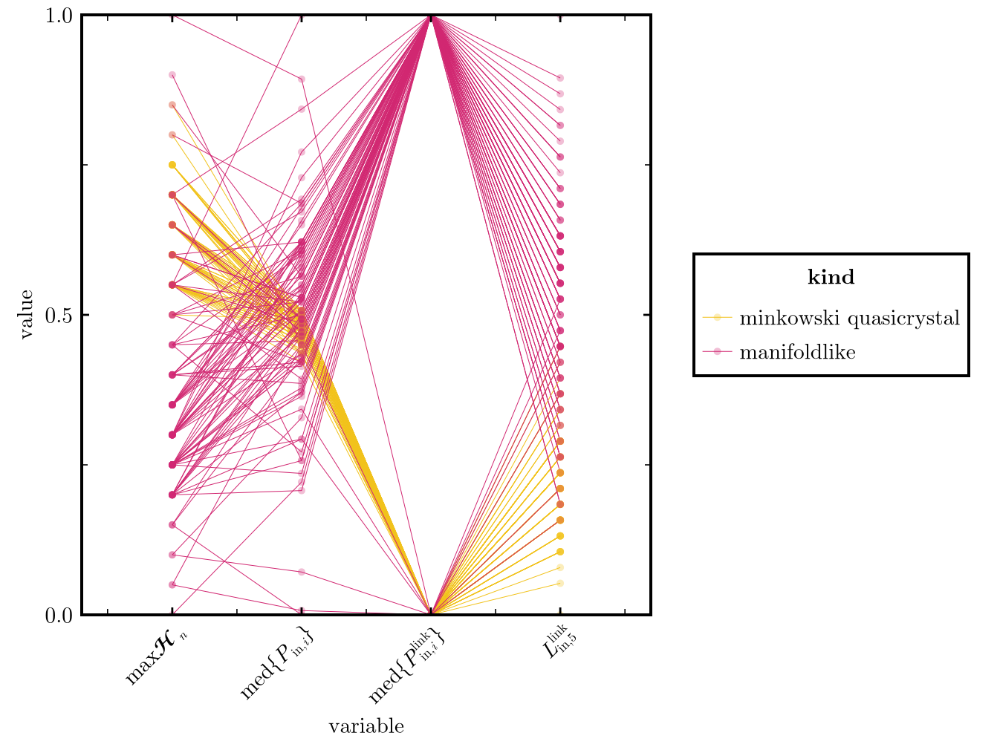

In [ ]:
create_parallel_plot(
    parallel_plot_data[4:5], 
    [L"\mathrm{max}\mathcal{H}_n", L"\mathrm{med}\{P_{\mathrm{in},i}\}", L"\mathrm{med}\{P^{\mathrm{link}}_{\mathrm{in},i}\}", L"L_{\mathrm{in},5}^{\mathrm{link}}"],
    ["minkowski quasicrystal","manifoldlike"],
    color_transparency = 1.)